In [1]:
import numpy as np
import matplotlib.pyplot as plt
from copy import deepcopy
import tkinter as tk

tau = 1
gamma = 1.8

class blob:
    def __init__(self,N,nPuits,nSources,sourcemod="1",maille="square"):
        self.sources = []
        tab_choix = [i for i in range(N)]
        #Génération des sources en faisant en sorte qu'elles ne se superposent pas entre-elles
        for i in range(nSources):
            choix = np.random.choice(tab_choix)
            self.sources.append(choix)
            tab_choix.remove(choix)
        self.non_source = tab_choix.copy()  #Tableau renvoyant l'indice des noeuds qui ne sont pas des sources
        self.puits = []
        tab_choix2 = [i for i in range(N)]
        #Génération des puits en faisant en sorte qu'ils ne se superposent pas entre-eux et avec les sources
        for i in range(nPuits):
            choix = np.random.choice(tab_choix)
            self.puits.append(choix)
            tab_choix.remove(choix)
            tab_choix2.remove(choix)
        self.non_puit = tab_choix2.copy()  #Tableau renvoyant l'indice des noeuds qui ne sont pas des puits
        self.X = int(np.sqrt(N))
        self.Y = int(np.sqrt(N))
        self.N = N
        self.noeuds = []
        self.triangles = []
        #Initialisation des noeuds
        if maille == "square":
            for n in range(N): 
                self.noeuds.append(noeud(n,self.X,self.Y))
        elif maille == "hex":
            for n in range(N):
                self.noeuds.append(hexnoeud(n,self.X,self.Y))
        elif maille == "Delaunay":
            for n in range(N):
                self.noeuds.append(Delaunoeud(n,self.X,self.Y,self))
            self.jarvis = self.jarvis_march()
            self.tri_polygon(self.jarvis)
            for knot in self.noeuds:
                knot.addtogrid(self)
            #self.plot_noeuds()
            self.delaunay()
            for triangle in self.triangles:
                for un_noeud in triangle:
                    un_noeud.add_voisins(triangle)
            for un_noeud in self.noeuds:
                un_noeud.get_D()
        elif maille == "3D":
            self.X = int(np.around(np.power(N, 1/3)))
            self.Y = int(np.around(np.power(N, 1/3)))
            self.Z = int(np.around(np.power(N, 1/3)))
            for n in range(N):
                self.noeuds.append(noeud3D(n,self.X,self.Y,self.Z))
        else:
            print("Le nom de maille est invalide")
        #Attribution des parametres des noeuds
        for un_noeud in self.noeuds:
            un_noeud.get_L(self)
        #Définition des valeurs initiales de I pour les puits et les sources
        if sourcemod == "1":
            for puit in self.puits :
                self.get_noeud(puit).I = nSources/nPuits  #Permet d'assurer la conservation du débit quand il n'y a pas le même nombre de puits et de sources
            self.Itot = -nSources
            for source in self.sources :
                self.get_noeud(source).I = -1

        if sourcemod == "random":
            Itot = 0
            for source in self.sources :
                rand = np.random.lognormal(0,1)
                self.get_noeud(source).I = -rand
                Itot -= rand
            self.Itot = Itot
            for puit in self.puits[:-1] :
                rand = abs(Itot)
                while (rand >= abs(Itot)) :        #Permet d'assurer que l'intensité d'un puit ne soit pas supérieure (en valeur absolue) à celle de toutes les sources réunies
                    rand = np.random.lognormal(0,1)
                self.get_noeud(puit).I = rand
                Itot += rand
            self.get_noeud(self.puits[-1]).I = -Itot  #Permet la conservation du débit

        if sourcemod == "choice" :
            S = 0
            P = 0
            for i,source in enumerate(self.sources) :
                self.get_noeud(source).I = int(input("Intensité de la source n°{}".format(i+1)))
                S += self.get_noeud(source).I
            self.Itot = S
            for i,puit in enumerate(self.puits[:-1]) :
                self.get_noeud(puit).I = int(input("Intensité du puit n°{}".format(i+1)))
                P += self.get_noeud(puit).I
            self.puits[-1] = -P - S       #Permet la conservation du débit

        if sourcemod == "choiceGraphique" : #Comme choice mais pour l'interface graphique
            S = 0
            P = 0
            for i,source in enumerate(self.sources) :
                self.get_noeud(source).I = -Isources[i].get()
                S += self.get_noeud(source).I
            for i,puit in enumerate(self.puits[:-1]) :
                self.get_noeud(puit).I = Ipuits[i].get()
                P += self.get_noeud(puit).I
            self.puits[-1] = -P - S

    def plot_noeuds(self):
        #Affiche les noeuds et leurs numéros: Surtout utilisée pour tester la triangulation
        fig = plt.figure()
        self.plot_jarvis()
        #self.plot_branch()
        for tri in self.triangles:
            self.plot_polygon(tri)
        for noeud in self.noeuds:
            plt.text(noeud.x,noeud.y,str(noeud.index),color='black',backgroundcolor='white',fontsize=8)
        plt.show()

    def plot_branch(self):
        #Relie les noeuds
        for noeud in self.noeuds:
            for k,j in enumerate(noeud.voisins):
                knot = self.get_noeud(j)
                plt.plot([noeud.x,knot.x],[noeud.y,knot.y],linewidth= noeud.D[k]*5,color = 'r')

    def plot_puit(self):
        #Fait apparaître les puits
        fig = plt.figure()
        for i in self.puits:
            puits = self.get_noeud(i)
            plt.scatter(puits.x,puits.y,color='g')
        plt.show()

    def plot_sources(self):
        #Fait apparaître les sources
        fig = plt.figure()
        for j in self.sources:
            sources = self.get_noeud(j)
            plt.scatter(sources.x,sources.y,color='b')
        plt.show()

    def plot(self):
        #Trace le blob
        fig = plt.figure()
        for noeud in self.noeuds:
            for k,j in enumerate(noeud.voisins):
                knot = self.get_noeud(j)
                plt.plot([noeud.x,knot.x],[noeud.y,knot.y],linewidth = (noeud.D[k])*5,color = 'r',zorder=0.5)
        for i in self.puits:
            puits = self.get_noeud(i)
            plt.scatter(puits.x,puits.y,color='g')
        for i in self.sources:
            sources = self.get_noeud(i)
            plt.scatter(sources.x,sources.y,color='b')
        if (self.sources != []):
            plt.scatter(sources.x,sources.y, color='b', label='Sources')
        if (self.puits != []):
            plt.scatter(puits.x,puits.y, color='g', label='Puits')
        if (self.sources != [] and self.puits != []):
            plt.legend(fontsize = 'small', loc = 'upper right')
        plt.show()
        
    def plot_noeud3D(self):
        #Fait apparaitres le noeuds en 3D
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        for noeud in self.noeuds:
            ax.scatter(noeud.x, noeud.y, noeud.z, marker ="h",color = 'r')
        plt.show()
        
    def plot3D(self):
        #Trace le blob en 3D
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        for noeud in self.noeuds:
            for k,j in enumerate(noeud.voisins):
                knot = self.get_noeud(j)
                ax.plot([noeud.x,knot.x],[noeud.y,knot.y],[noeud.z,knot.z],linewidth = (noeud.D[k])*5,color = "r",zorder=0.5)
        for i in self.puits:
            puits = self.get_noeud(i)
            ax.scatter(puits.x,puits.y,puits.z, color="g")
        for i in self.sources:
            sources = self.get_noeud(i)
            ax.scatter(sources.x,sources.y,sources.z,color="b")
        plt.show()
        
    def get_noeud(self,n):
        #Permet de manipuler le noeud d'indice n
        return self.noeuds[n]

    def calcule_A(self):
        #Renvoie la matrice A
        A = np.zeros((self.N,self.N))
        for i,noeud in enumerate(self.noeuds):
            aii=0
            for k,j in enumerate(noeud.voisins):
                A[i,j] = noeud.D[k]/noeud.L[k]
                aii -= noeud.D[k]/noeud.L[k]
            A[i,i] = aii
        return A

    def get_I(self):
        #Renvoie le débit total (intensité) de chaque noeud
        self.I = []
        for noeud in self.noeuds:
            self.I.append(noeud.I)
        return np.array(self.I)

    def calcule_p(self):
        #Résout l'équation matricielle AP=I et renvoie les pressions de chaque noeud
        A = self.calcule_A()
        I = self.get_I()
        P = np.linalg.lstsq(A,I,rcond=None)[0]
        for i,noeud in enumerate(self.noeuds):
            noeud.P = P[i]

    def calcule_D(self,dt,TAU= 1,GAMMA= 1.8,puits=False,sources=False):
        #Résout l'équation différentielle vérifiée par D_{ij}
        if puits:  #Permet de faire varier la position des puits
            nPuits = len(self.puits)
            for i in self.puits:
                self.get_noeud(i).I = 0
            self.puits = []
            tab_choix = self.non_source.copy()
            for i in range(nPuits):
                choix = np.random.choice(tab_choix)
                self.puits.append(choix)
                tab_choix.remove(choix)
            for i in self.puits:
                self.get_noeud(i).I = -(self.Itot)/nPuits

        if sources:  #Permet de faire varier la position des sources
            nSources = len(self.sources)
            for i in self.sources:
                self.get_noeud(i).I = 0
            self.sources = []
            tab_choix = self.non_puit.copy()
            for i in range(nSources):
                choix = np.random.choice(tab_choix)
                self.sources.append(choix)
                tab_choix.remove(choix)
            for i in self.sources:
                self.get_noeud(i).I = (self.Itot)/nSources

        self.calcule_p()
        for noeud in self.noeuds:
            for j,voisin in enumerate(noeud.voisins):
                knot = self.get_noeud(voisin)
                noeud.D[j] = noeud.D[j] + equa_diff(noeud,knot,j,TAU,GAMMA)*dt

    def jarvis_march(self):
        #Exécute l'algorithme de la Marche de Jarvis
        p0 = self.noeuds[0]
        jarvis = []
        for noeud in self.noeuds:
            if noeud.x < p0.x:
                p0 = noeud
        jarvis.append(p0)
        angle_min = -np.pi
        for p in self.noeuds:
            if p != jarvis[0]:
                if jarvis[0].angle(jarvis[0],p)>angle_min:
                    p0 = p
                    angle_min = jarvis[0].angle(jarvis[0],p)
        jarvis.append(p0)
        while(p0 != jarvis[0]):
            angle_min = -3.2
            for p in self.noeuds:
                if p != jarvis[-1]:
                    if jarvis[-1].angle(jarvis[-2],p)>angle_min:
                        p0 = p
                        angle_min = jarvis[-1].angle(jarvis[-2],p)
            jarvis.append(p0)
        return jarvis

    def plot_jarvis(self):
        #Trace l'enveloppe convexe du blob
        for i,noeud in enumerate(self.jarvis):
            knot = self.jarvis[(i+1)%len(self.jarvis)]  #Le modulo permet de faire une boucle sans avoir l'erreur "index out of bounds"
            plt.plot([noeud.x,knot.x],[noeud.y,knot.y],linewidth= 5,color = 'r')

    def plot_polygon(self,polygon):
        #Relie les sommets d'un polygone
        for i,noeud in enumerate(polygon):
            knot = polygon[(i+1)%len(polygon)]
            plt.plot([noeud.x,knot.x],[noeud.y,knot.y],linewidth= 2,color = 'b')

    def tri_polygon(self,polygon):
        #Triangule l'enveloppe convexe du blob
        for i in range(len(polygon)-2):
            if polygon[i+2] == polygon[0]:
                break
            self.triangles.append([polygon[0],polygon[i+1],polygon[i+2]])

    def delaunay(self):
        #Passe d'une triangulation quelconque à une triangulation de Delaunay
        c = 0
        i=-1
        while(i!=0):
            i=0
            for triangle in self.triangles:
                for tri in self.triangles :
                    if tri != triangle and is_quad(triangle,tri):
                        if swap(triangle,tri,self):
                            i += 1
                            c += 1
                            #self.plot_noeuds()
                            break
        #print(c)
        
def equa_diff(noeud,knot,j,tau=tau,gamma=gamma) :
    D = noeud.D[j]
    L = noeud.L[j]
    pi = noeud.P
    pj = knot.P
    Q = abs((D/L)*(pj-pi))
    return (Q**gamma)/(1+(Q**gamma)) - D/tau
    
class noeud:
    def __init__(self, n, X, Y, k=0.5):
        self.index = n
        self.x = n % X + (np.random.rand() - 0.5) * k
        self.y = (n - (n) % X) / Y + (np.random.rand() - 0.5) * k
        self.I = 0
        self.P = 0
        self.voisins = []
        self.create_voisins(n, X, Y)
        self.get_D()

    def create_voisins(self, n, X, Y):
        #Genere les indices des voisins du noeud d'indice n et les stockent dans self.voisins
        if (n - (n) % X) / Y != 0:
            self.voisins.append(n - Y)
        if n % X != 0:
            self.voisins.append(n - 1)
        if n % X != X - 1:
            self.voisins.append(n + 1)
        if (n - (n) % X) / Y != Y - 1:
            self.voisins.append(n + Y)

    def get_L(self, blob):
        #Calcule et stocke les distances entre un noeud et ses voisins
        self.L = []
        for j in self.voisins:
            autre_noeud = blob.get_noeud(j)
            self.L.append(self.dist(autre_noeud))

    def get_D(self):
        #Initialise les valeurs de D entre un noeud et ses voisins
        self.D = []
        for j in self.voisins:
            self.D.append(1.0)

    def dist(self,autre_noeud):
        #Renvoie la distance entre 1 point de l'espace et le noeud
        x1 = self.x
        y1 = self.y
        x2 = autre_noeud.x
        y2 = autre_noeud.y
        return np.sqrt((x1 - x2)**2 + (y1 - y2)**2)

class hexnoeud(noeud):
    def __init__(self,n,X,Y,k=0.5):
        self.index = n
        self.x = n%X + (((n - (n)%X)/Y)%2)*0.5 + (np.random.rand() - 0.5)*k
        self.y = ((n - (n)%X)/Y)*(np.sqrt(3)/2) + (np.random.rand() - 0.5)*k
        self.I = 0
        self.P = 0
        self.voisins = []
        self.create_voisins(n,X,Y)
        self.get_D()

    def create_voisins(self,n,X,Y):
        #Genere les indices des voisins du noeud d'indice n et les stockent dans self.voisins
        offset = 0
        parity = True
        if ((n - (n)%X)/Y)%2 == 1:
            offset = 1
            parity = False
        if (n - (n)%X)/Y != 0:
            if n%X != 0 or not parity:
                self.voisins.append(n - Y -1 + offset)
            if n%X != X-1 or parity:
                self.voisins.append(n - Y + offset)
        if n%X != 0:
            self.voisins.append(n-1)
        if n%X != X-1:
            self.voisins.append(n+1)
        if (n - (n)%X)/Y != Y-1:
            if n%X != 0 or not parity:
                self.voisins.append(n + Y -1 + offset)
            if n%X != X-1 or parity:
                self.voisins.append(n + Y + offset)
        
class Delaunoeud(noeud):
    def __init__(self,n,X,Y,blob):
        self.index = n
        self.x = np.random.rand()*X
        self.y = np.random.rand()*Y
        self.I = 0
        self.P = 0
        self.voisins = []
        #self.addtogrid(n,blob)

    def add_voisins(self,triangle):
        #Ajoute les points du triangle à la liste des voisins d'un noeud
        for noeud in triangle:
            if noeud != self and (noeud.index not in self.voisins):
                self.voisins.append(noeud.index)

    def angle(self,noeud,knot):
        #Calcule l'angle Noeud-Self-Knot
        if noeud == self :    #Permet de calculer l'angle entre le vecteur Self-Knot et la verticale : voir jarvis_march
            noeud = deepcopy(self)
            noeud.y = 0
        return np.angle((knot.x - self.x + (knot.y - self.y)*1j)/(noeud.x - self.x + (noeud.y - self.y)*1j))

    def addtogrid(self,blob):
        #Ajoute le point a la triangulation en reliant le noeud au trois sommet du trinagle le contenant
        if not (self in blob.jarvis):
            for triangle in blob.triangles:
                if in_triangle(triangle,self):
                    blob.triangles.remove(triangle)
                    for i in range(3):
                        blob.triangles.append([self,triangle[i%3],triangle[(i+1)%3]])
                    return

def in_triangle(tri,noeud):
    #Teste si un point est dans un triangle
    for i in range(3):
        if tri[i].angle(tri[(i+1)%3],noeud) >0:
            return False
    return True

def is_quad(tri1,tri2):
    #Teste si deux triangles ont 2 sommets en commun et forment un quadrilatère
    c = 0
    for i in tri1:
        if i in tri2:
            c += 1
    return c > 1

def swap(tri1,tri2,blob):
    #Teste si la somme des angles opposé est supérieure à 180° et effectue le basculement de l'arrete si c'est le cas
    edge = []
    for i in tri1:
        if i in tri2:
            edge.append(i)
        else:
            j = tri1.index(i)
    for i in tri2:
        if i not in edge:
            k = tri2.index(i)
        #On teste la condition de Delaunay
    if tri1[j].angle(tri1[(j-1)%3],tri1[(j+1)%3]) + tri2[k].angle(tri2[(k-1)%3],tri2[(k+1)%3]) > np.pi:
        blob.triangles.remove(tri1)
        blob.triangles.remove(tri2)
        blob.triangles.append([tri1[j],tri1[(j+1)%3],tri2[k]])
        blob.triangles.append([tri2[k],tri2[(k+1)%3],tri1[j]])
        return True
    return False
    
class noeud3D(noeud):
    def __init__(self, n, X, Y, Z, k=0.25):
        self.index = n
        self.x = n % X + (np.random.rand() - 0.5) * k
        self.y = (n % (X*Y)) // X + (np.random.rand() - 0.5) * k
        self.z = n//(X*Y) + (np.random.rand() - 0.5) * k
        self.I = 0
        self.P = 0
        self.voisins = []
        self.create_voisins(n, X, Y, Z)
        self.get_D()
    def create_voisins(self, n, X, Y, Z):
        #Genere les indices des voisins du noeud d'indice n et les stockent dans self.voisins
        if ((n + 1)%X != 0): #A droite
            self.voisins.append(n + 1)
        if (n % X != 0): #A gauche
            self.voisins.append(n - 1)
        if ((X*Y - n%(X*Y)) > Y): #Devant
            self.voisins.append(n + Y)
        if (X*Y - n%(X*Y) < (X-1)*Y) : #Derriere
            self.voisins.append(n - Y)
        if (n >= X*Y):         #En dessous
            self.voisins.append(n - X*Y)
        if (n < X*Y*Z - X*Y):  #Au dessus
            self.voisins.append(n + X*Y)
        for i in self.voisins:
            if i >= X*Y*Z or i < 0:
                print("Erreur avec", n, "un voisin vaut", i)
            
    def dist(self,autre_noeud):
        x1 = self.x
        y1 = self.y
        z1 = self.z
        x2 = autre_noeud.x
        y2 = autre_noeud.y
        z2 = autre_noeud.z
        return np.sqrt((x1 - x2)**2 + (y1 - y2)**2 + (z1 - z2)**2)

# DISCLAIMER : Les figures ci-dessous sont présentées dans l'ordre d'apparition du PDF. Seules des images plus où moins intermédiaires sont affichées en plus de celles du rapport. Le code de l'interface graphique (ne pouvant être exécuté sur un .ipynb) se situe tout en bas de la page néanmoins.

Le temps de la figure ci-dessous est à t = 0


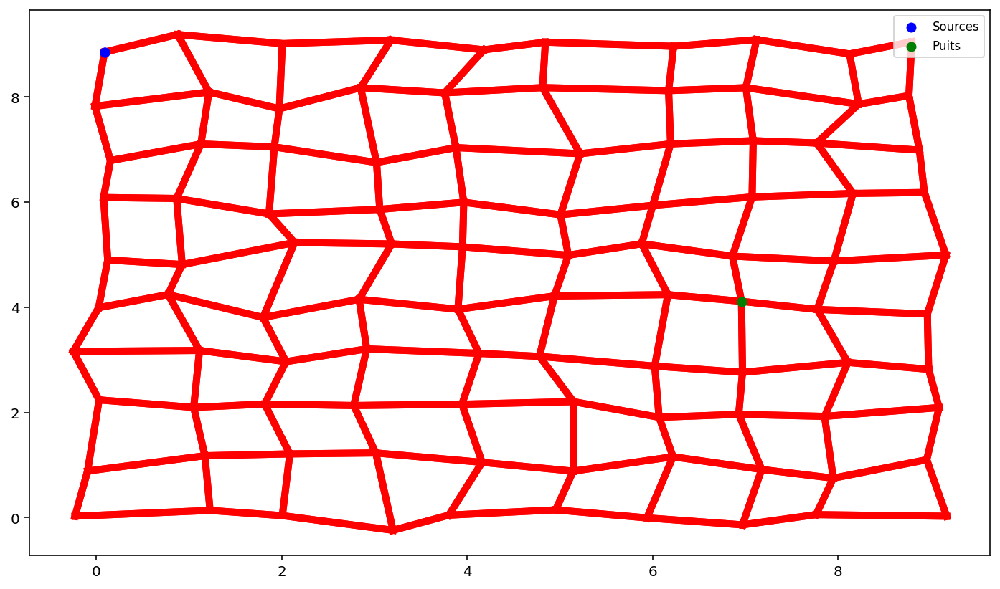

Le temps de la figure ci-dessous est à t = 100


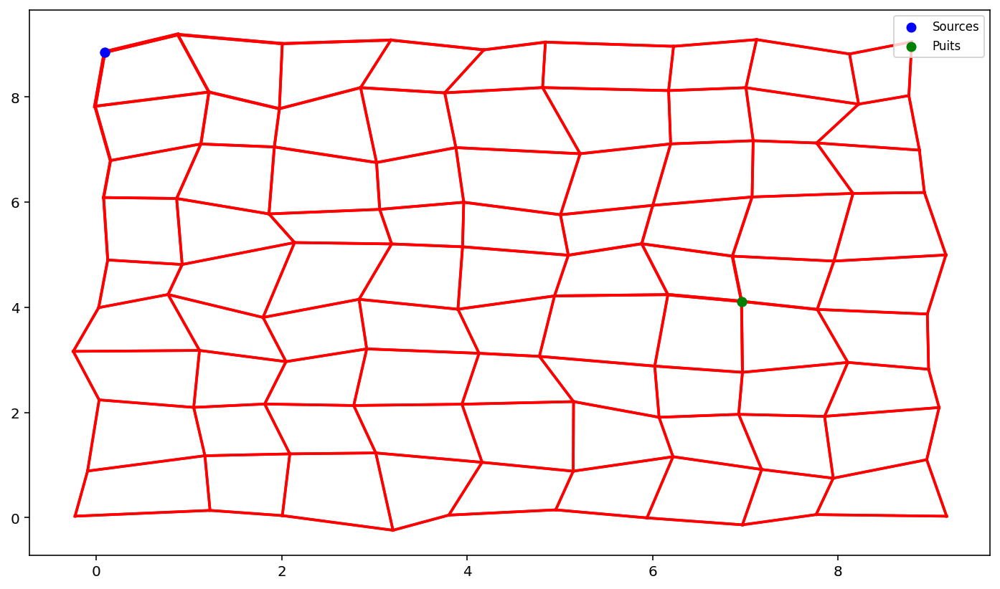

Le temps de la figure ci-dessous est à t = 200


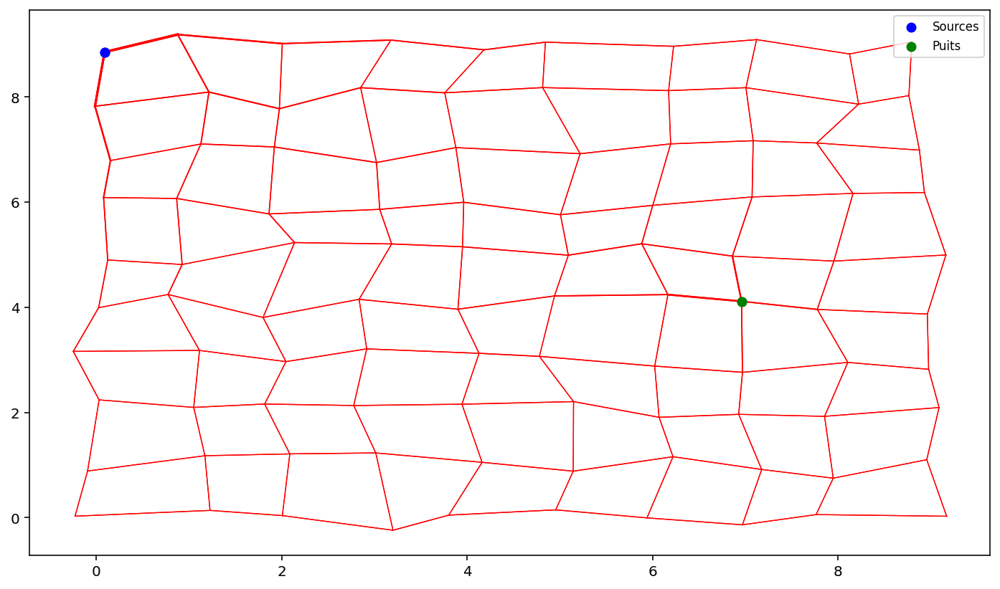

Le temps de la figure ci-dessous est à t = 300


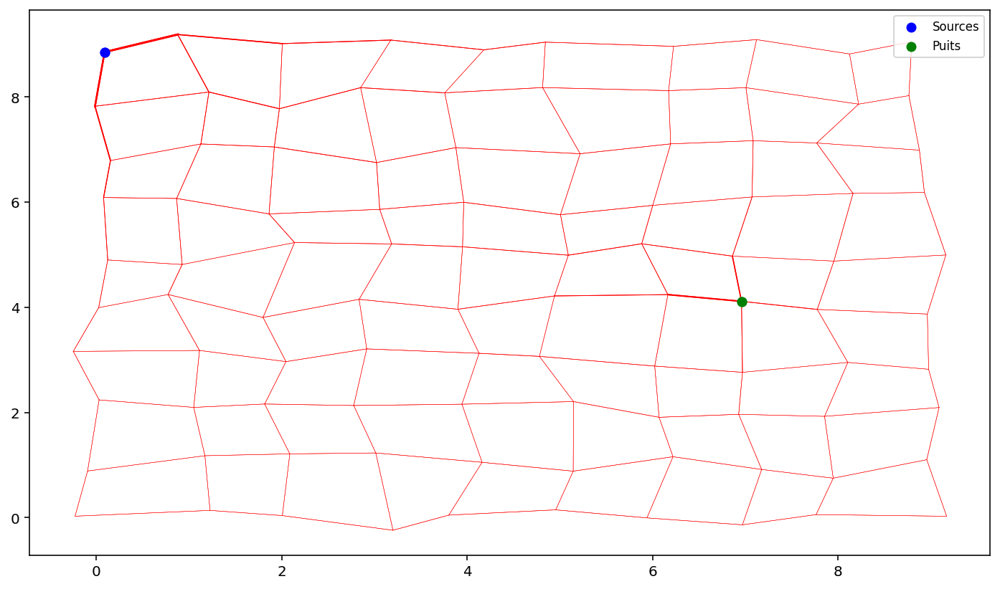

Le temps de la figure ci-dessous est à t = 400


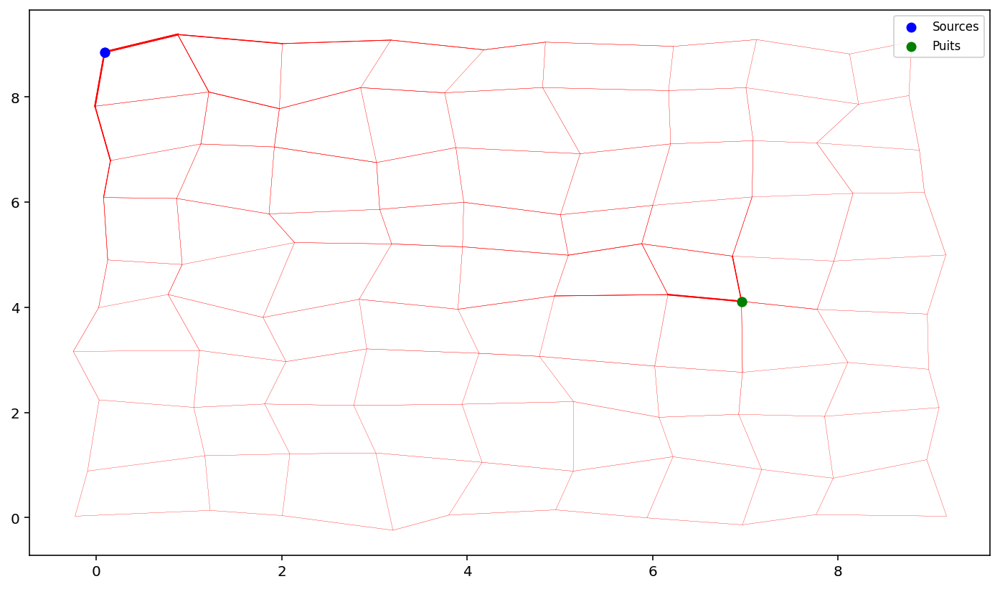

Le temps de la figure ci-dessous est à t = 500


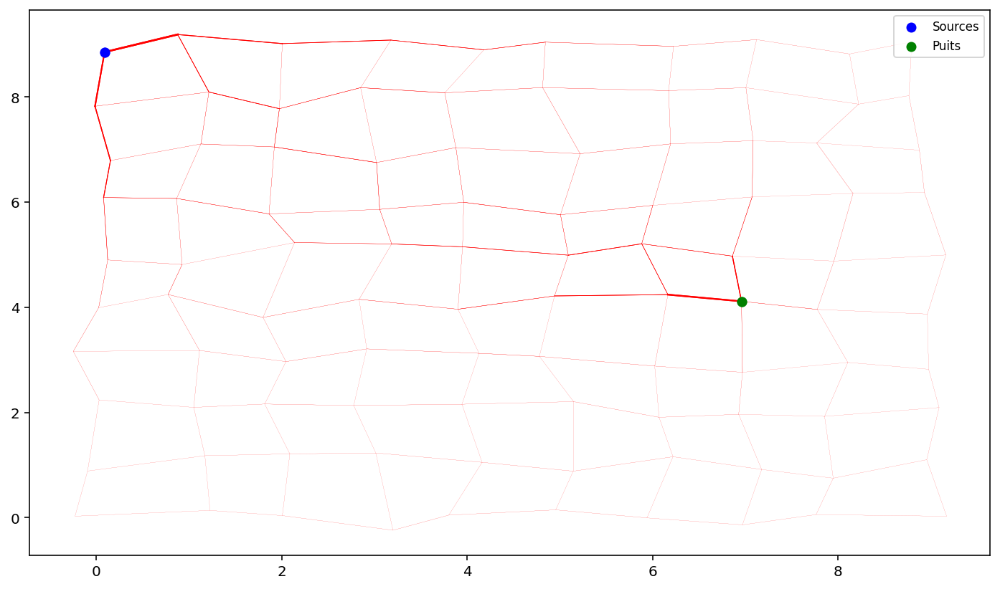

Le temps de la figure ci-dessous est à t = 600


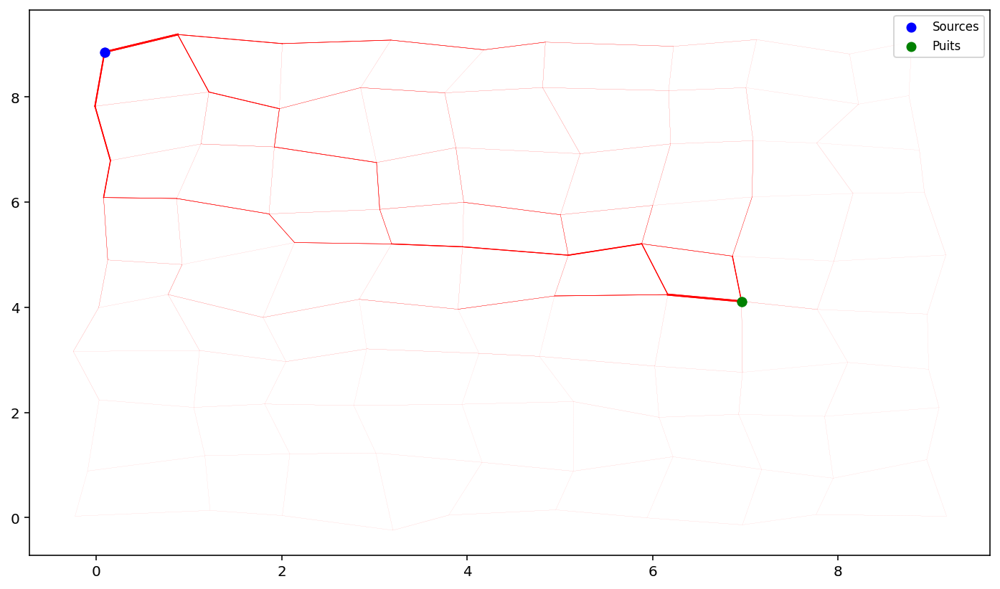

Le temps de la figure ci-dessous est à t = 700


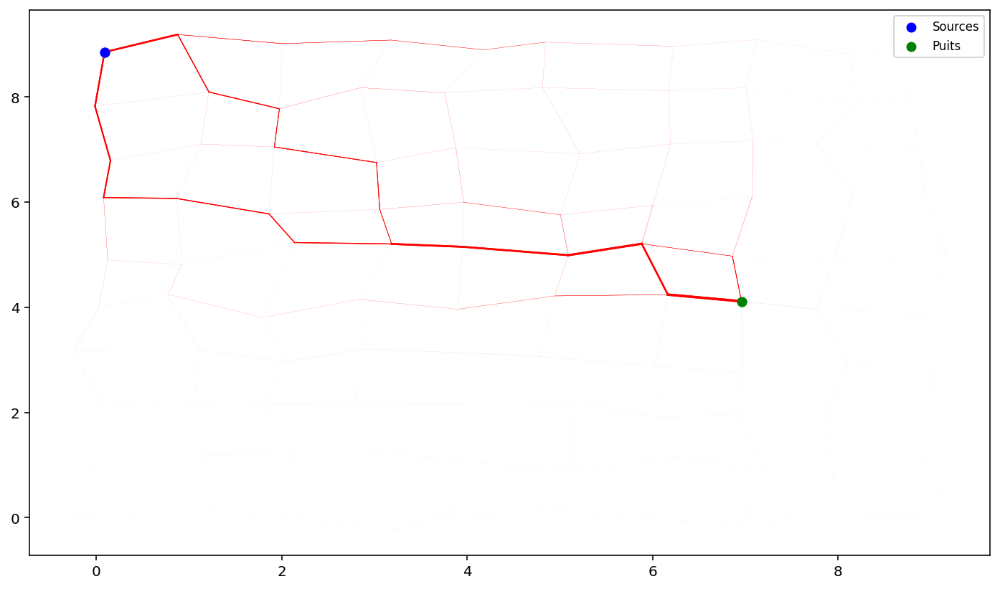

Le temps de la figure ci-dessous est à t = 800


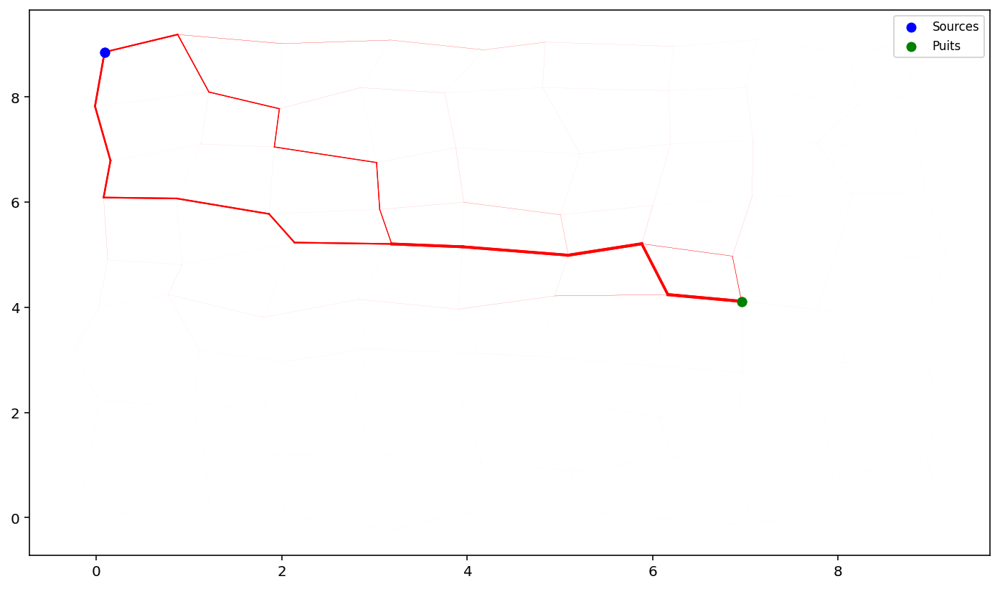

Le temps de la figure ci-dessous est à t = 900


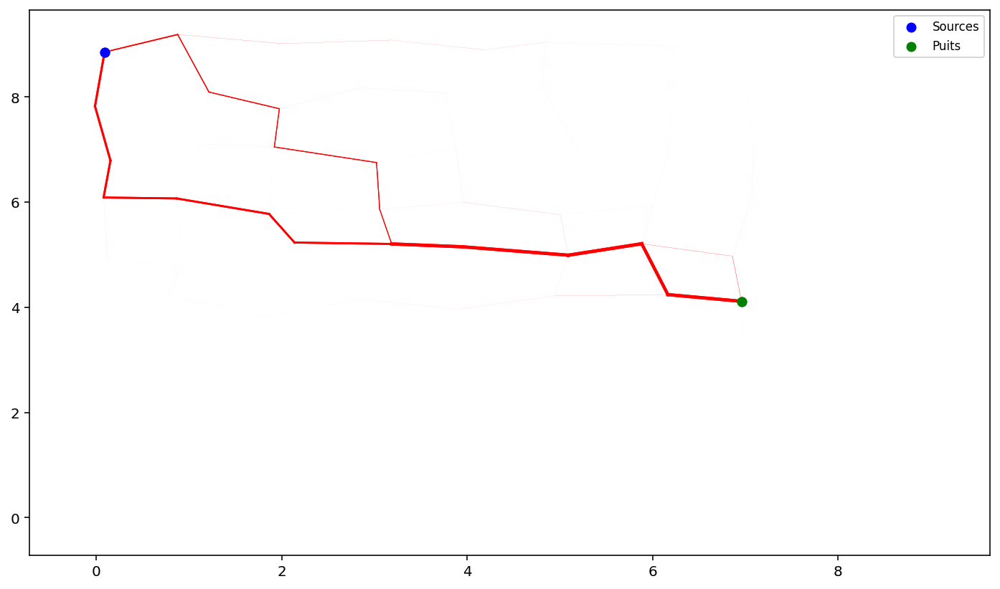

Le temps de la figure ci-dessous est à t = 1000


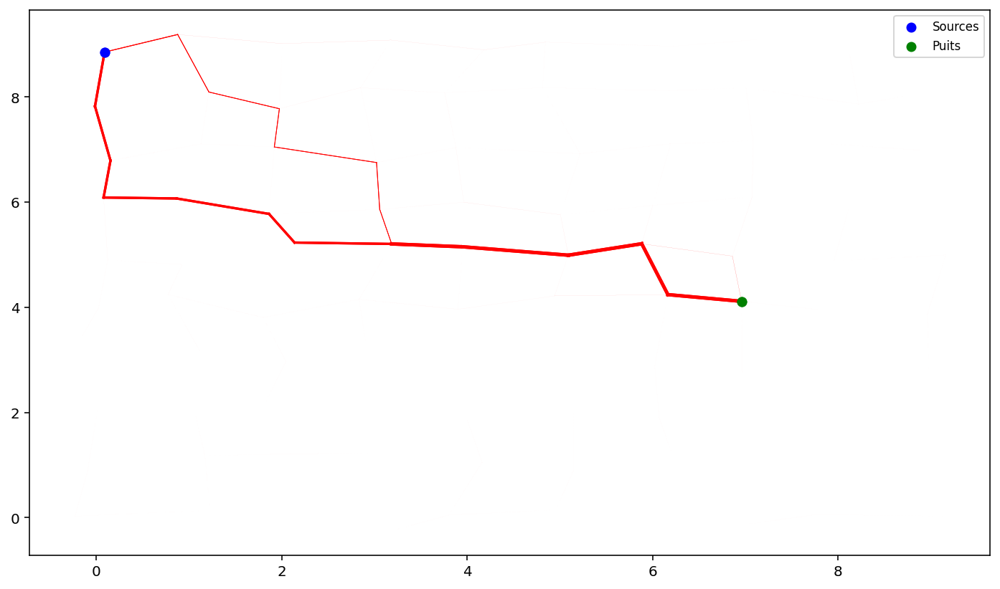

In [2]:
test_blob = blob(100,1,1)
for t in range(1001):
    test_blob.calcule_D(0.01, TAU = 1, GAMMA = 1.8)
    if t%100 == 0:
        print("Le temps de la figure ci-dessous est à t =", t)
        test_blob.plot()

Le temps de la figure ci-dessous est à t = 1000


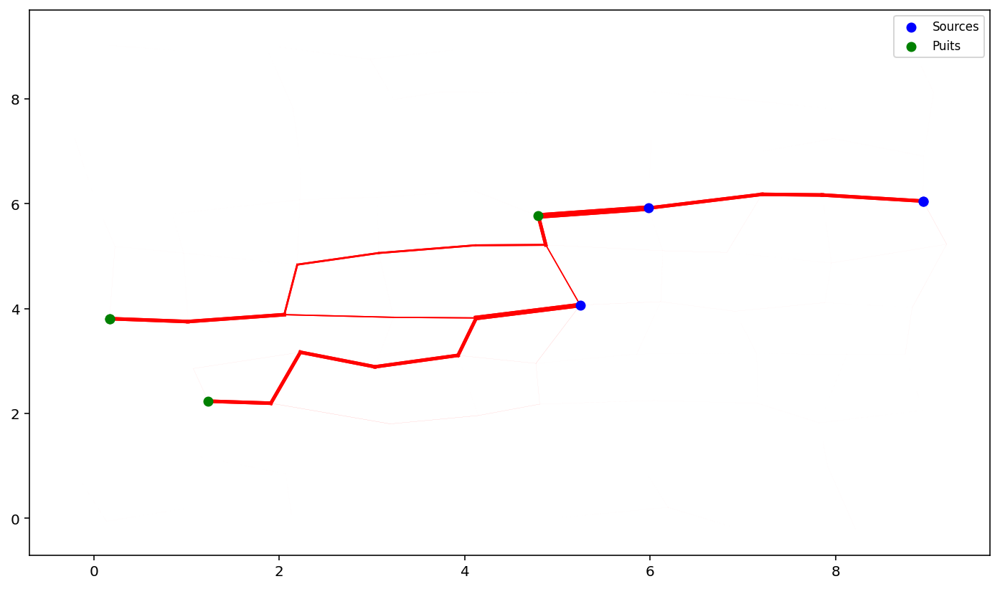

Le temps de la figure ci-dessous est à t = 1000


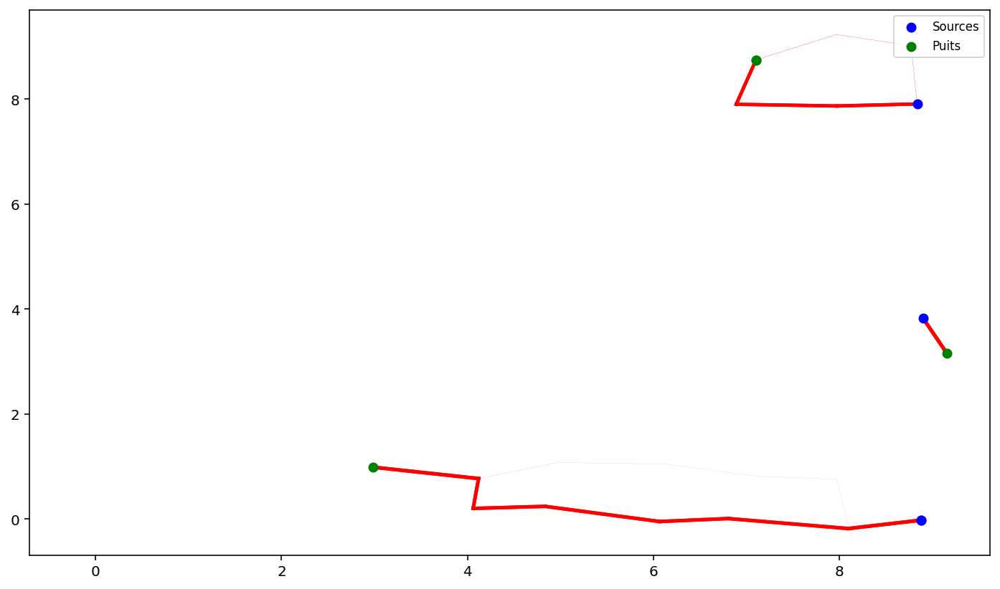

Le temps de la figure ci-dessous est à t = 1000


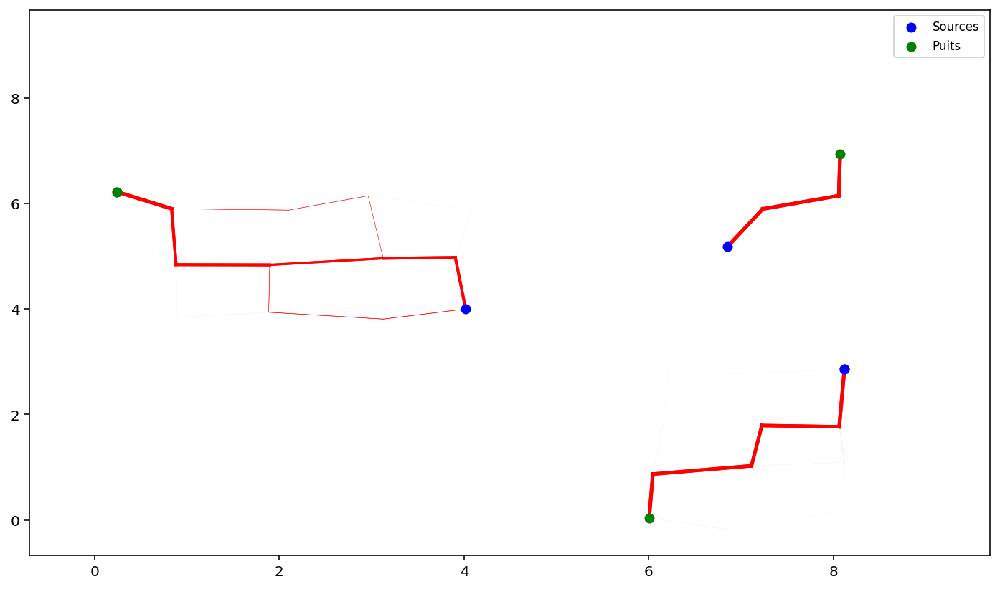

In [3]:
for i in range(3):
    test_blob = blob(100,3,3)
    for t in range(1001):
        test_blob.calcule_D(0.01, TAU = 1, GAMMA = 1.8)
    print("Le temps de la figure ci-dessous est à t =", t)
    test_blob.plot()

Le temps de la figure ci-dessous est à t = 1000 et Tau vaut 0.1


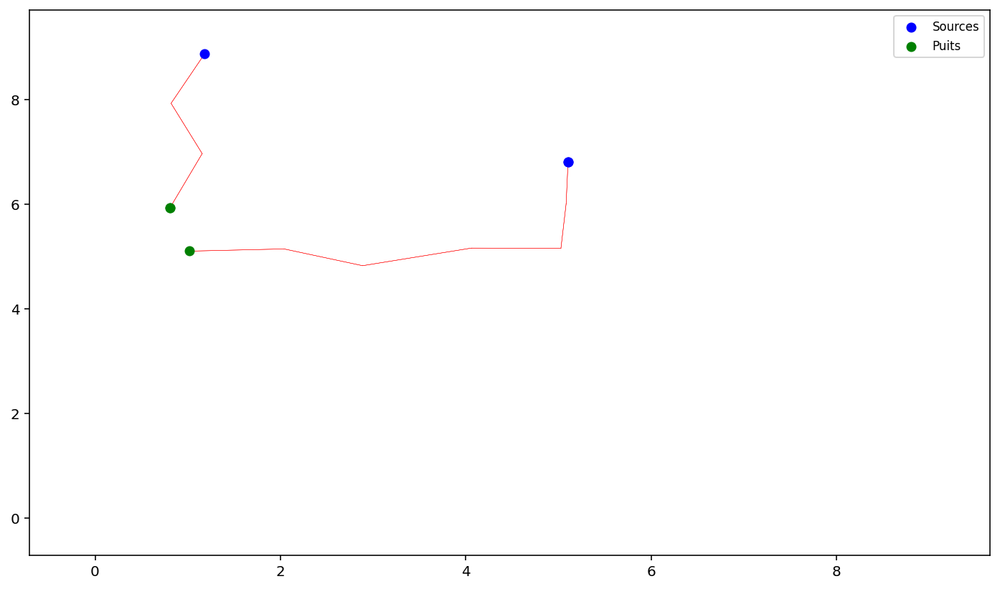

Le temps de la figure ci-dessous est à t = 1000 et Tau vaut 10


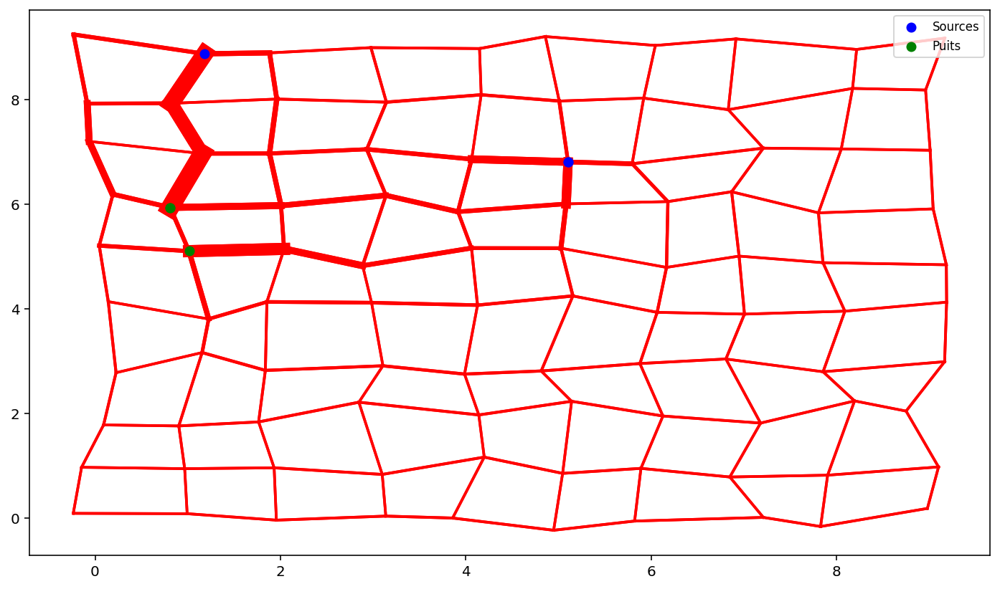

Le temps de la figure ci-dessous est à t = 1000 et Tau vaut 100


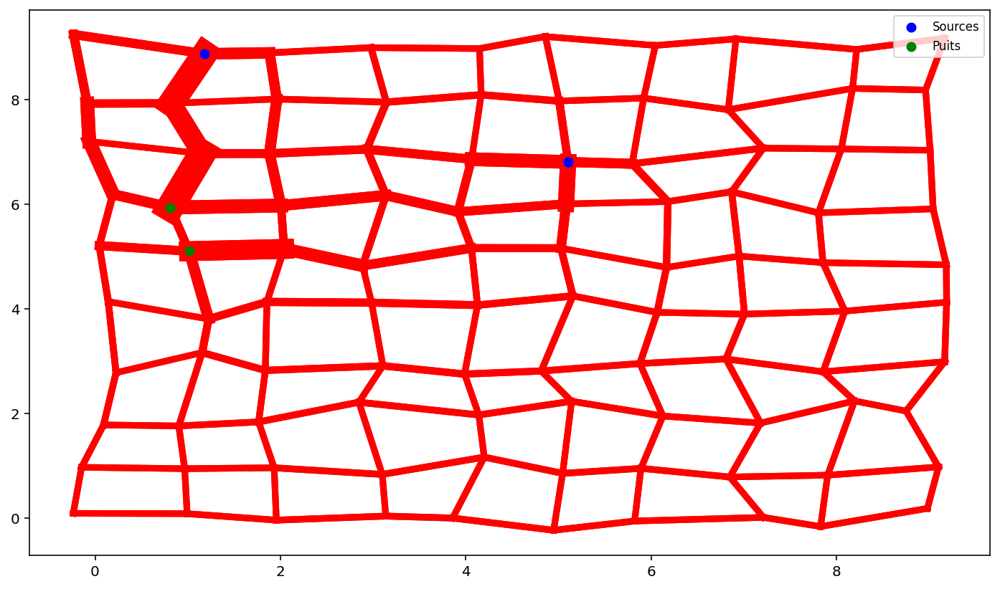

In [4]:
test_blob = blob(100,2,2)
tabtau = [0.1,10,100]
for i in tabtau:
    actuel = deepcopy(test_blob)
    for t in range(1001):
        actuel.calcule_D(0.01, TAU = i)
    print("Le temps de la figure ci-dessous est à t =", t, "et Tau vaut", i)
    actuel.plot()

Le temps de la figure ci-dessous est à t = 1000 et Gamma vaut -1.8


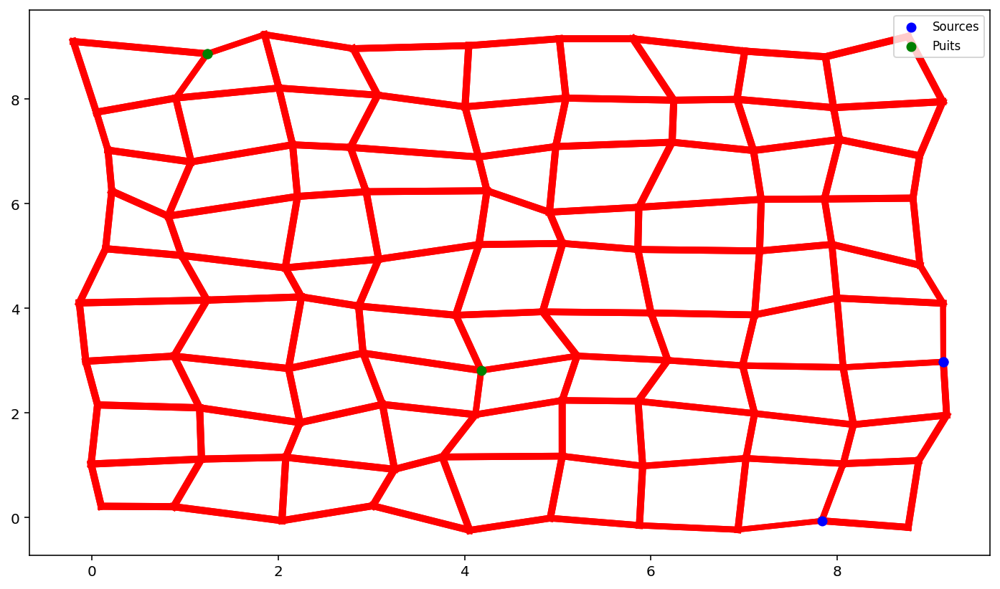

Le temps de la figure ci-dessous est à t = 1000 et Gamma vaut 0.5


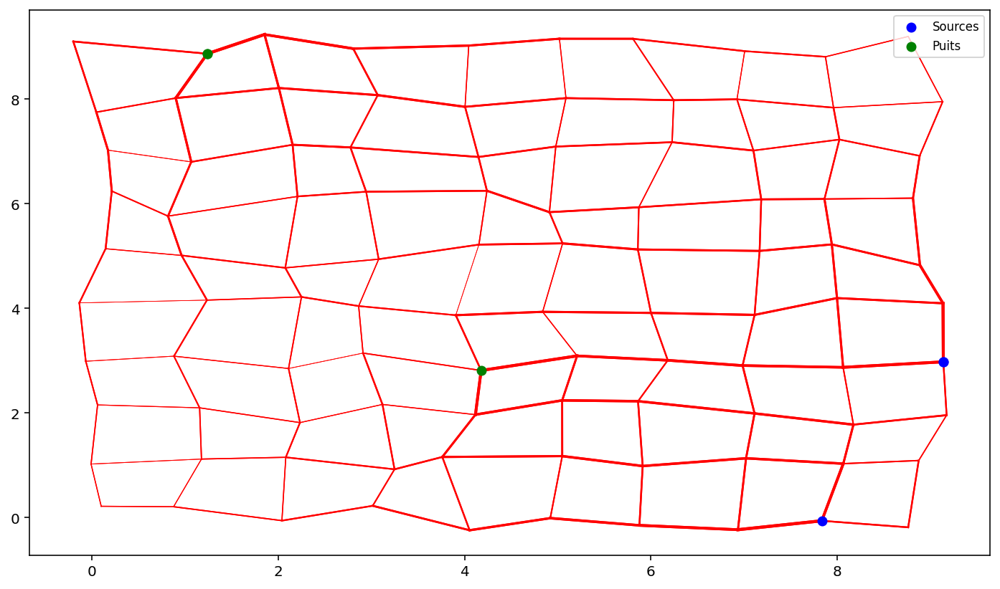

Le temps de la figure ci-dessous est à t = 1000 et Gamma vaut 5


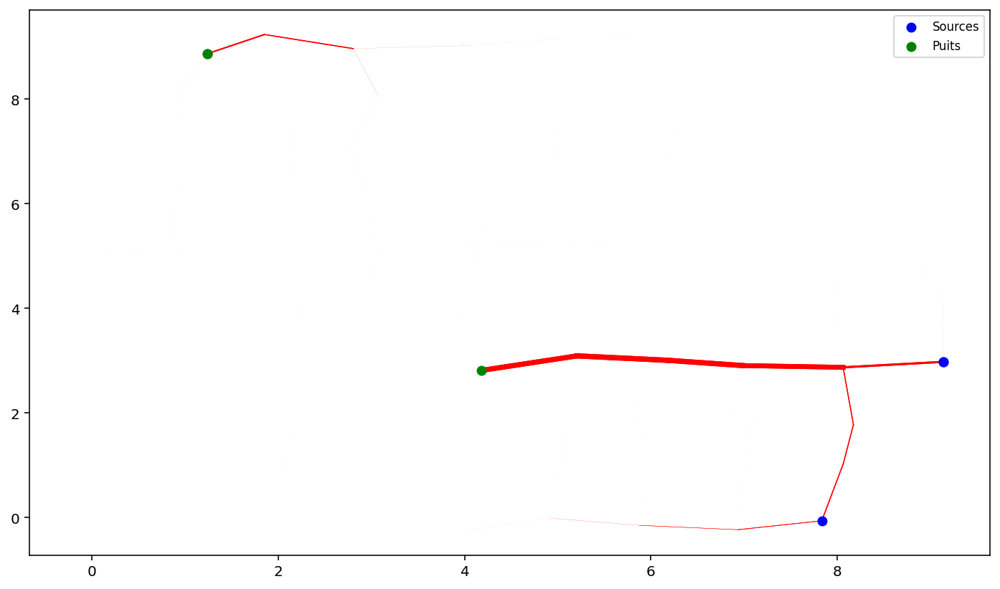

In [5]:
test_blob = blob(100,2,2)
tabgamma = [-1.8,0.5,5]
for i in tabgamma:
    actuel = deepcopy(test_blob)
    for t in range(1001):
        actuel.calcule_D(0.01, TAU = 1, GAMMA = i)
    print("Le temps de la figure ci-dessous est à t =", t, "et Gamma vaut", i)
    actuel.plot()

Intensité de la source n°1 -1

Intensité de la source n°2 -1

Intensité du puit n°1 1

Le temps de la figure ci-dessous est à t = 700 et l'intensité des puits et sources vaut 1 en valeur absolue


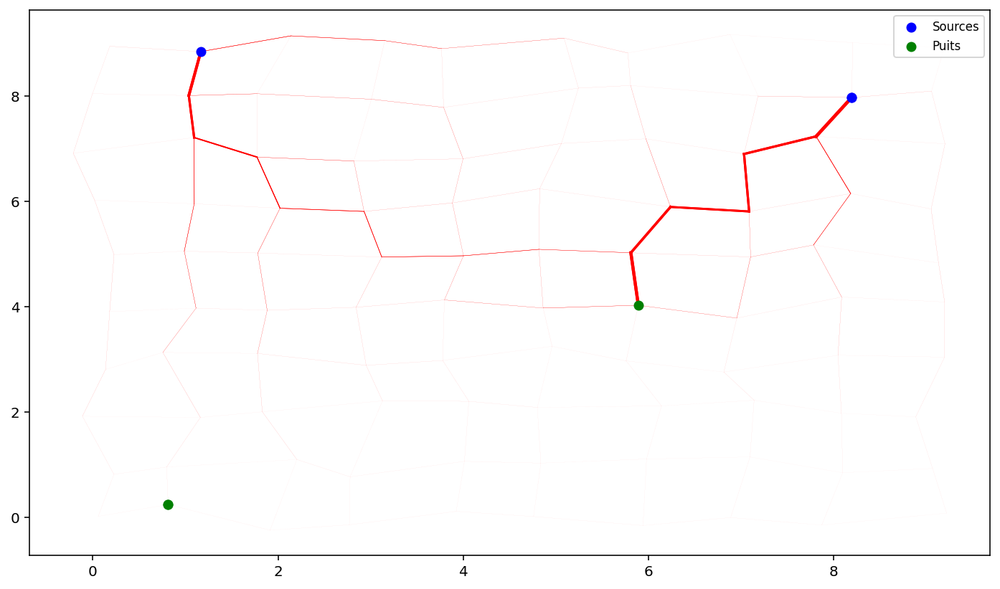

Intensité de la source n°1 -10

Intensité de la source n°2 -10

Intensité du puit n°1 10

Le temps de la figure ci-dessous est à t = 700 et l'intensité des puits et sources vaut 10 en valeur absolue


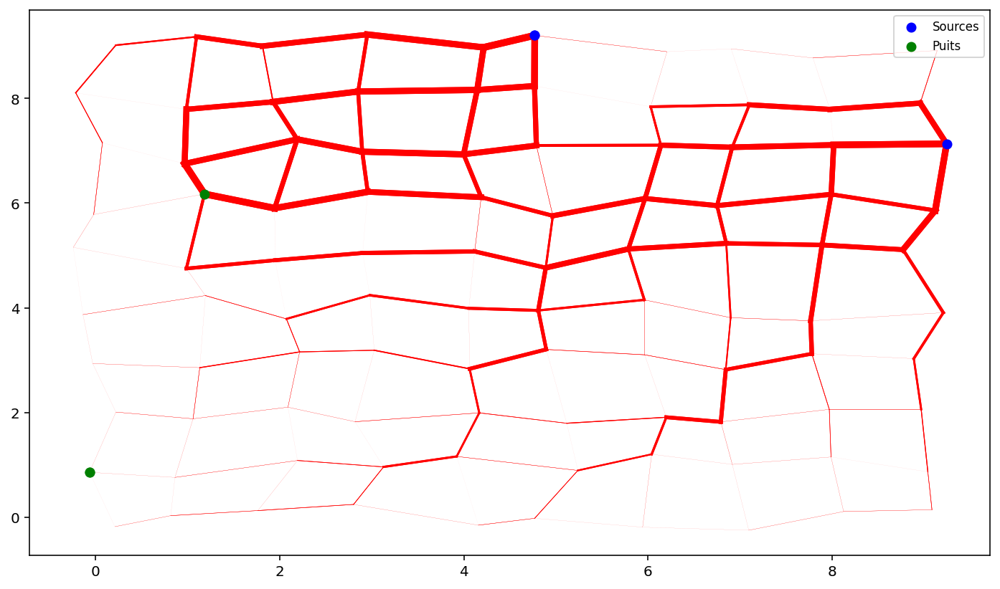

Intensité de la source n°1 -50

Intensité de la source n°2 -50

Intensité du puit n°1 50

Le temps de la figure ci-dessous est à t = 700 et l'intensité des puits et sources vaut 50 en valeur absolue


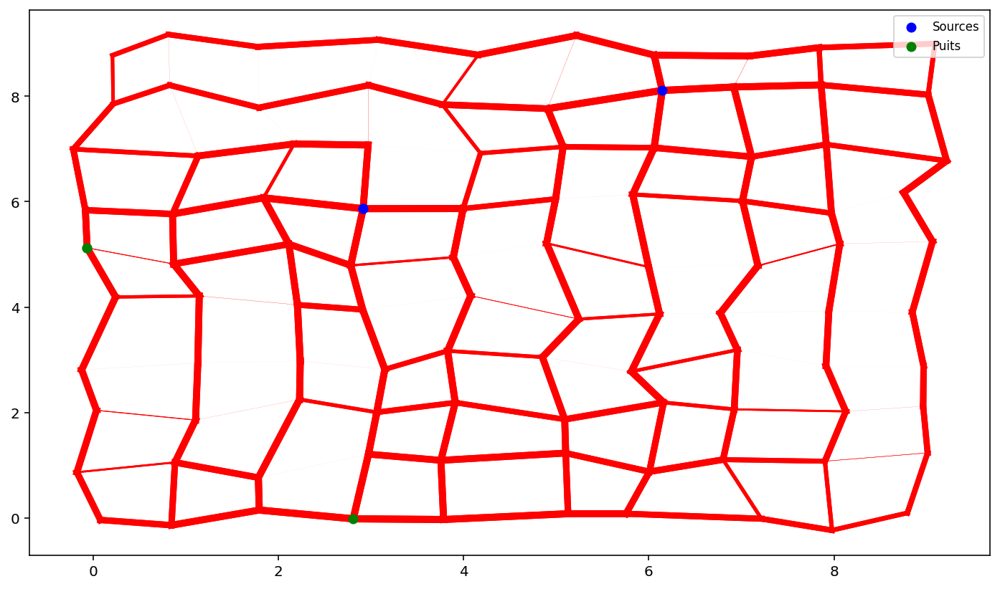

In [6]:
tab_intensite = [1, 10, 50]
for i in range(3):
    test_blob = blob(100,2,2, sourcemod = 'choice')
    for t in range(701):
        test_blob.calcule_D(0.01, TAU = 1, GAMMA = 1.8)
    print("Le temps de la figure ci-dessous est à t =", t, "et l'intensité des puits et sources vaut", tab_intensite[i] , "en valeur absolue")
    test_blob.plot()

Le temps de la figure ci-dessous est à t = 0


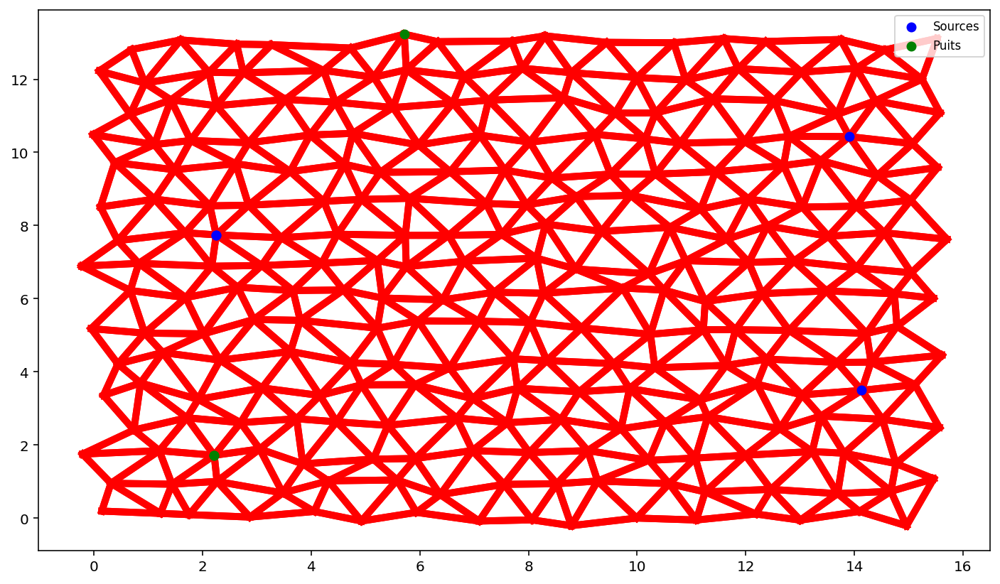

Le temps de la figure ci-dessous est à t = 100


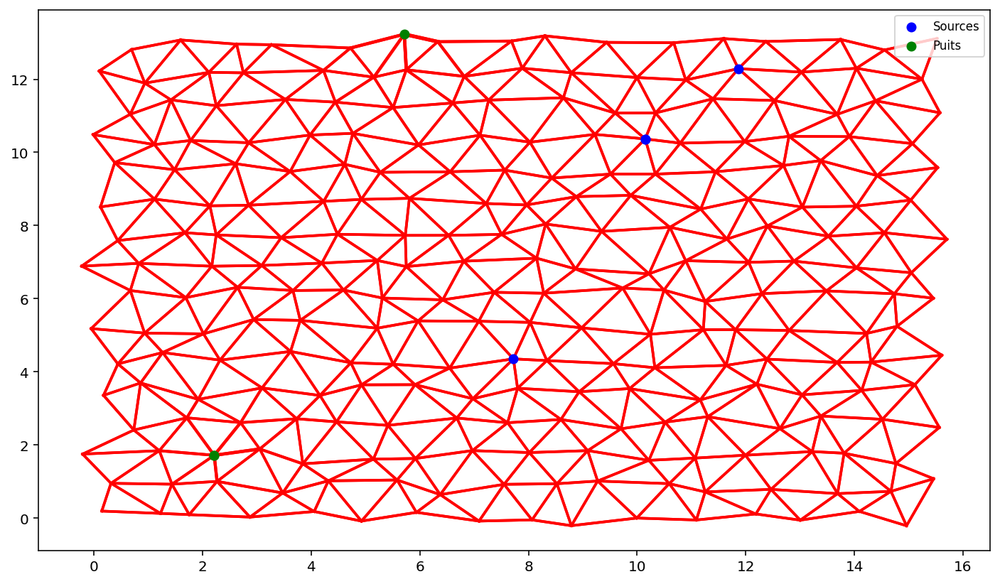

Le temps de la figure ci-dessous est à t = 200


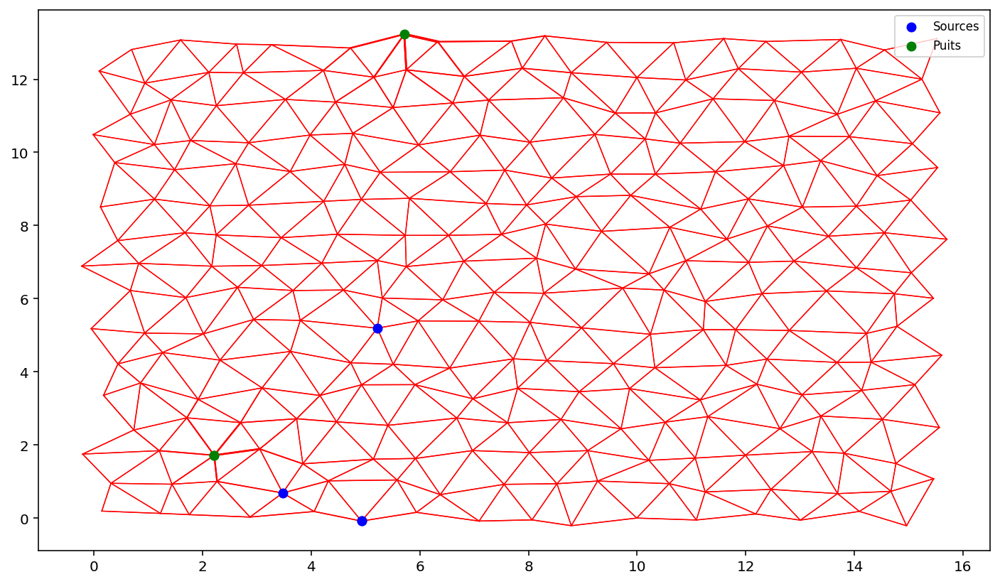

Le temps de la figure ci-dessous est à t = 300


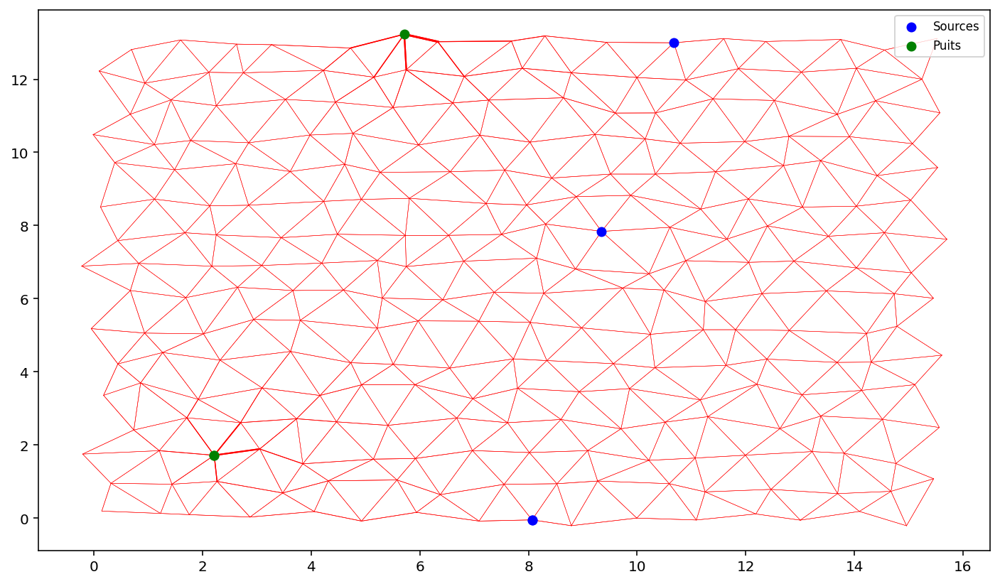

Le temps de la figure ci-dessous est à t = 400


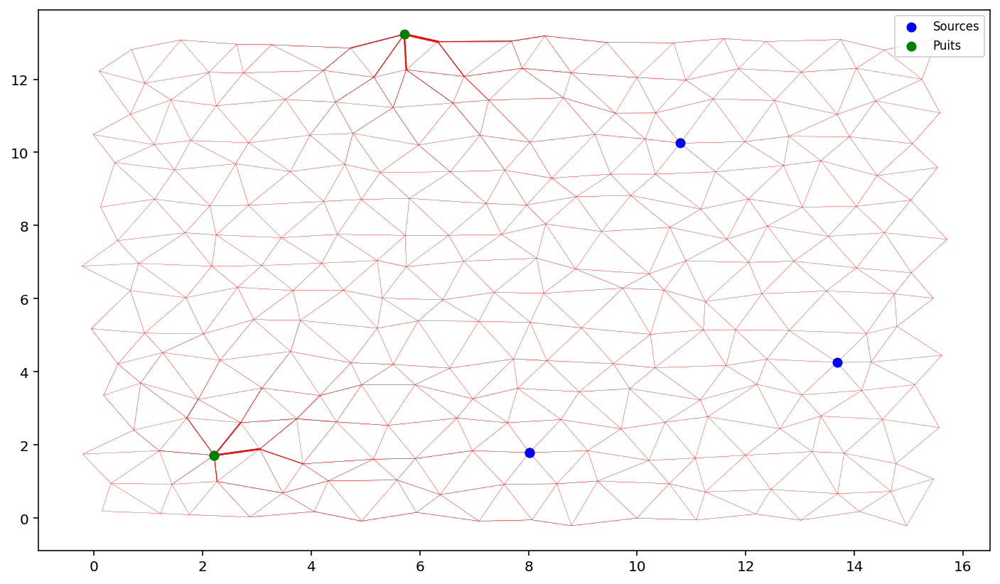

Le temps de la figure ci-dessous est à t = 500


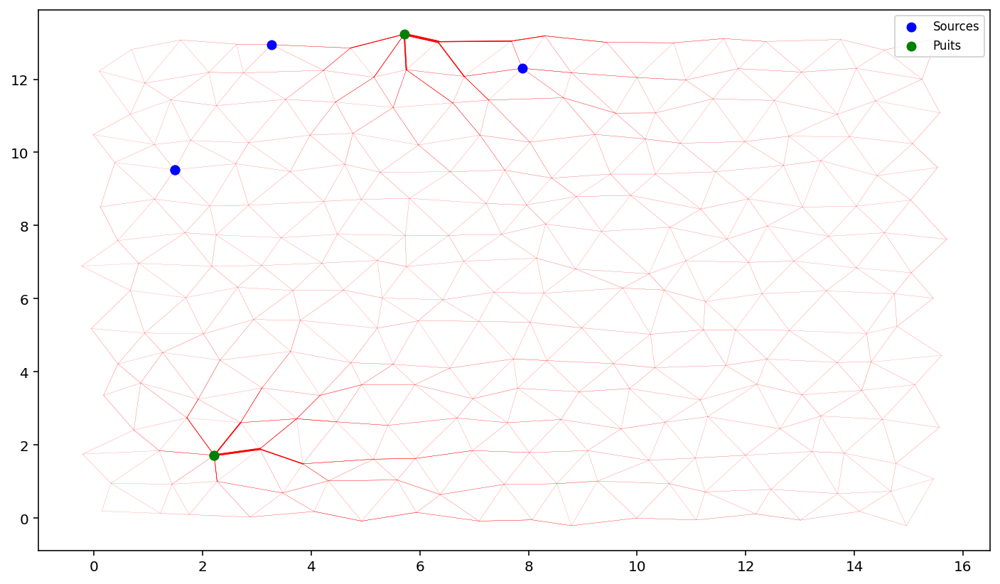

Le temps de la figure ci-dessous est à t = 600


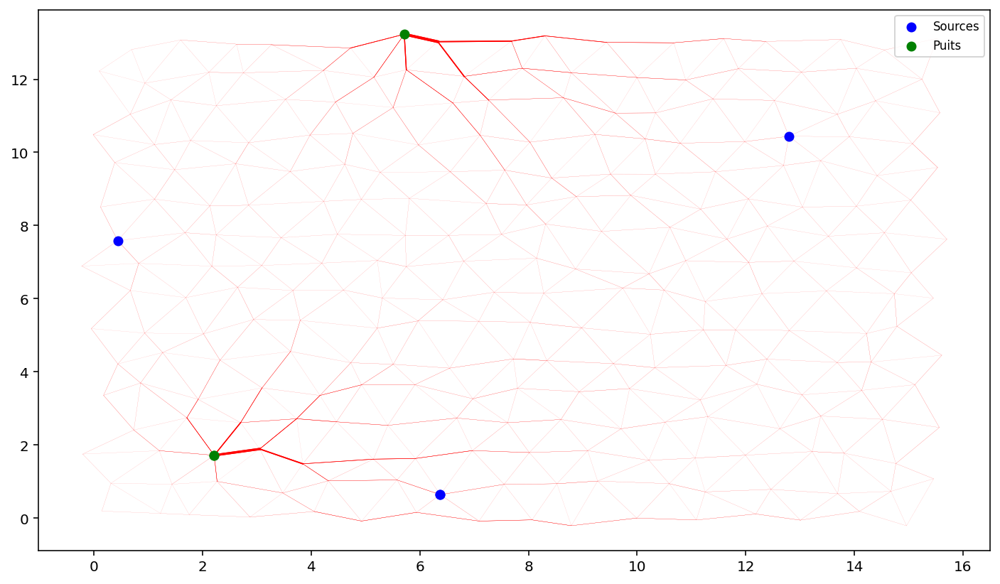

Le temps de la figure ci-dessous est à t = 700


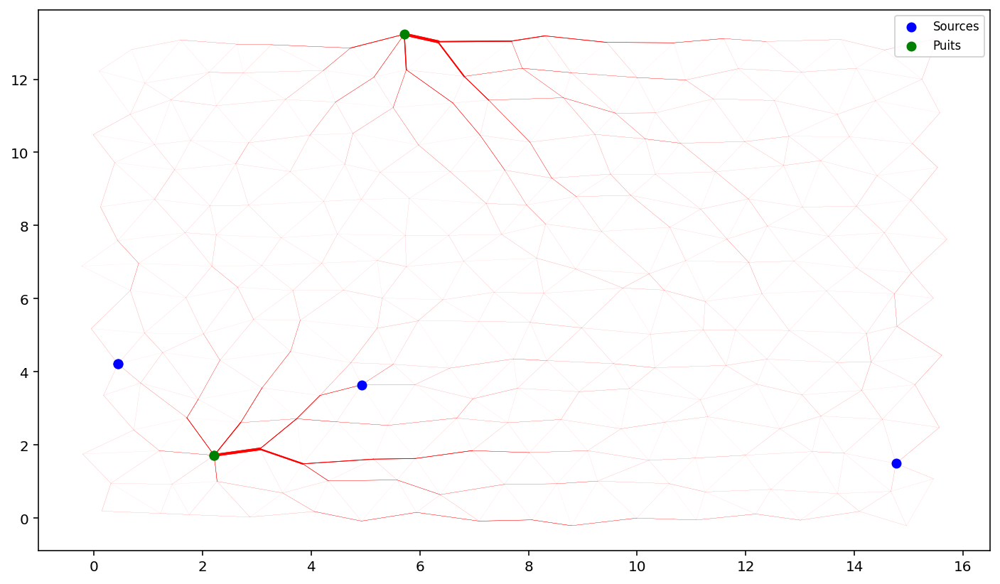

Le temps de la figure ci-dessous est à t = 800


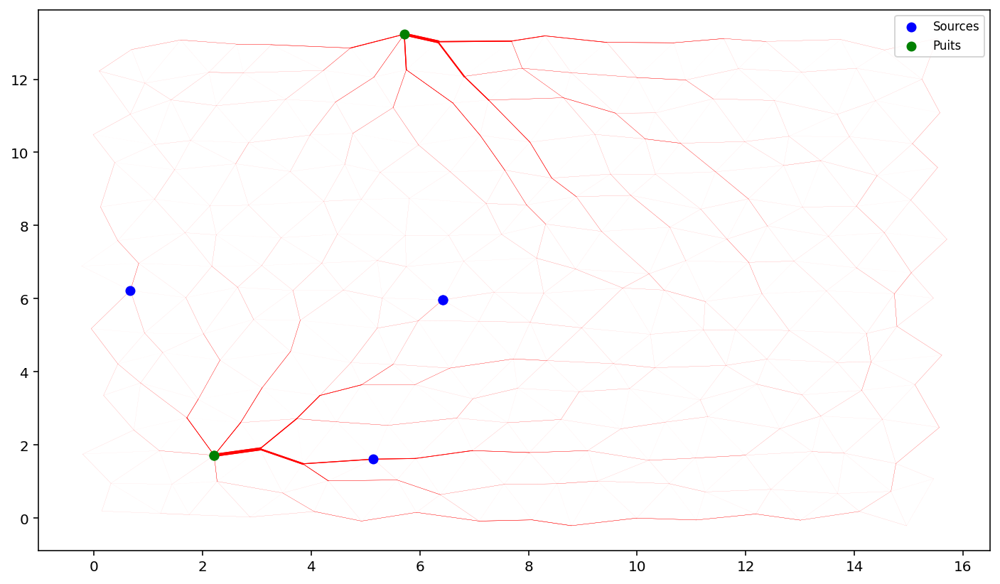

Le temps de la figure ci-dessous est à t = 900


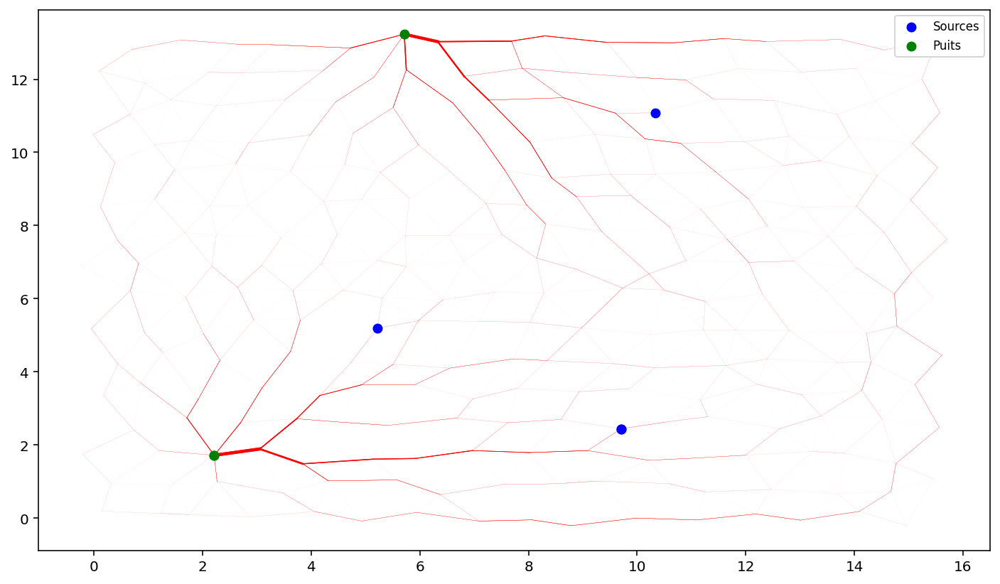

Le temps de la figure ci-dessous est à t = 1000


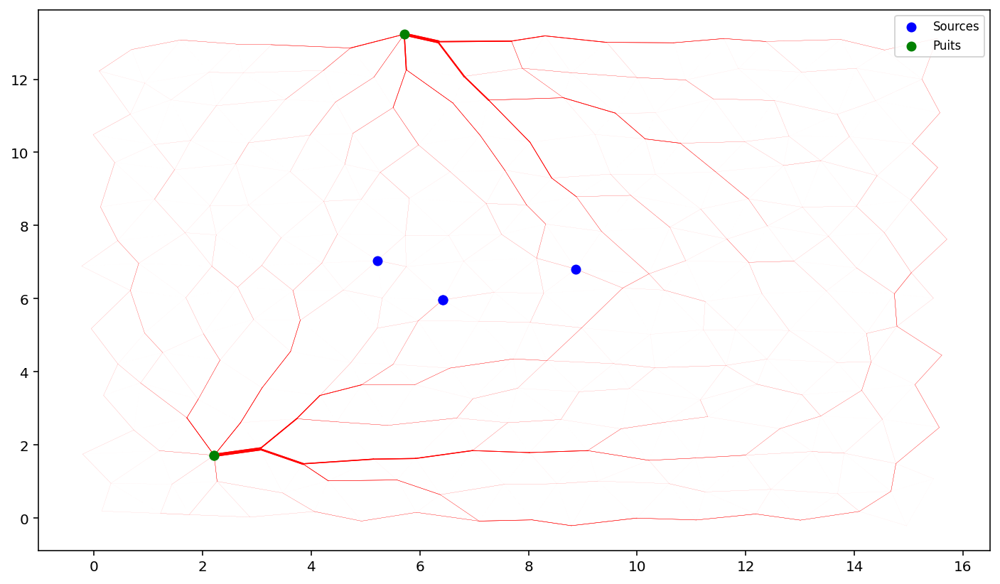

In [7]:
test_blob = blob(256,2,3,maille="hex") #SOURCES MOUVANTES
for t in range(1001):
    test_blob.calcule_D(0.01,TAU = 1, GAMMA = 1.8, sources=True)
    if t%100 == 0:
        print("Le temps de la figure ci-dessous est à t =", t)
        test_blob.plot()

Le temps de la figure ci-dessous est à t = 0


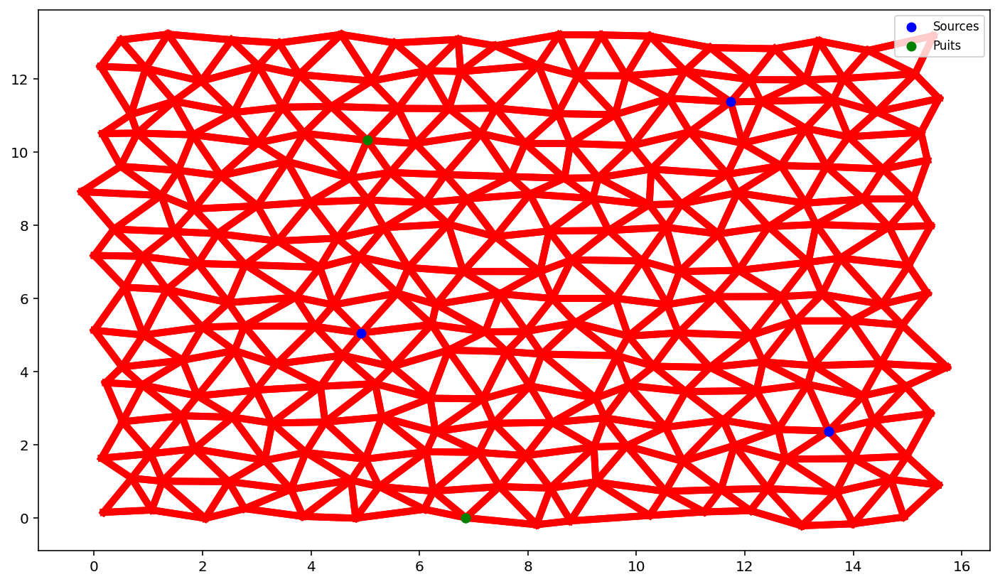

Le temps de la figure ci-dessous est à t = 100


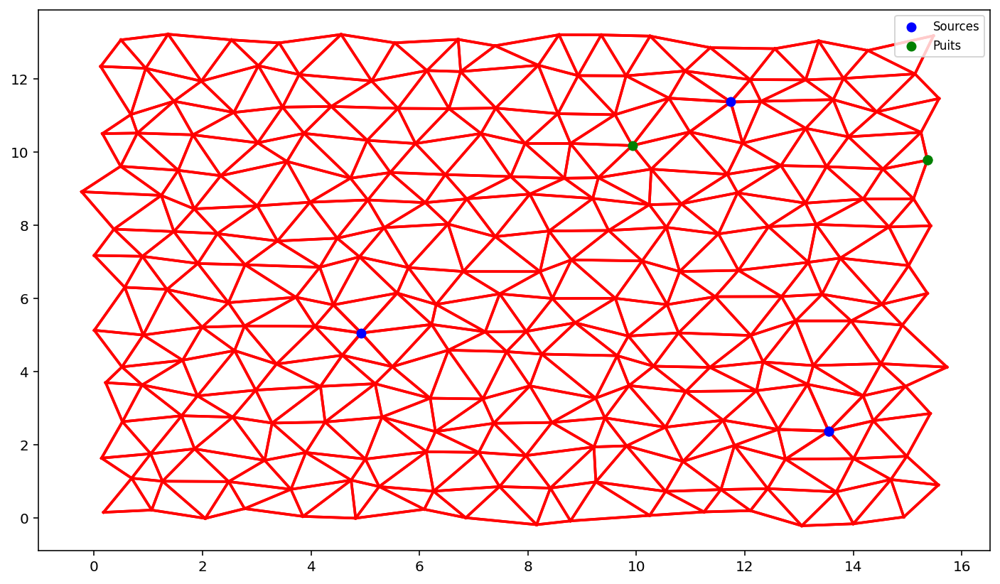

Le temps de la figure ci-dessous est à t = 200


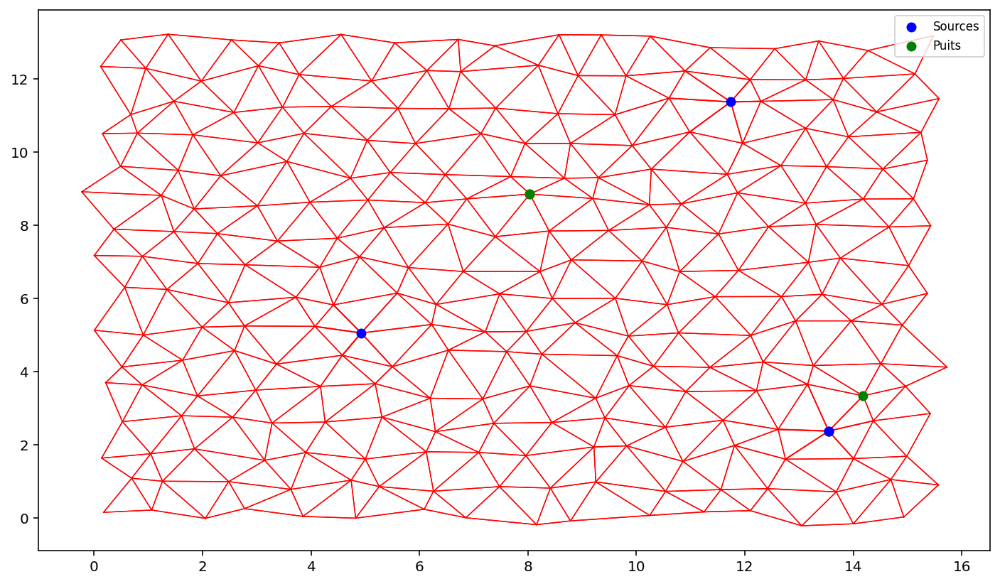

Le temps de la figure ci-dessous est à t = 300


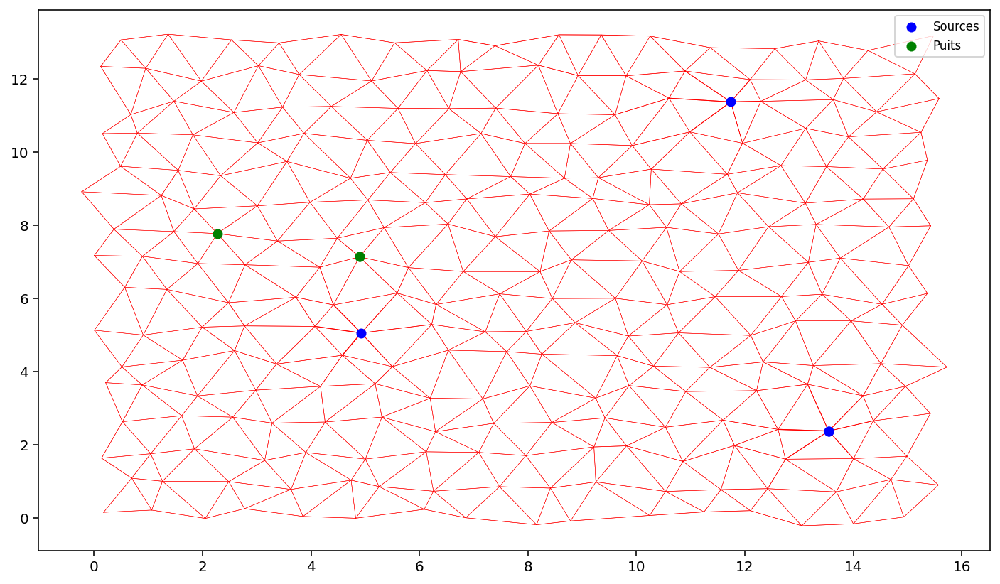

Le temps de la figure ci-dessous est à t = 400


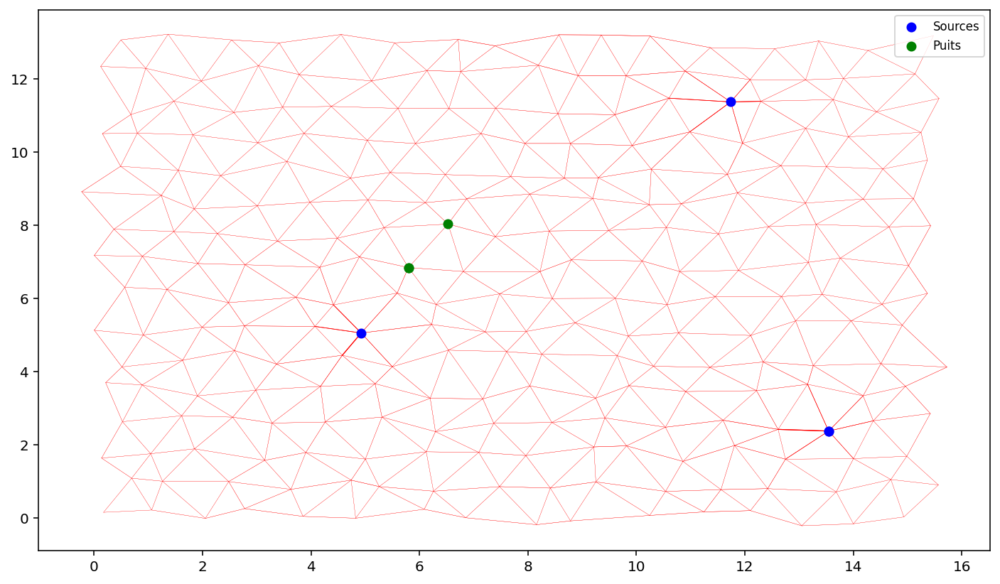

Le temps de la figure ci-dessous est à t = 500


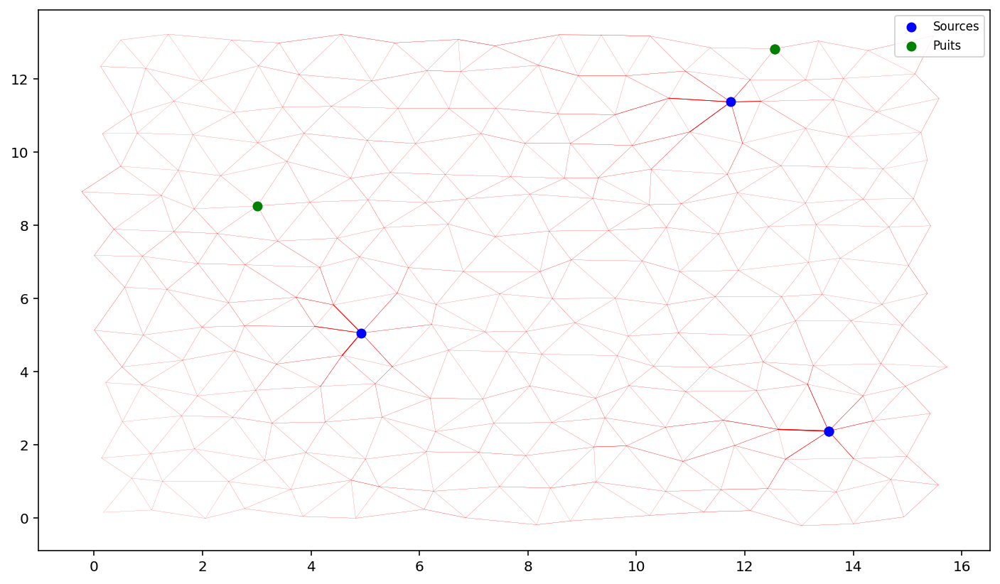

Le temps de la figure ci-dessous est à t = 600


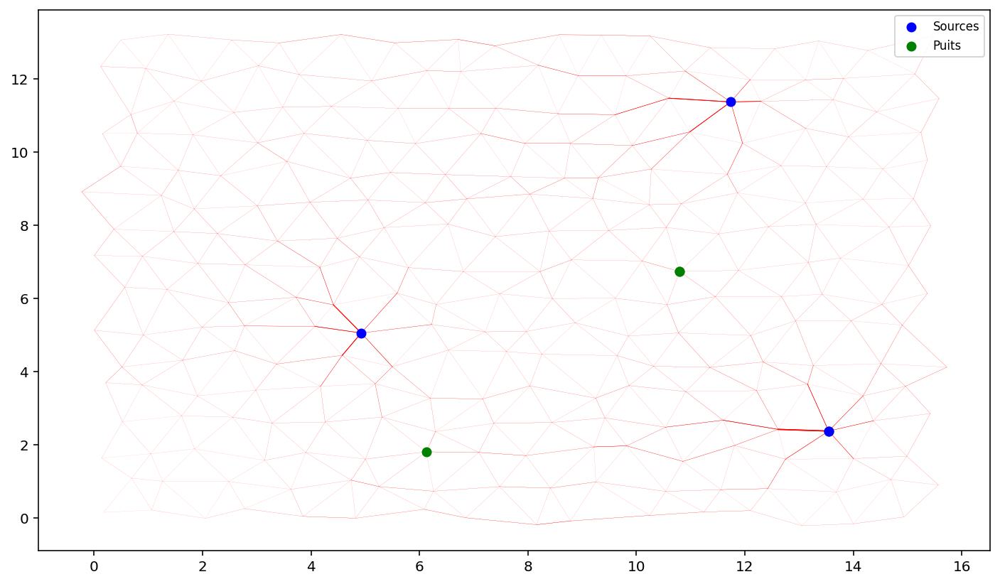

Le temps de la figure ci-dessous est à t = 700


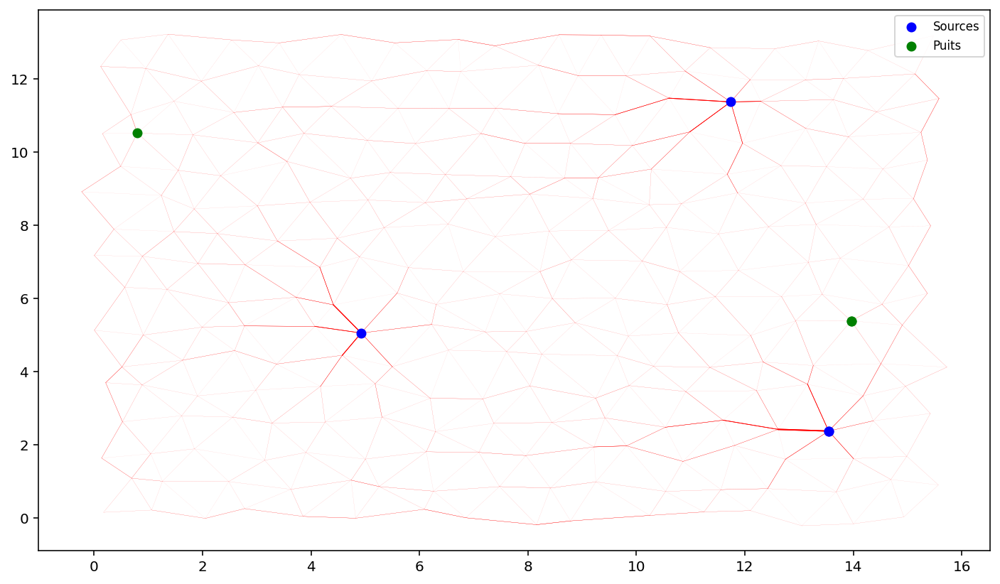

Le temps de la figure ci-dessous est à t = 800


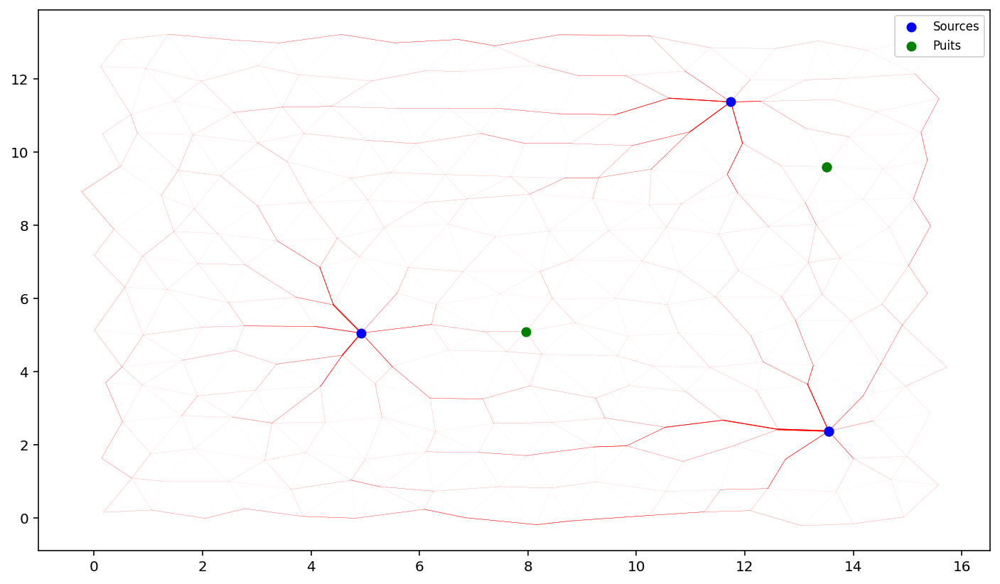

Le temps de la figure ci-dessous est à t = 900


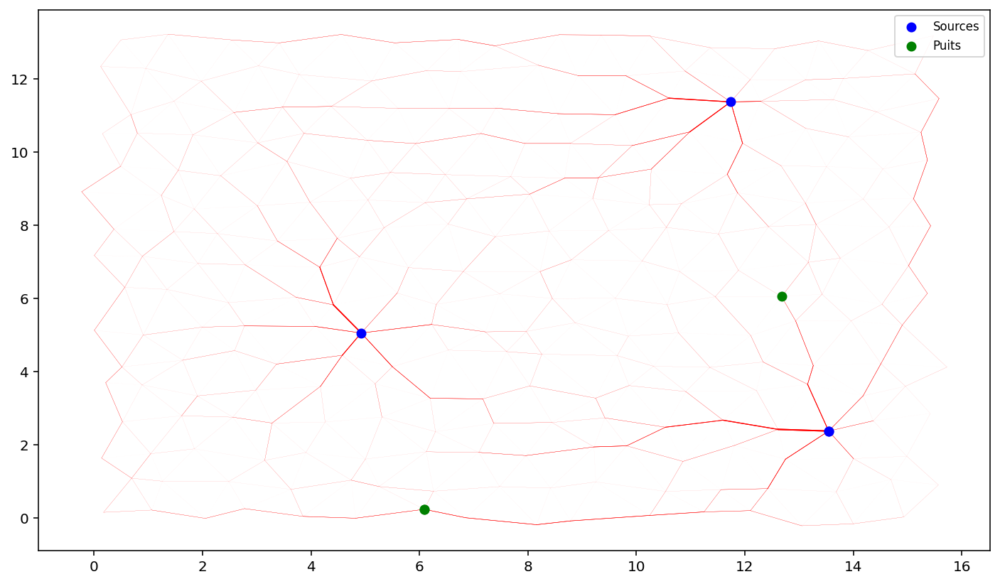

Le temps de la figure ci-dessous est à t = 1000


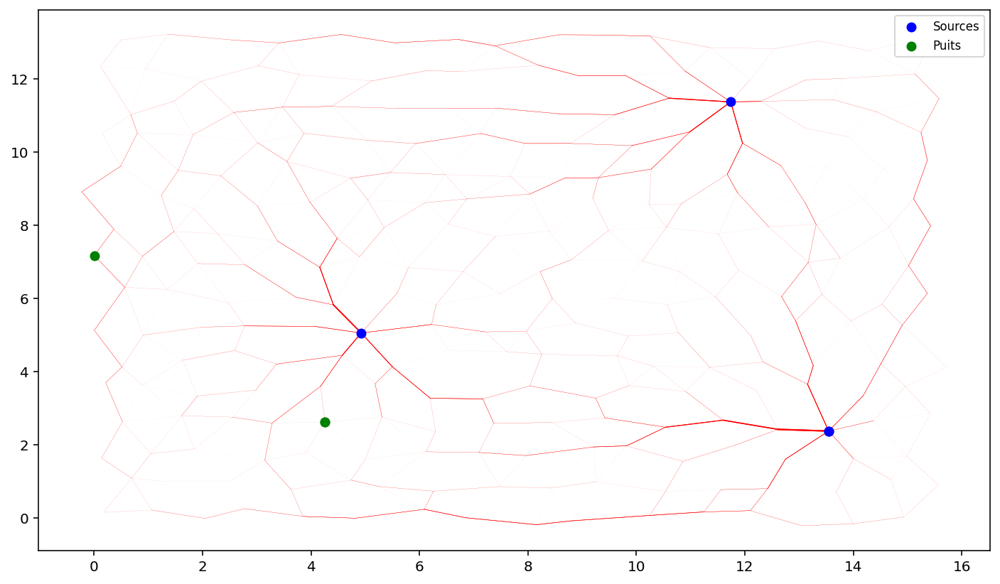

In [8]:
test_blob = blob(256,2,3,maille="hex") #PUITS MOUVANTS
for t in range(1001):
    test_blob.calcule_D(0.01,TAU = 1, GAMMA = 1.8, puits=True)
    if t%100 == 0:
        print("Le temps de la figure ci-dessous est à t =", t)
        test_blob.plot()

Le temps de la figure ci-dessous est à t = 0


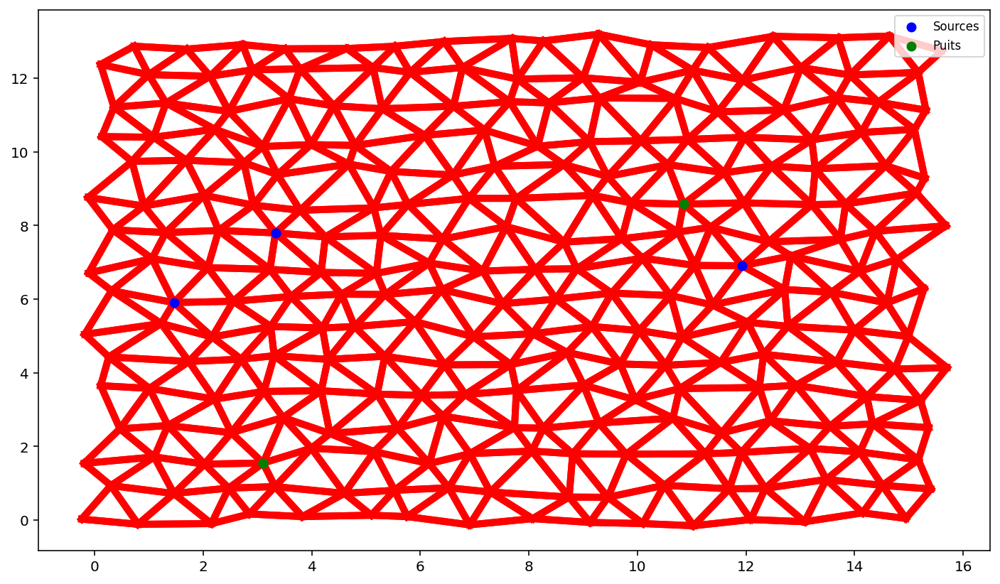

Le temps de la figure ci-dessous est à t = 100


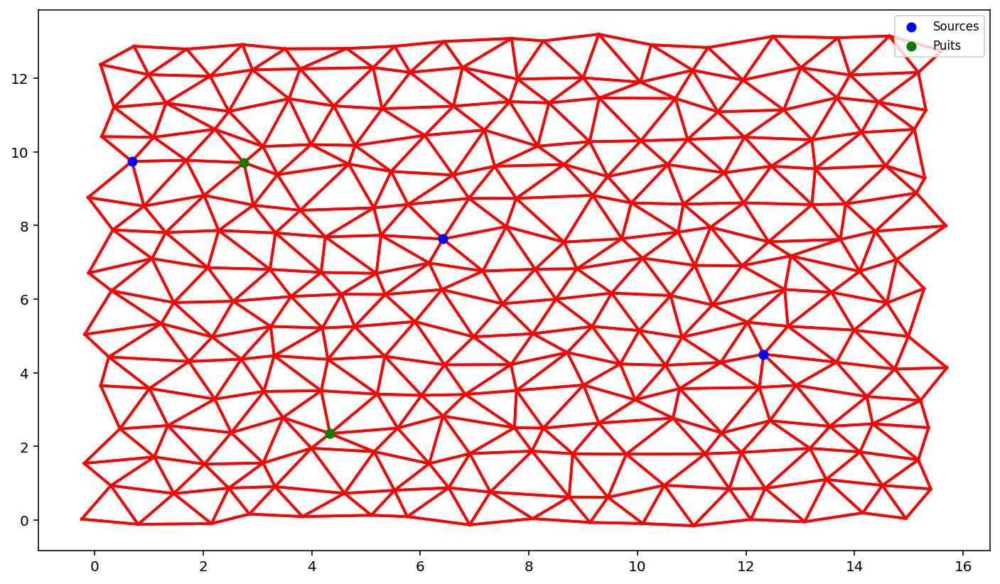

Le temps de la figure ci-dessous est à t = 200


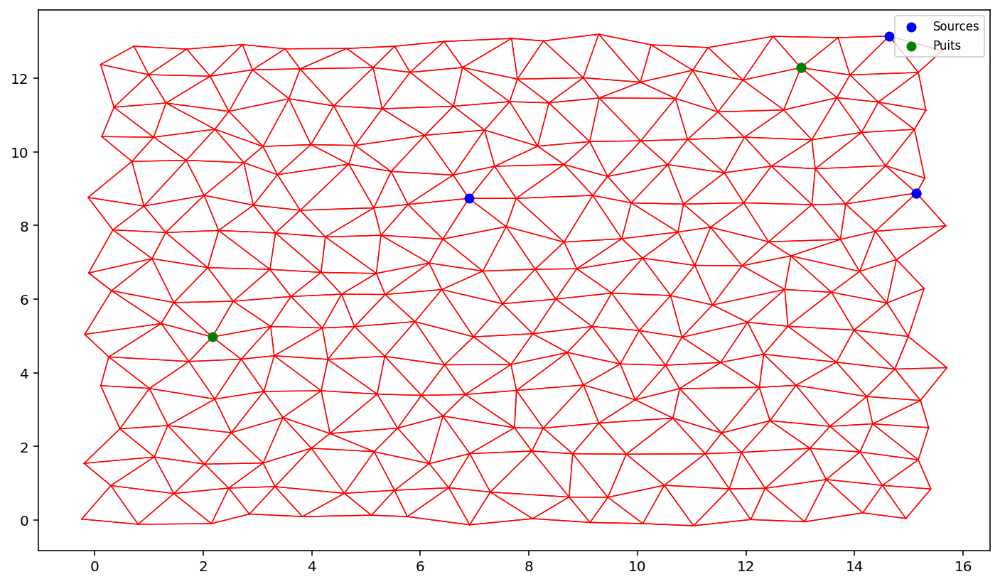

Le temps de la figure ci-dessous est à t = 300


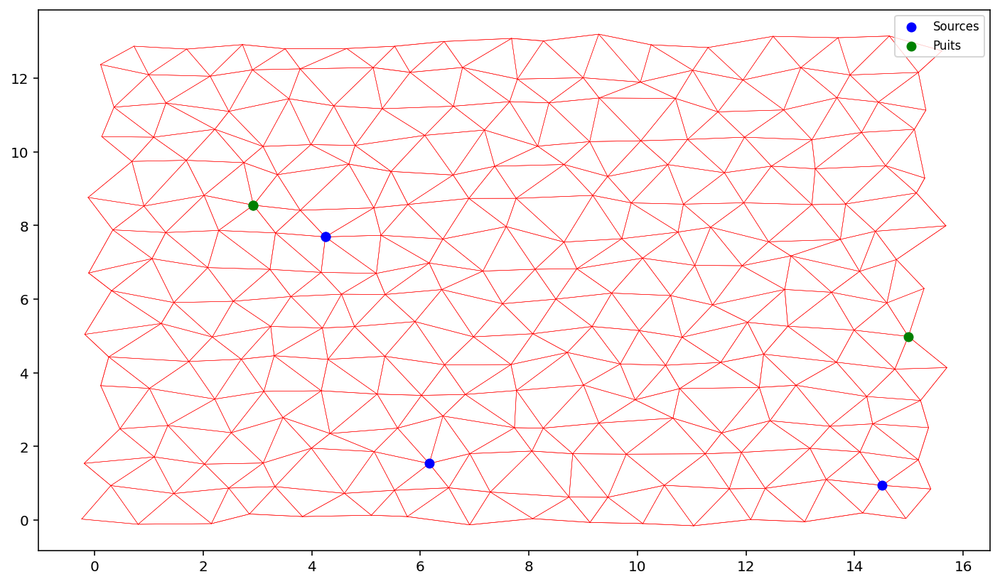

Le temps de la figure ci-dessous est à t = 400


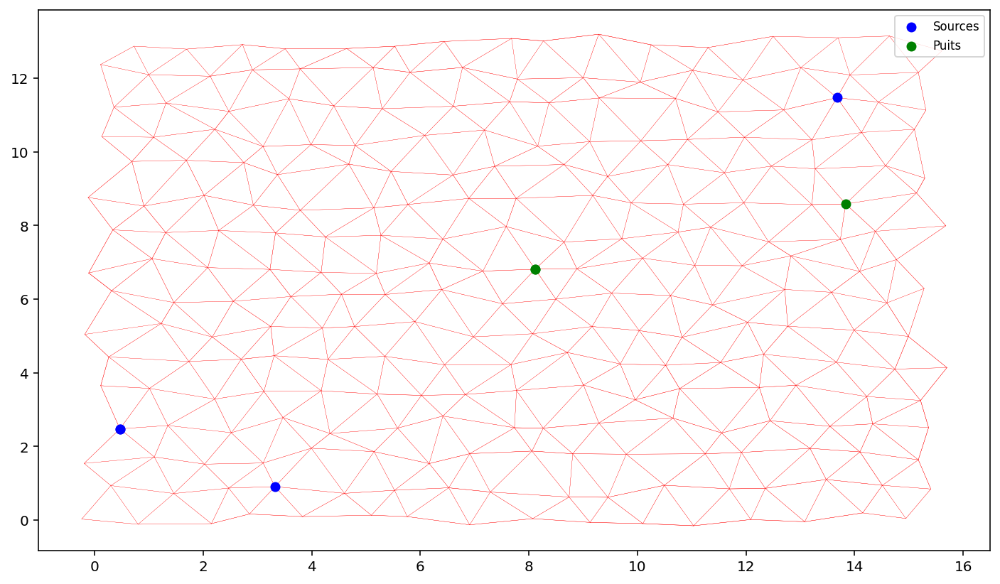

Le temps de la figure ci-dessous est à t = 500


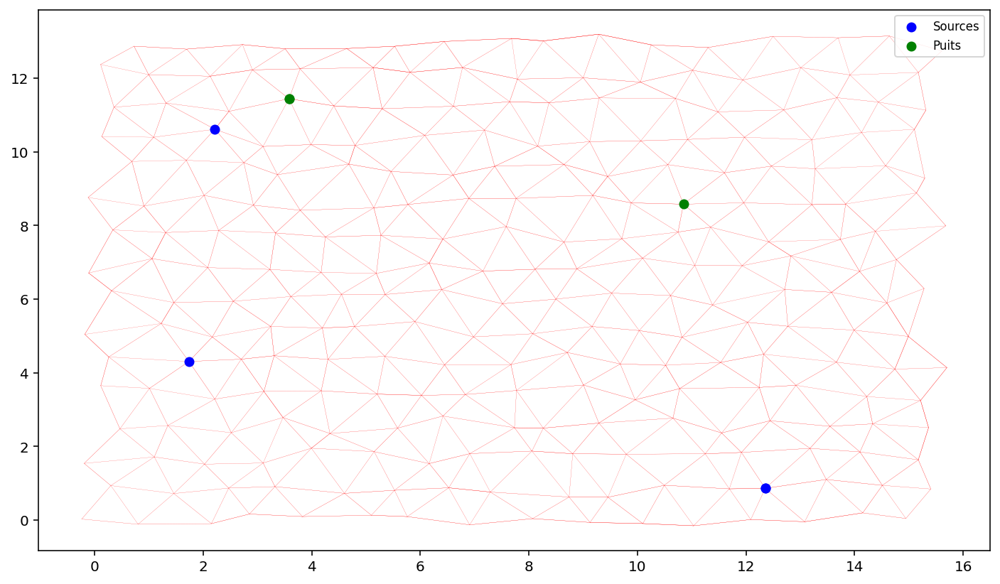

Le temps de la figure ci-dessous est à t = 600


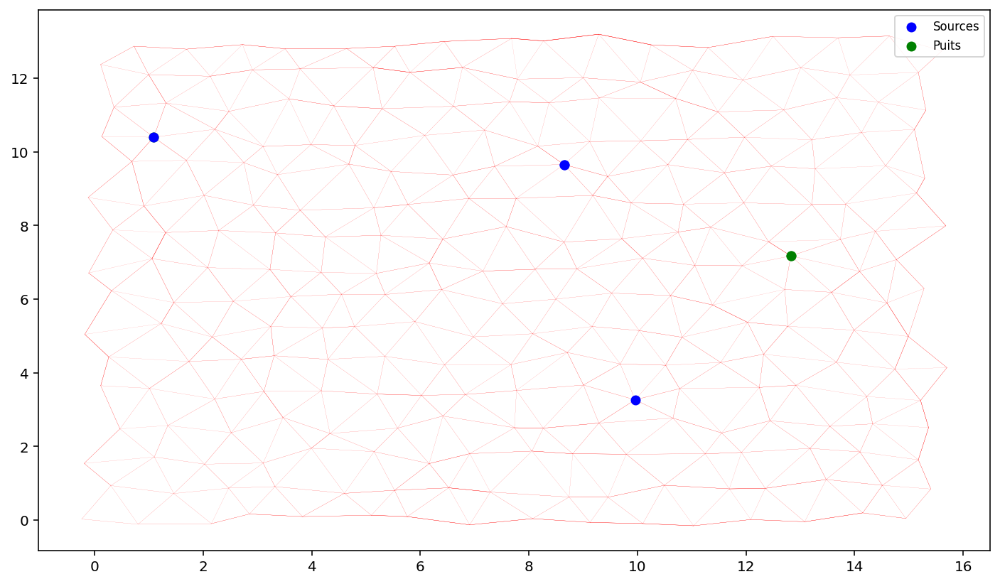

Le temps de la figure ci-dessous est à t = 700


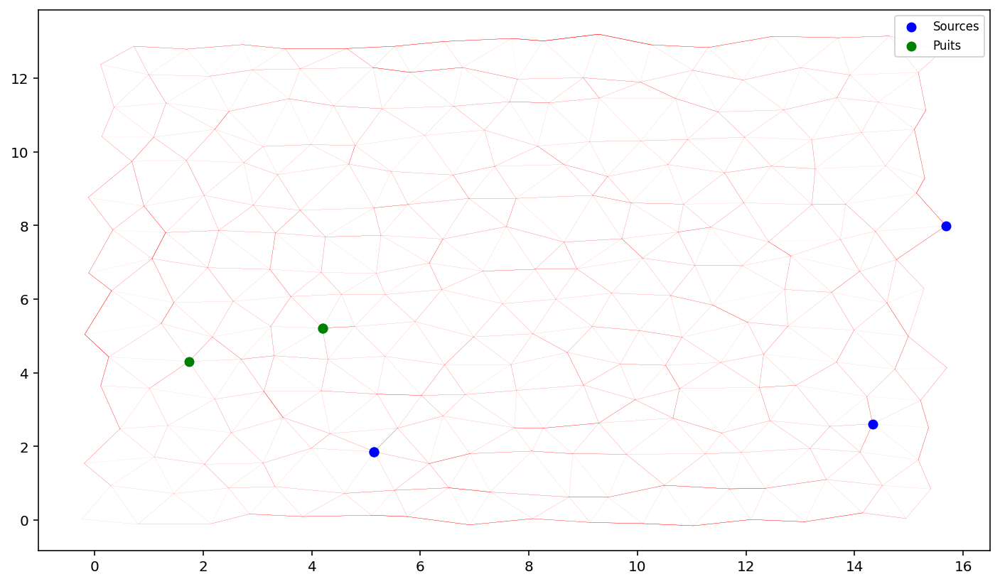

Le temps de la figure ci-dessous est à t = 800


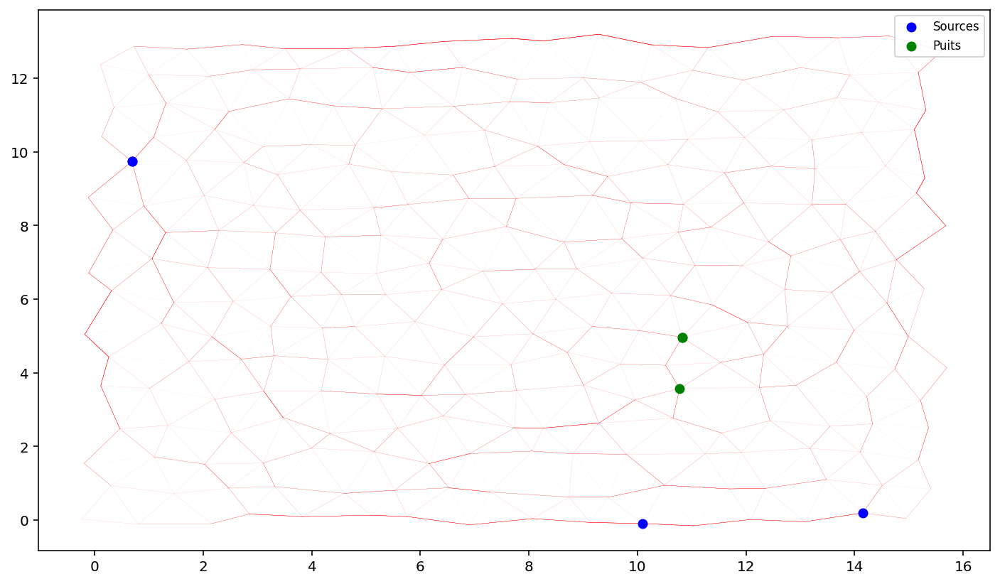

Le temps de la figure ci-dessous est à t = 900


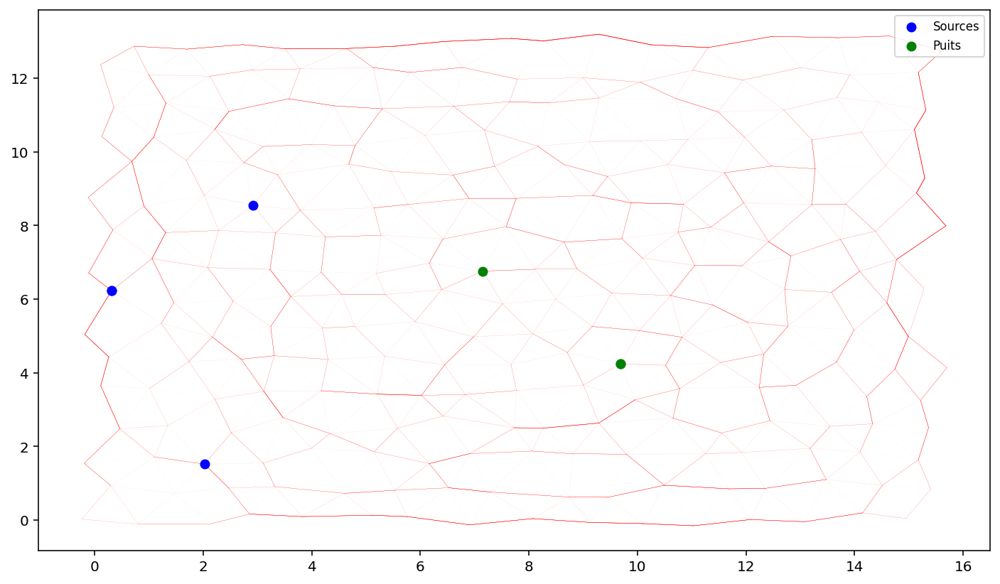

Le temps de la figure ci-dessous est à t = 1000


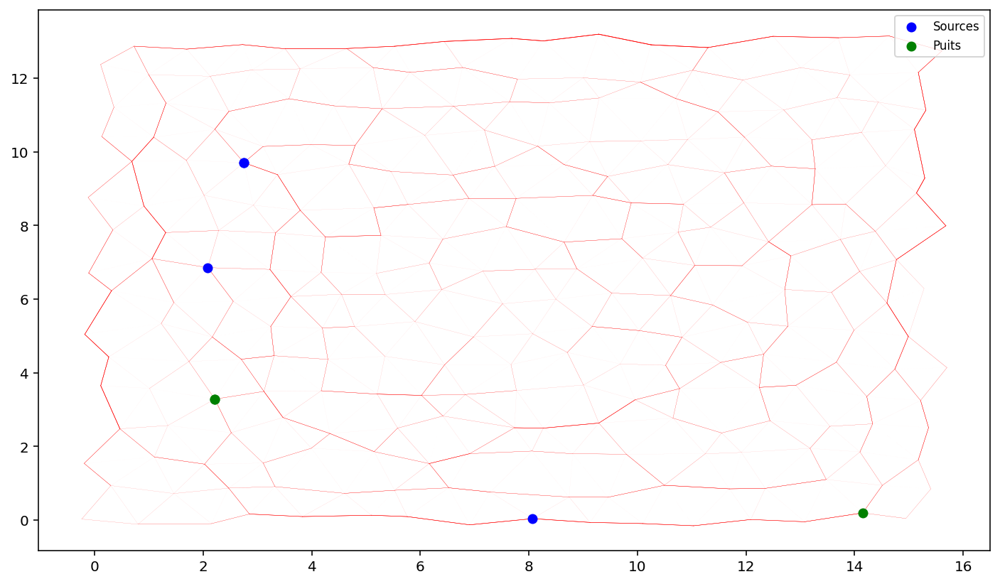

Le temps de la figure ci-dessous est à t = 1100


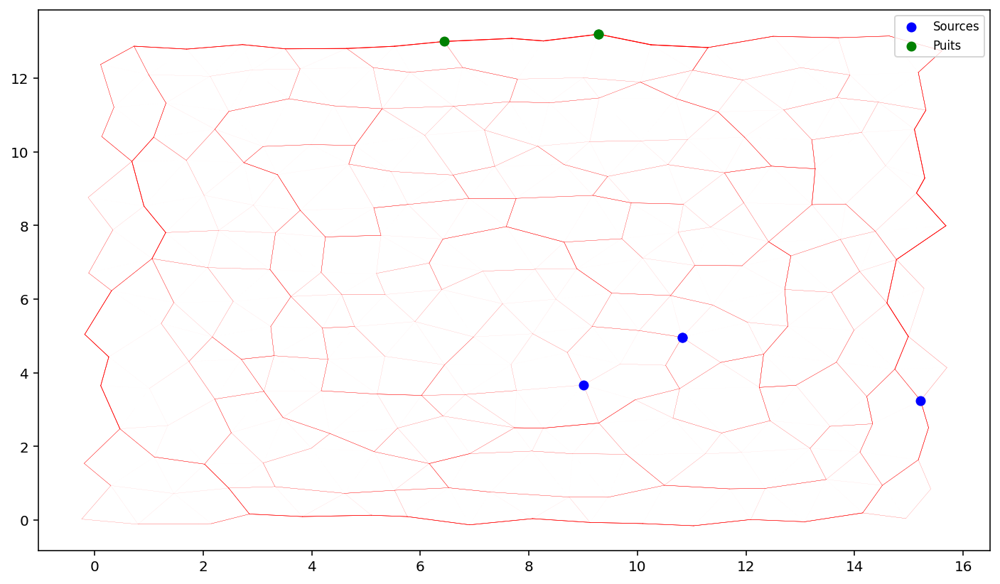

Le temps de la figure ci-dessous est à t = 1200


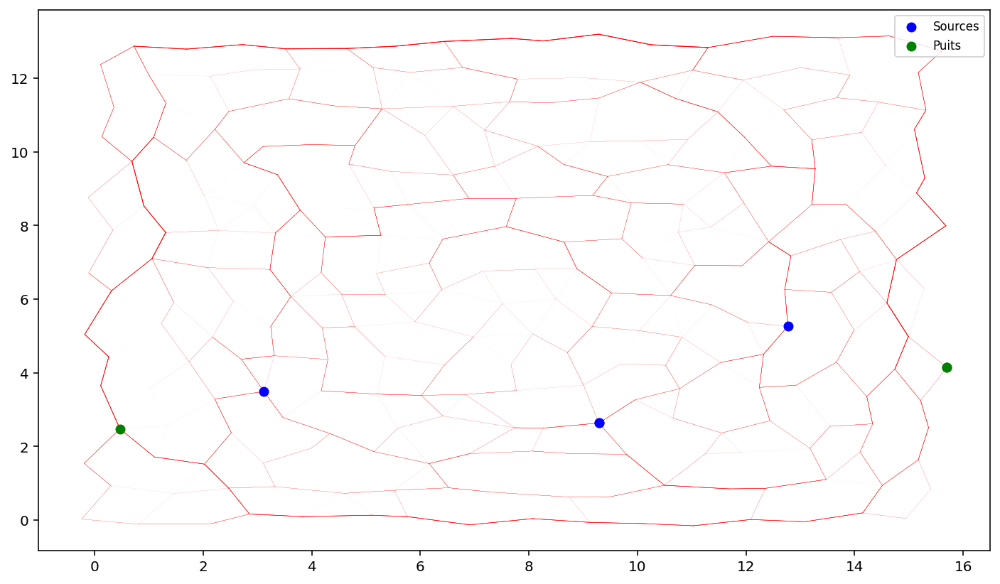

Le temps de la figure ci-dessous est à t = 1300


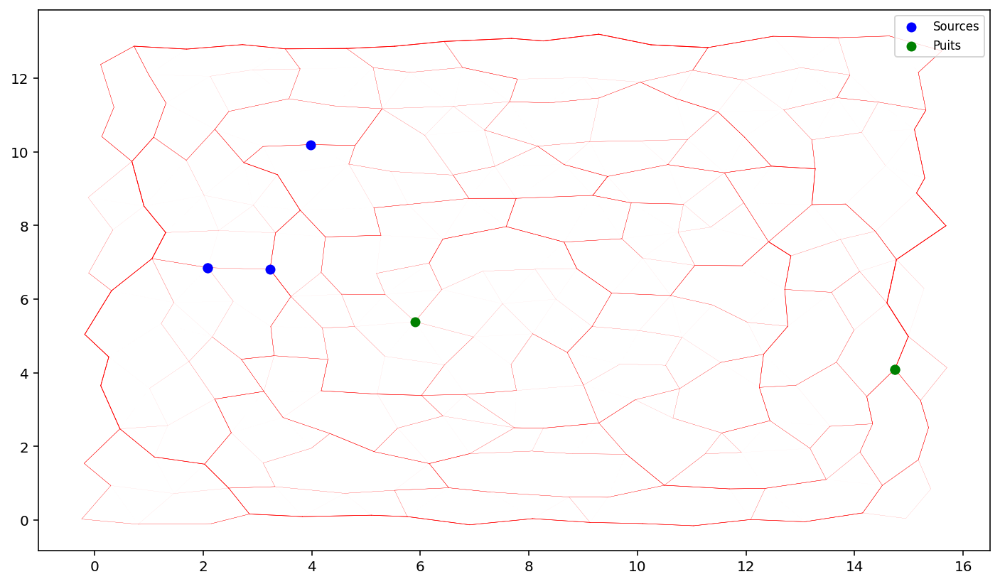

Le temps de la figure ci-dessous est à t = 1400


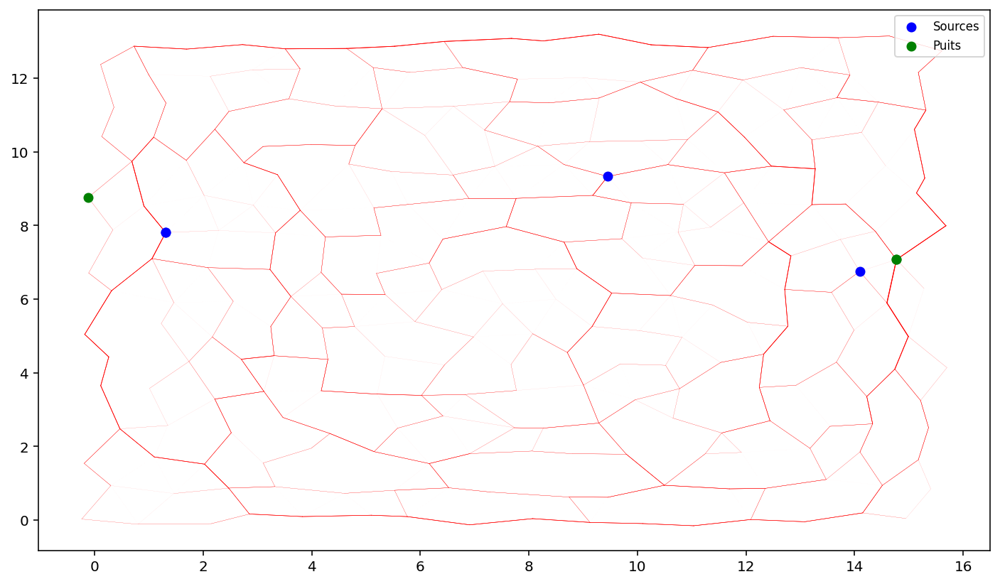

Le temps de la figure ci-dessous est à t = 1500


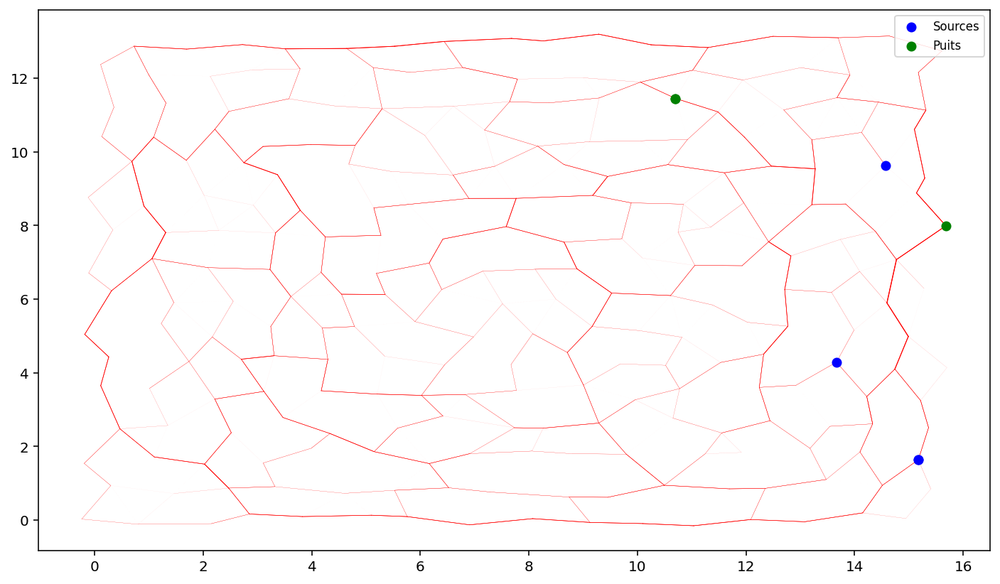

Le temps de la figure ci-dessous est à t = 1600


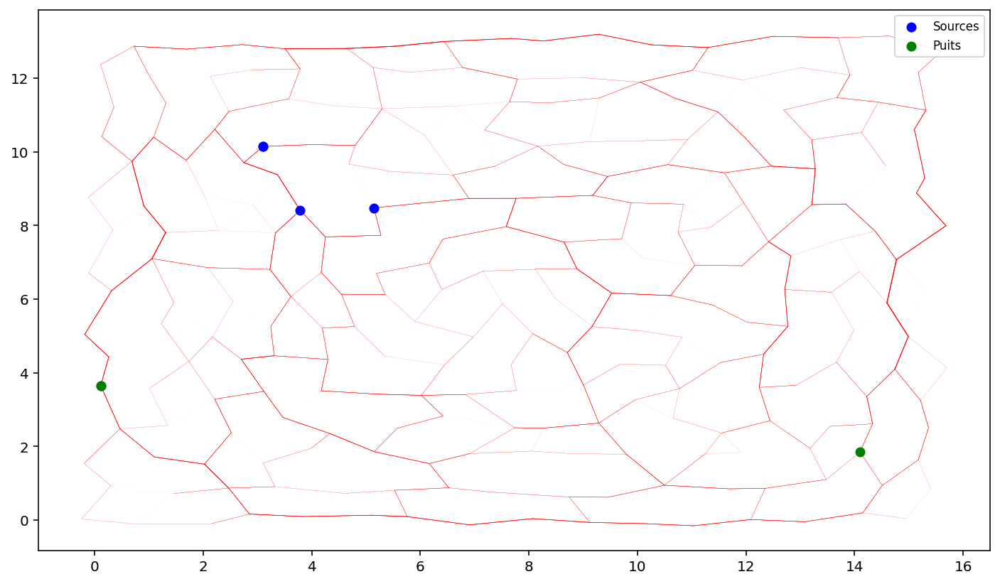

Le temps de la figure ci-dessous est à t = 1700


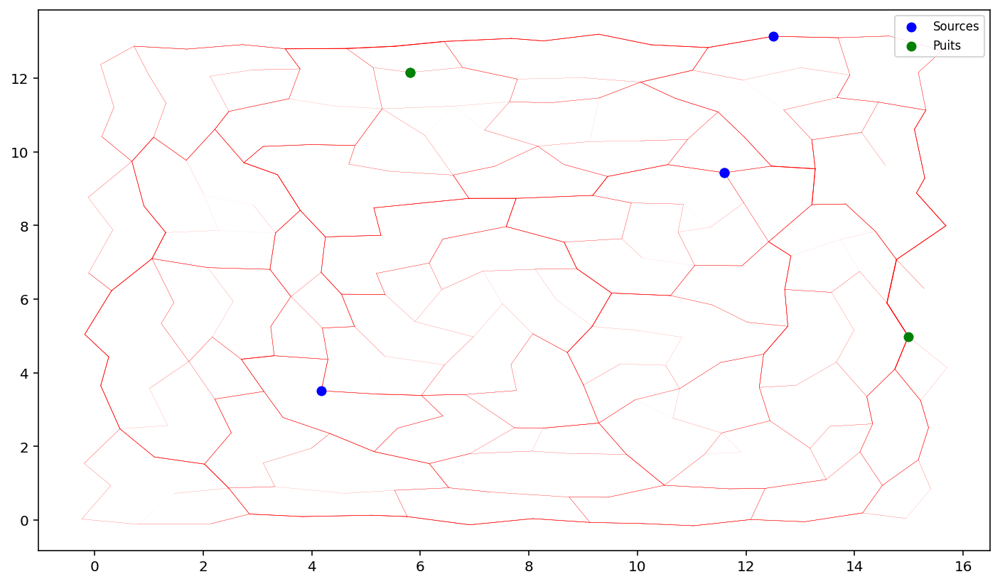

Le temps de la figure ci-dessous est à t = 1800


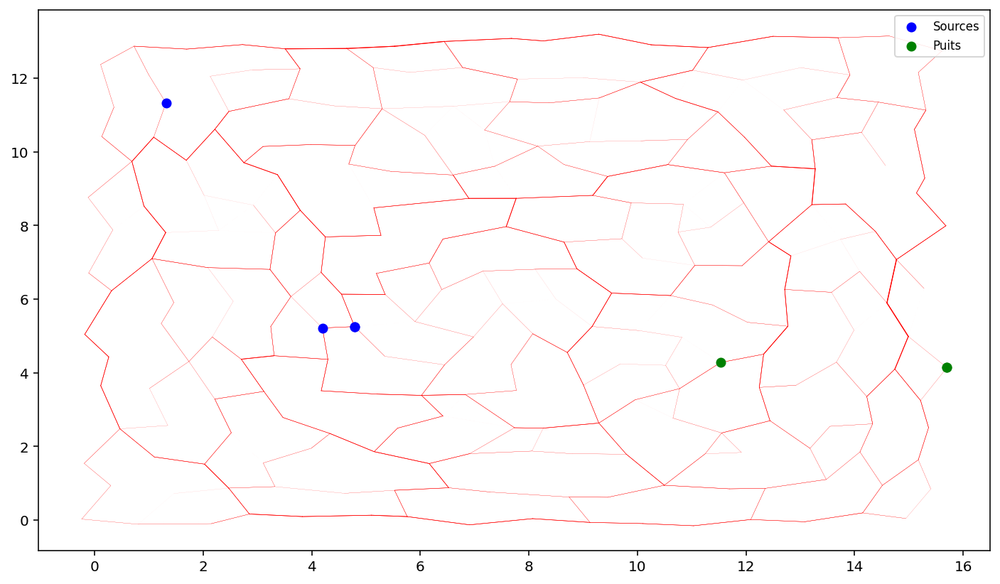

Le temps de la figure ci-dessous est à t = 1900


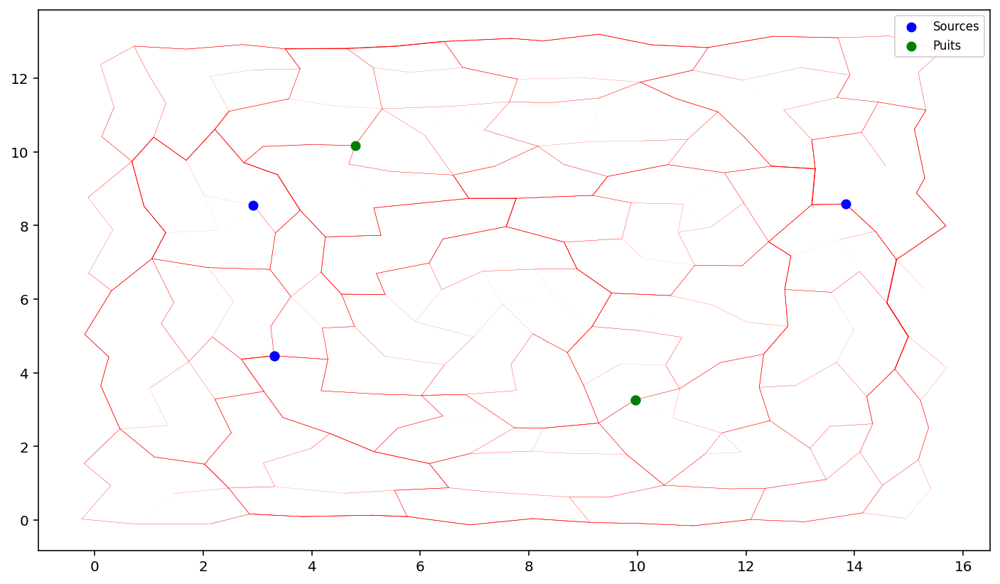

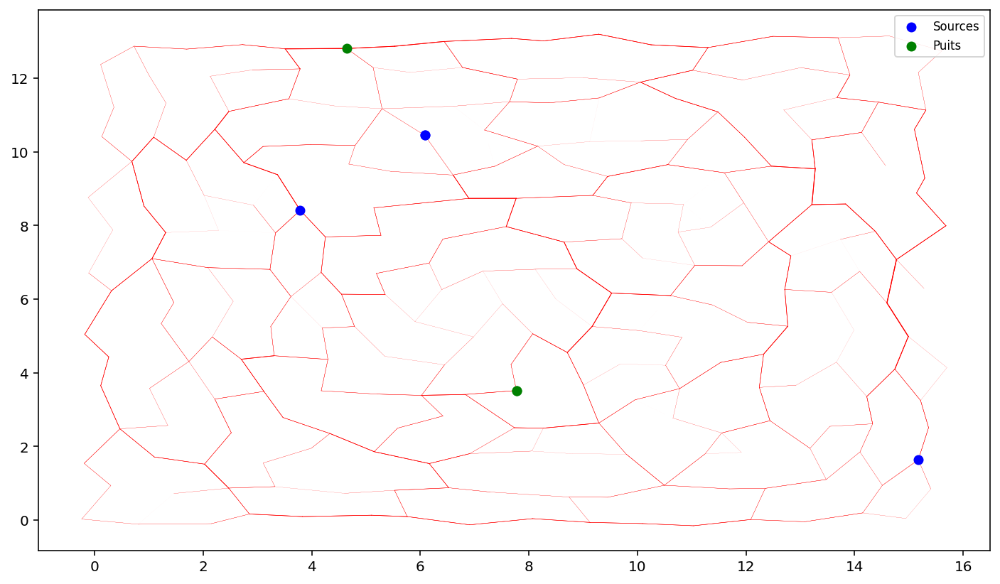

In [9]:
test_blob = blob(256,2,3,maille="hex") #SOURCES ET PUITS MOUVANTS
for t in range(2001):
    test_blob.calcule_D(0.01,TAU = 1, GAMMA = 1.8,puits = True, sources=True)
    if t%100 == 0:
        print("Le temps de la figure ci-dessous est à t =", t)
        test_blob.plot()

Intensité de la source n°1 50

Intensité de la source n°2 50

Intensité du puit n°1 -50

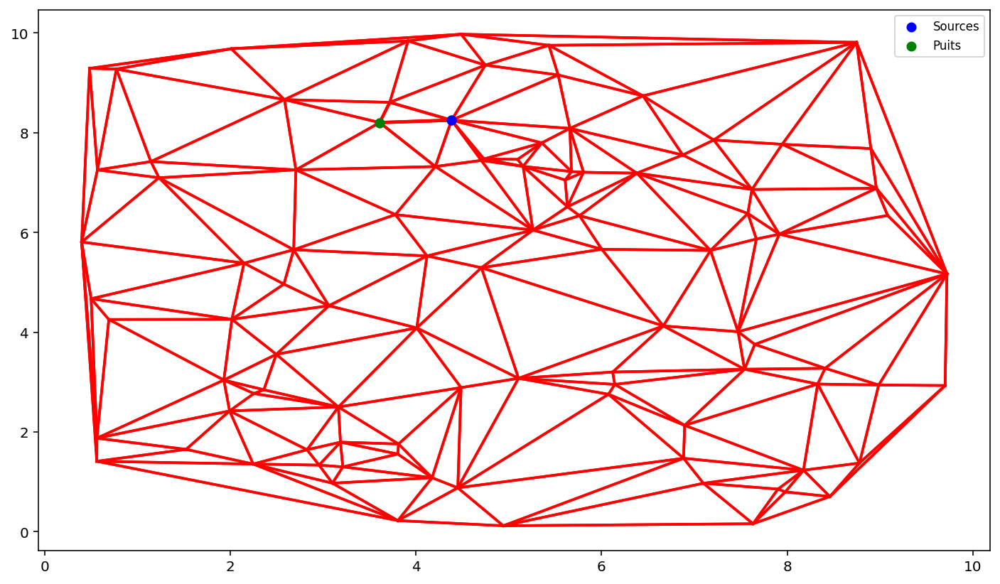

Le temps de la figure ci-dessous est à t = 200


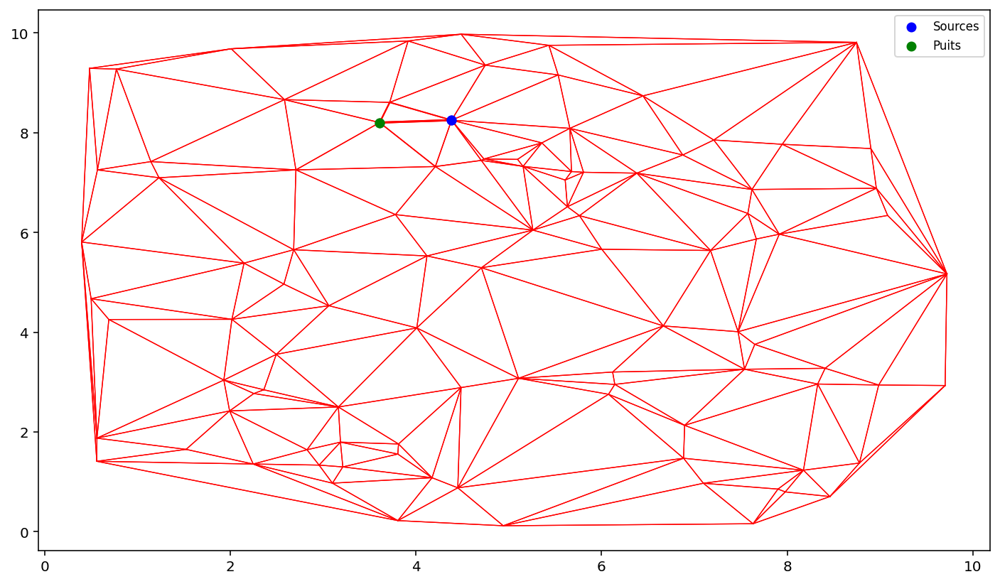

Le temps de la figure ci-dessous est à t = 300


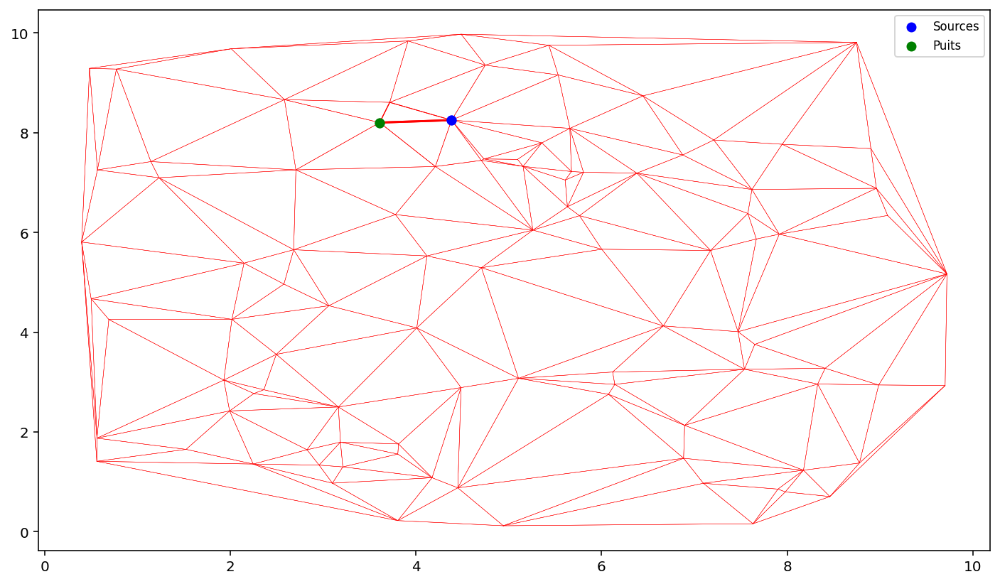

Le temps de la figure ci-dessous est à t = 400


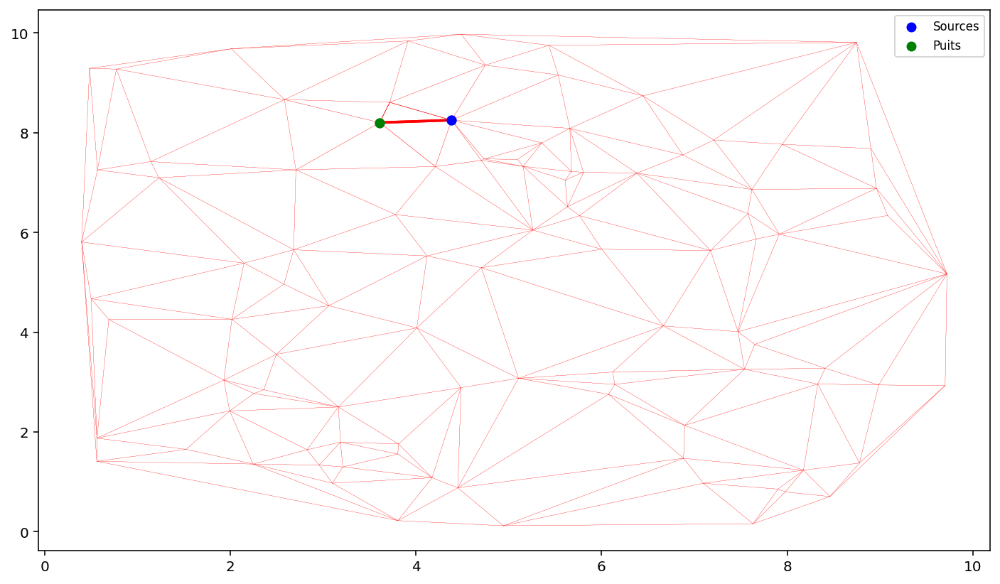

Le temps de la figure ci-dessous est à t = 500


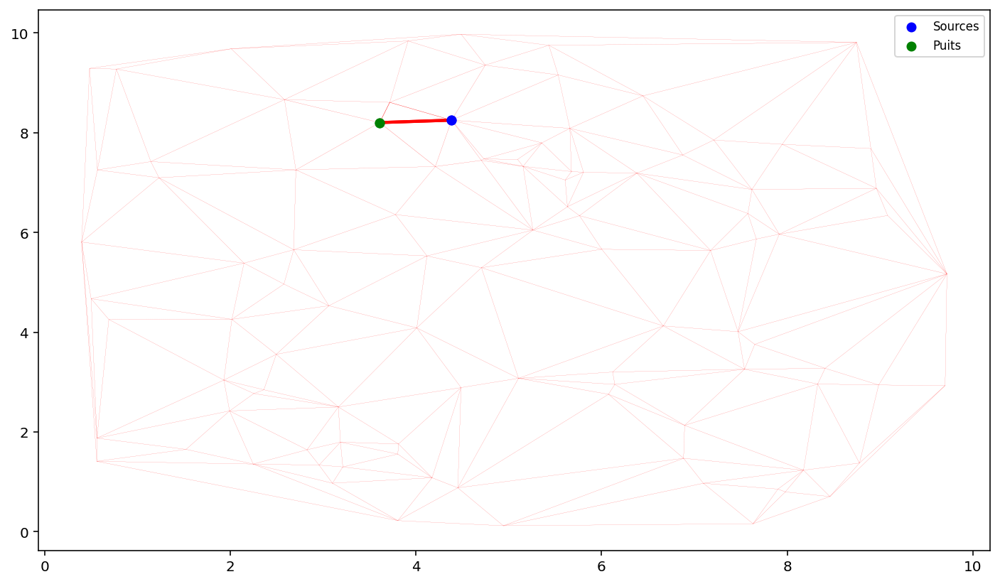

Le temps de la figure ci-dessous est à t = 600


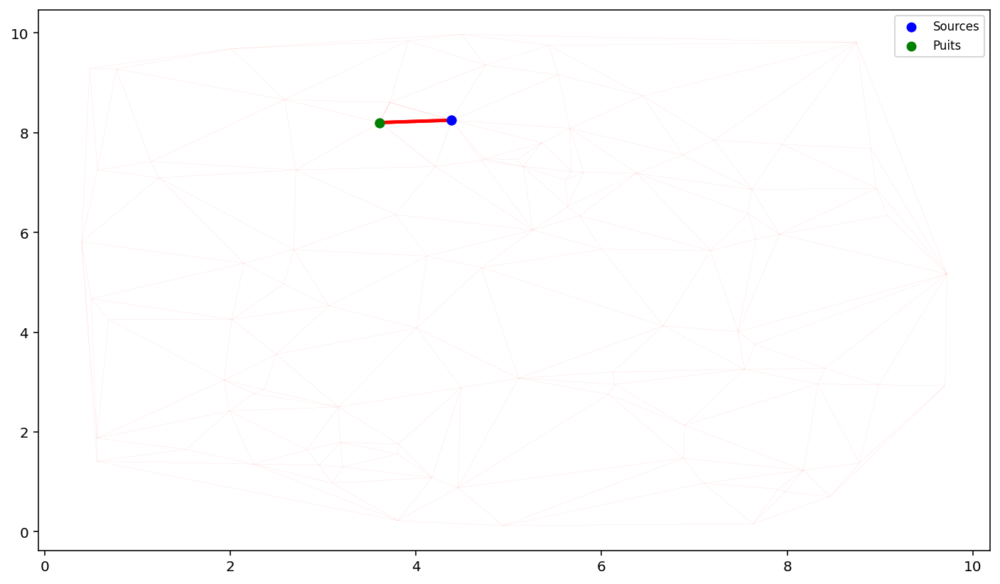

Le temps de la figure ci-dessous est à t = 700


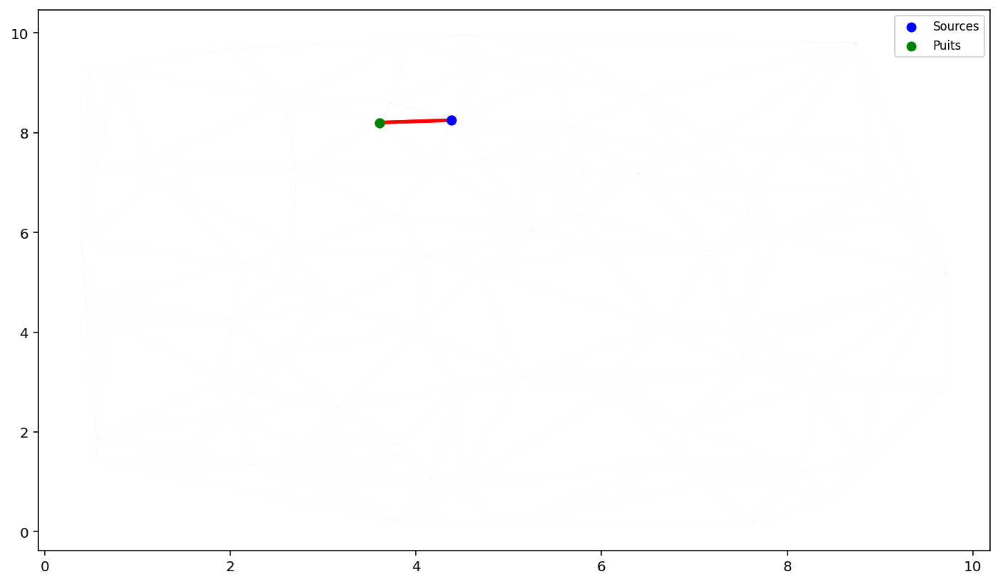

Le temps de la figure ci-dessous est à t = 800


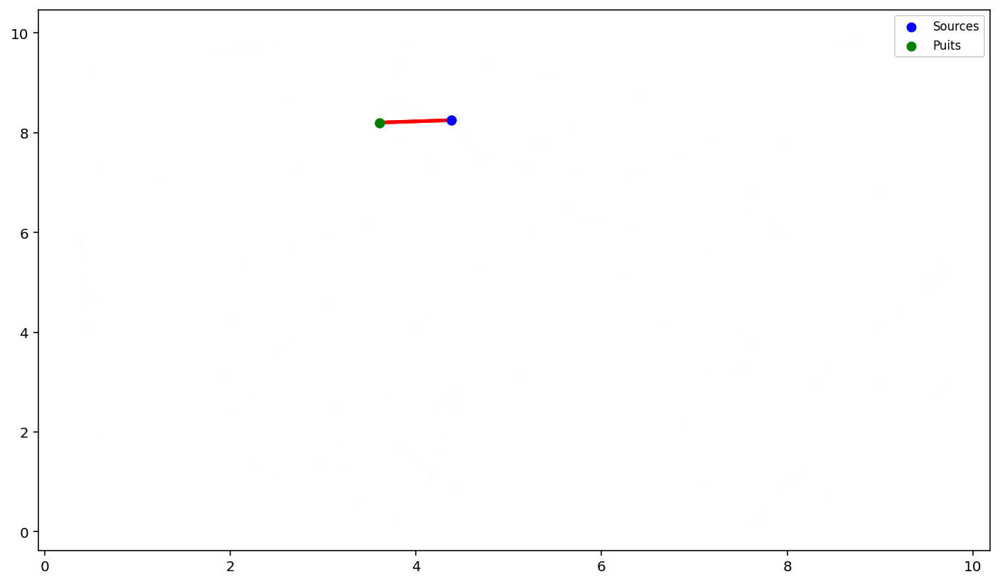

Le temps de la figure ci-dessous est à t = 900


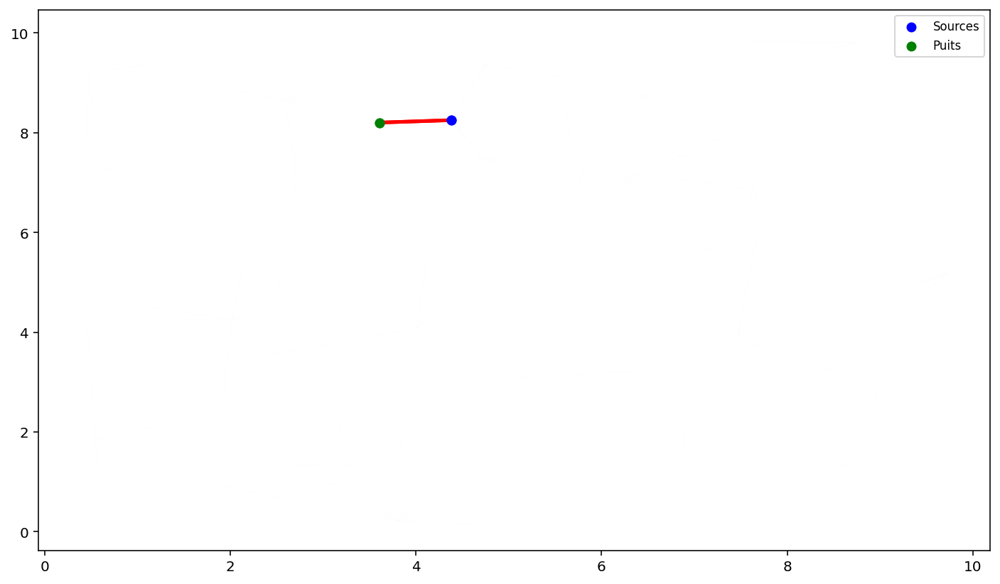

Le temps de la figure ci-dessous est à t = 1000


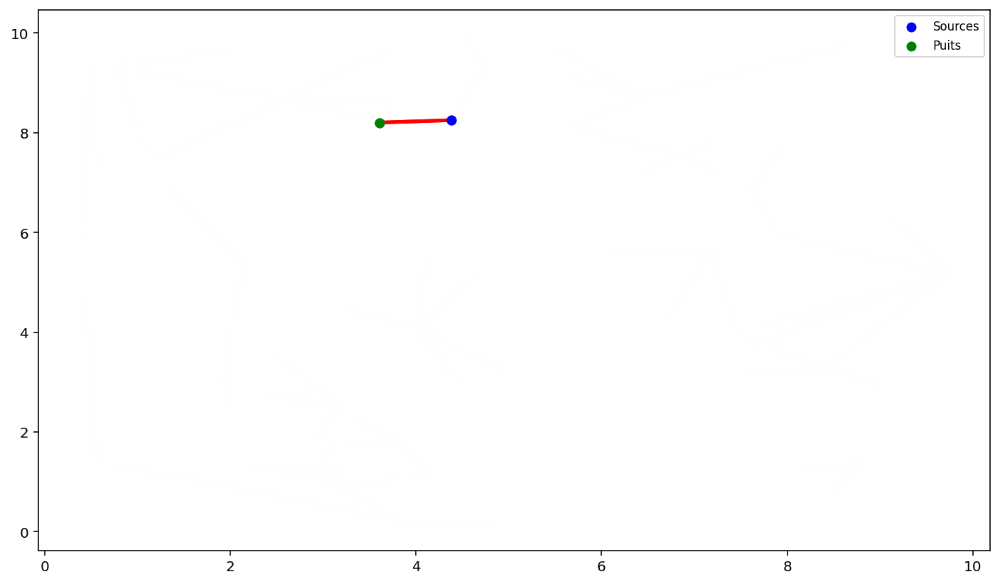

In [10]:
test_blob = blob(100,1,1,maille = "Delaunay")

for t in range(1001):
    test_blob.calcule_D(0.01,TAU = 1, GAMMA = 1.8)
    if t%100 == 0 :
        print("Le temps de la figure ci-dessous est à t =", t)
        test_blob.plot()

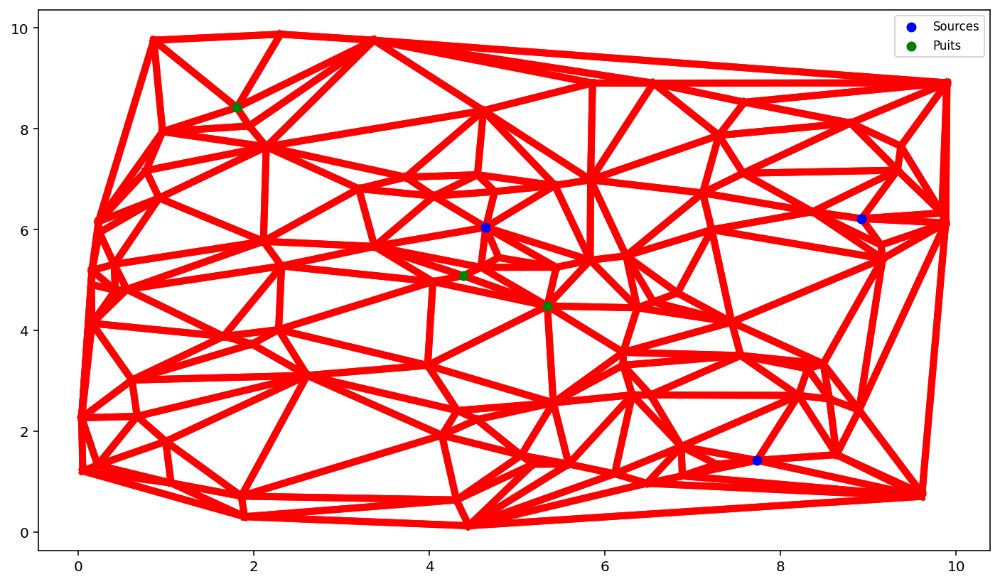

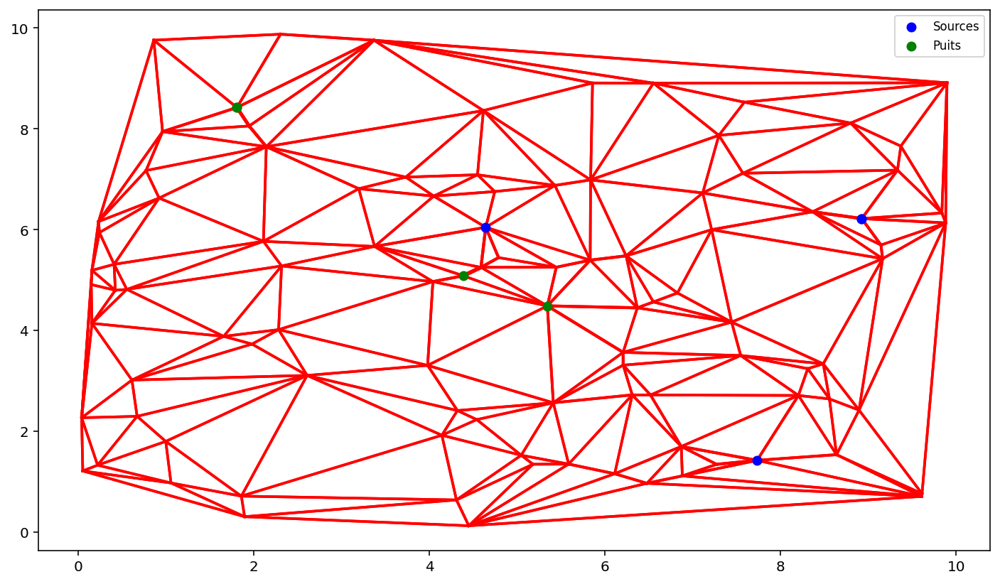

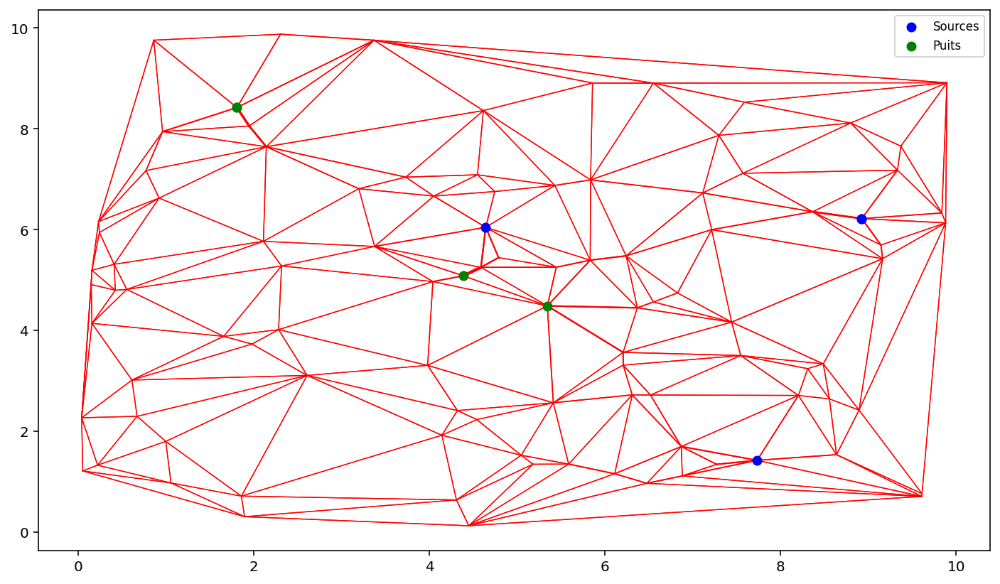

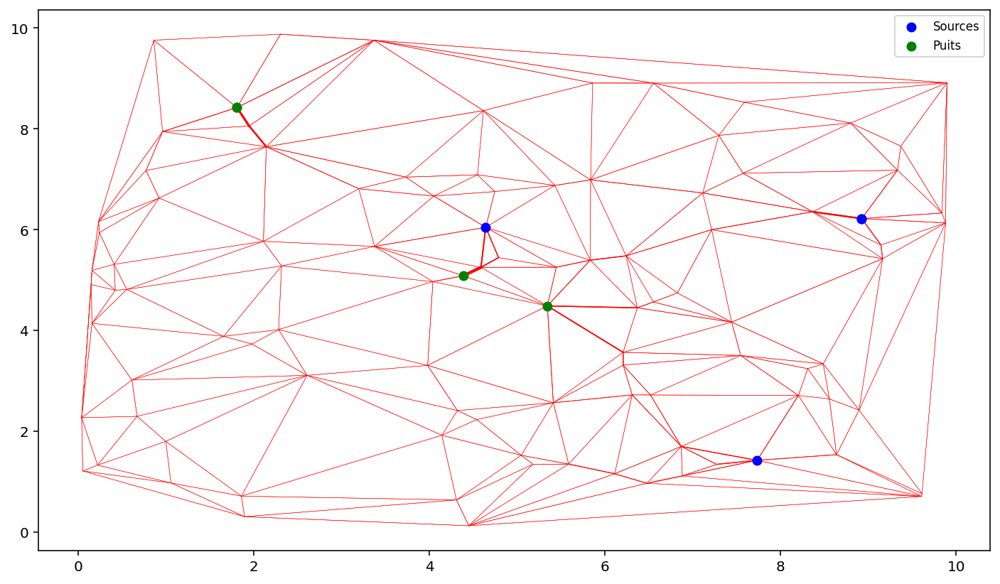

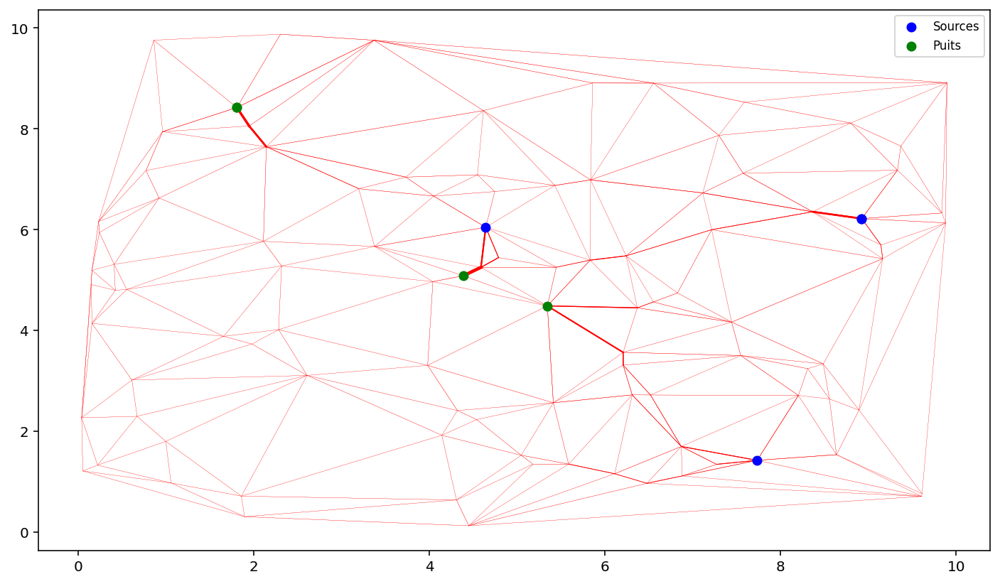

...

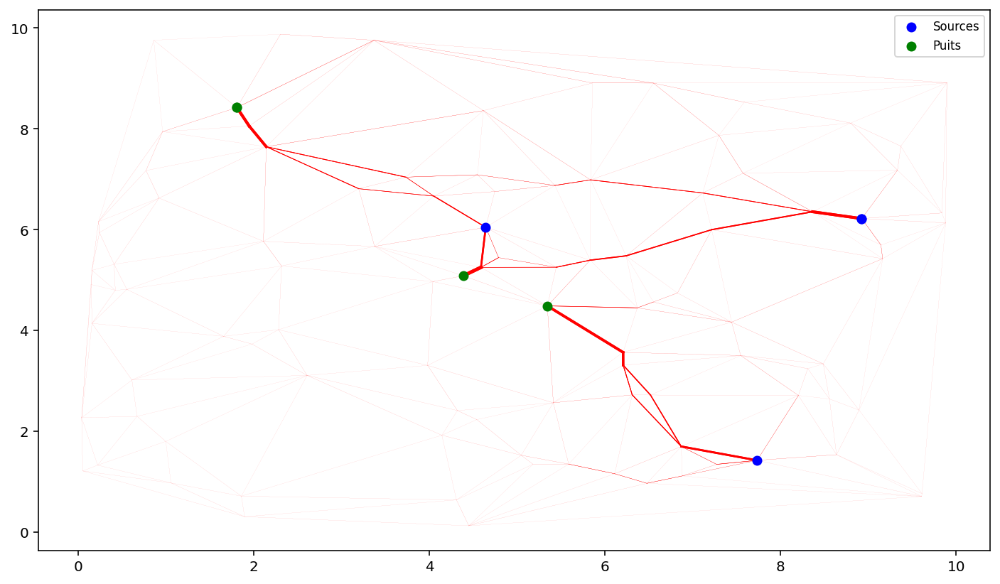

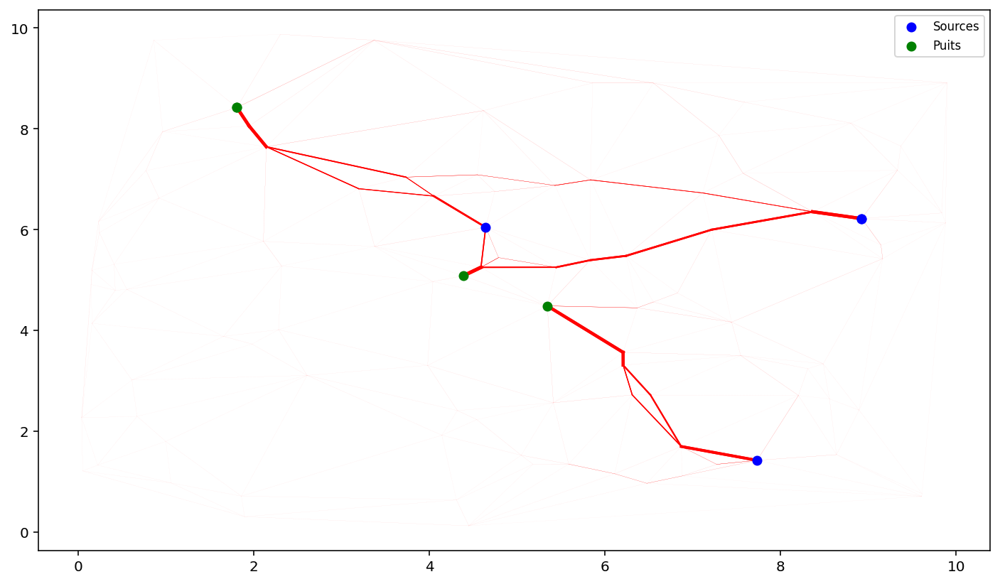

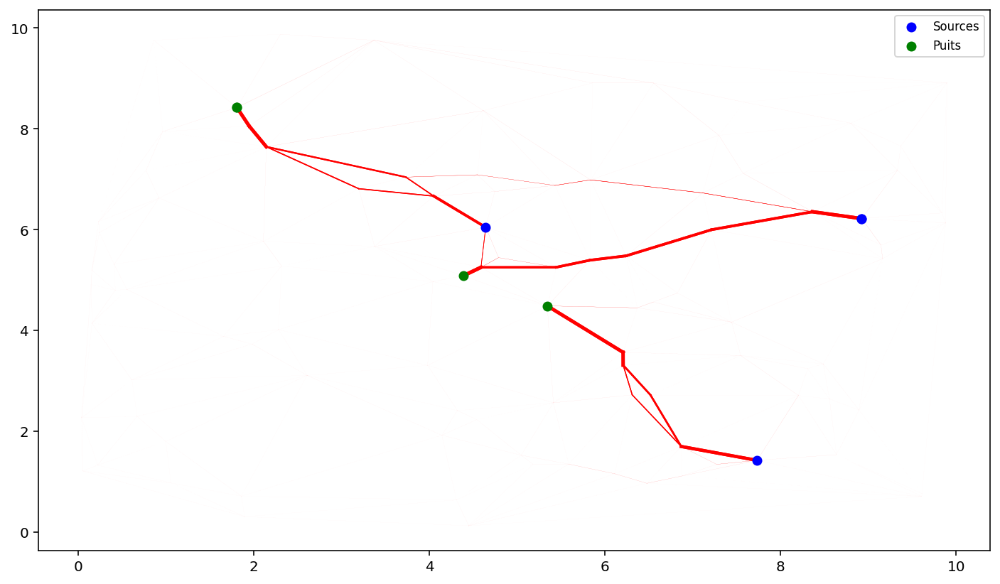

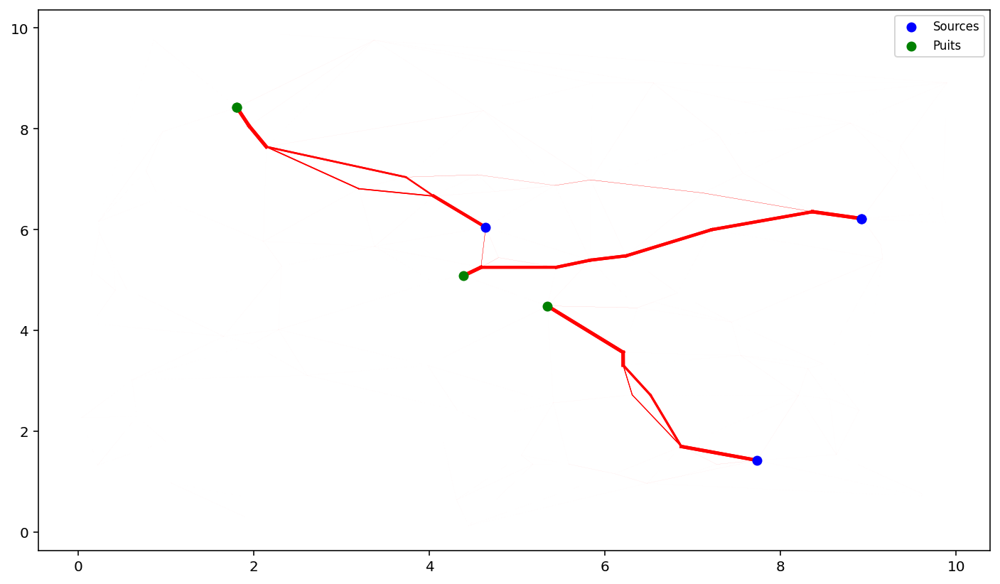

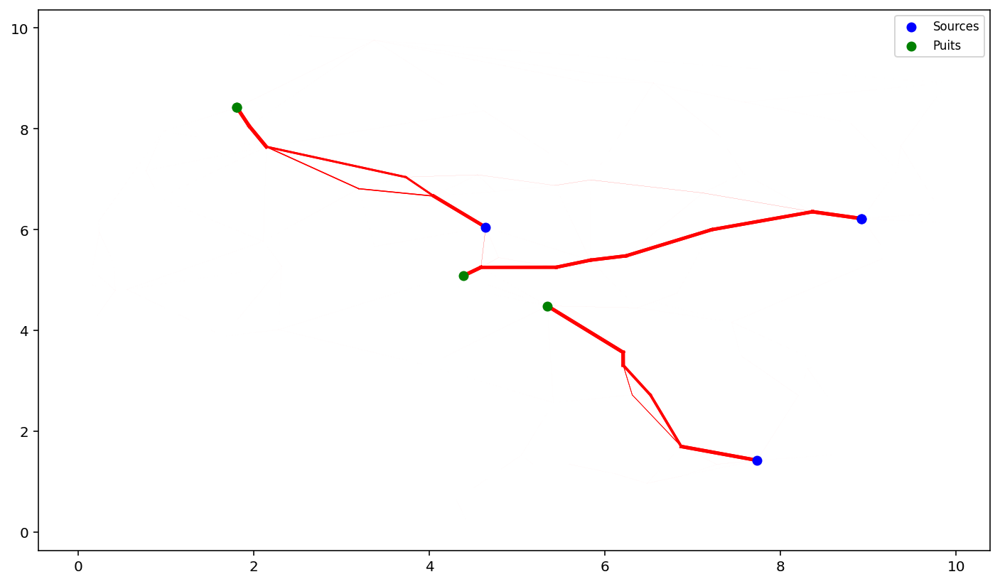

In [11]:
test_blob = blob(100,3,3,maille = "Delaunay")

for t in range(1001):
    test_blob.calcule_D(0.01,TAU = 1, GAMMA = 1.8)
    if t%100 == 0 :
        test_blob.plot()

Le temps de la figure ci-dessous est t = 0


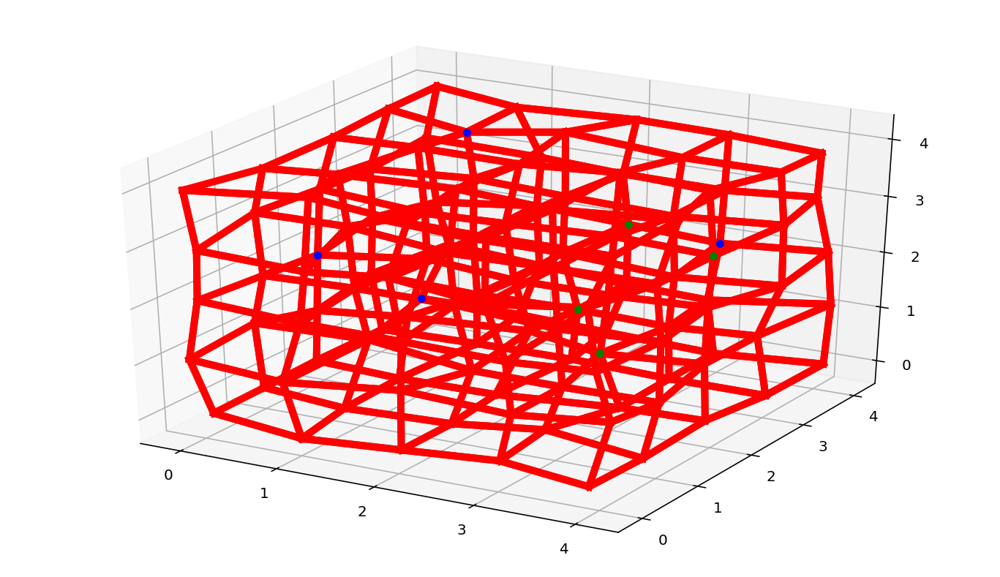

Le temps de la figure ci-dessous est t = 100


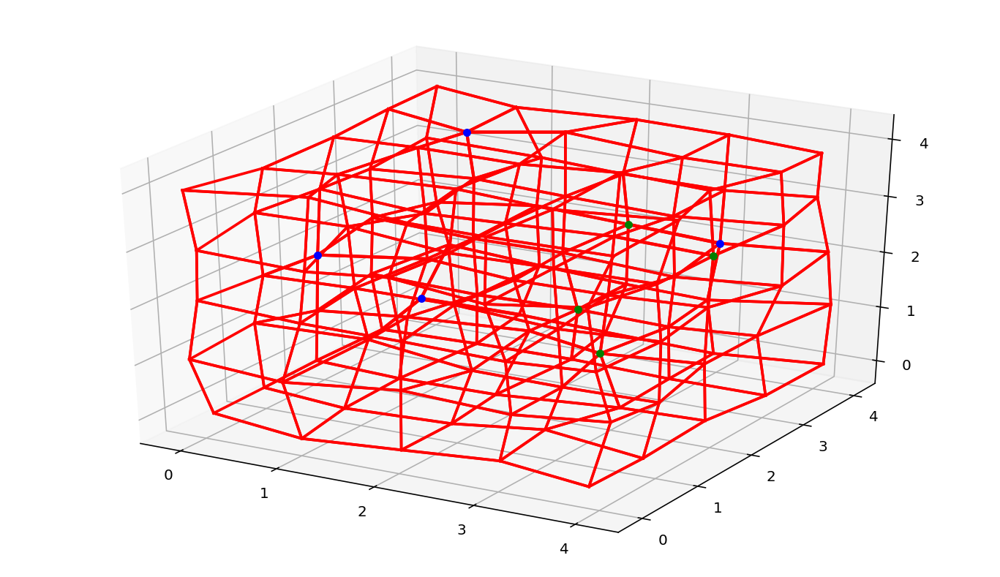

Le temps de la figure ci-dessous est t = 200


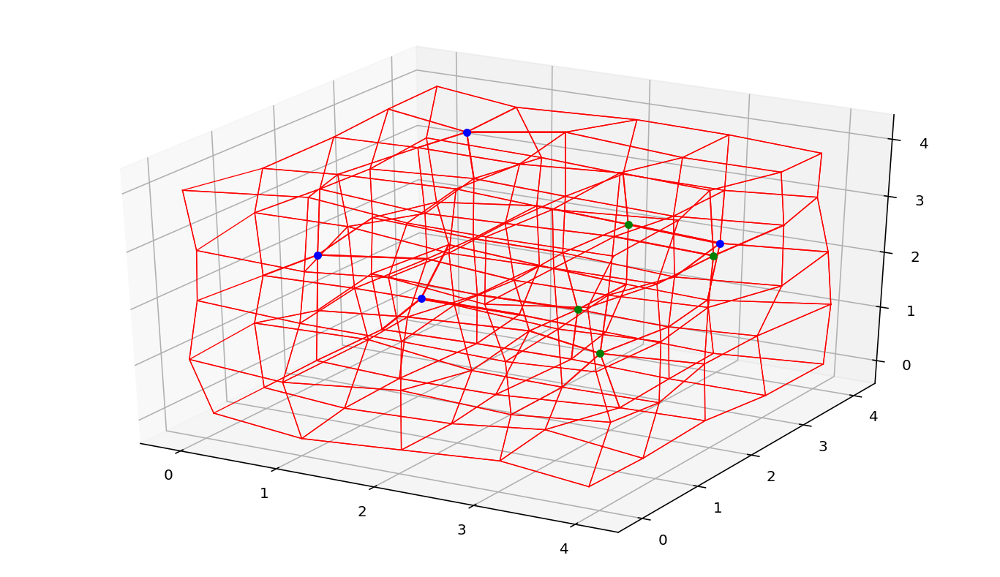

Le temps de la figure ci-dessous est t = 300


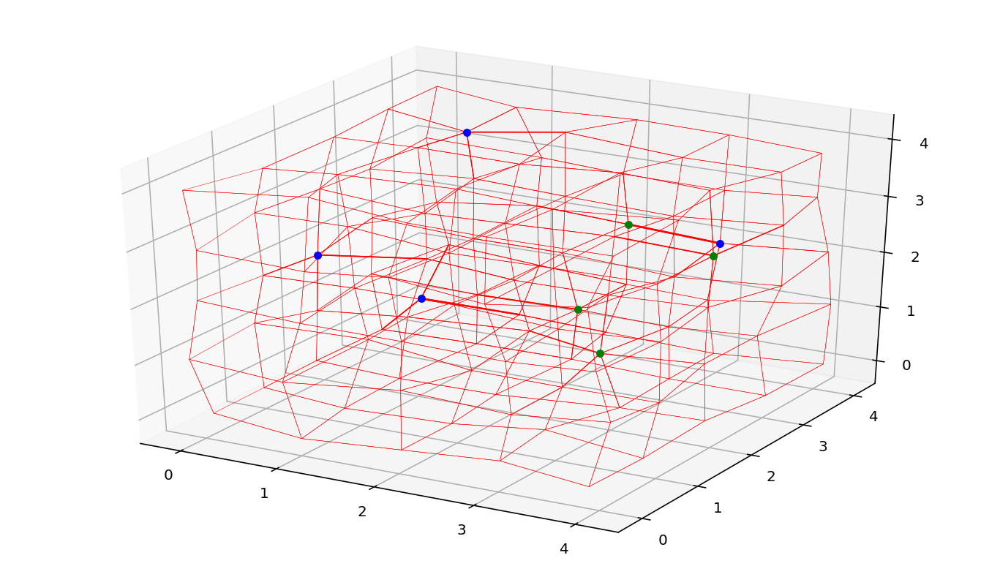

Le temps de la figure ci-dessous est t = 400


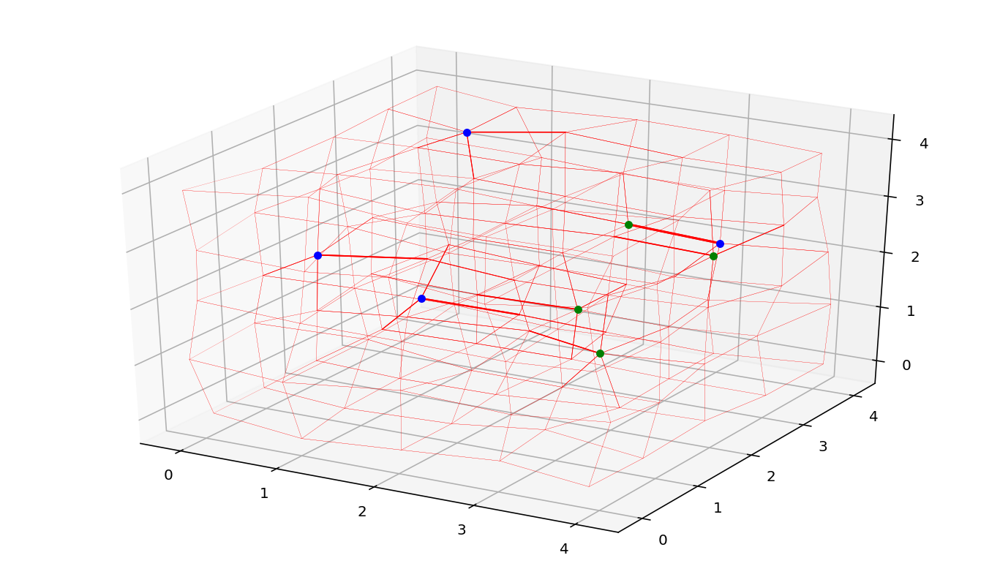

Le temps de la figure ci-dessous est t = 500


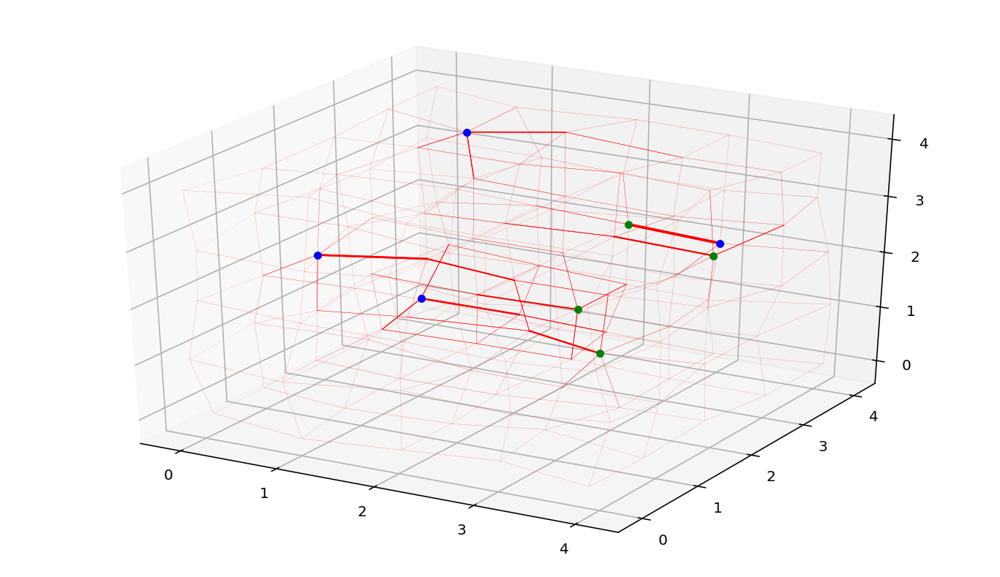

Le temps de la figure ci-dessous est t = 600


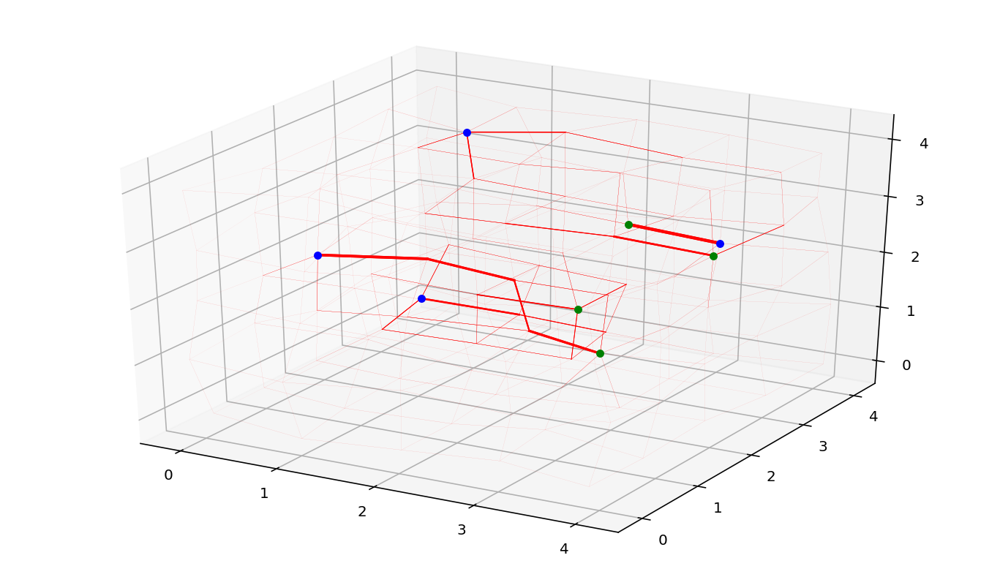

Le temps de la figure ci-dessous est t = 700


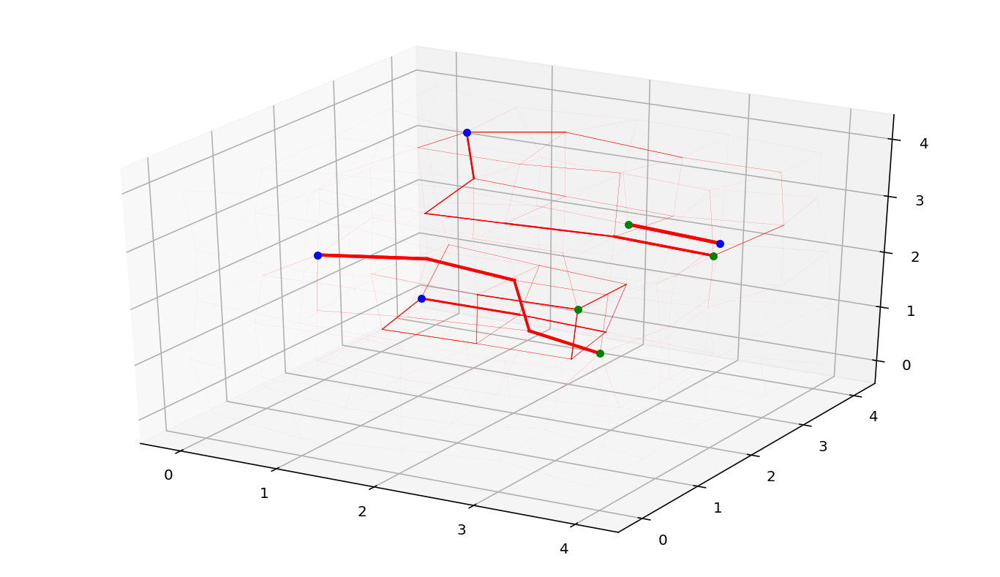

Le temps de la figure ci-dessous est t = 800


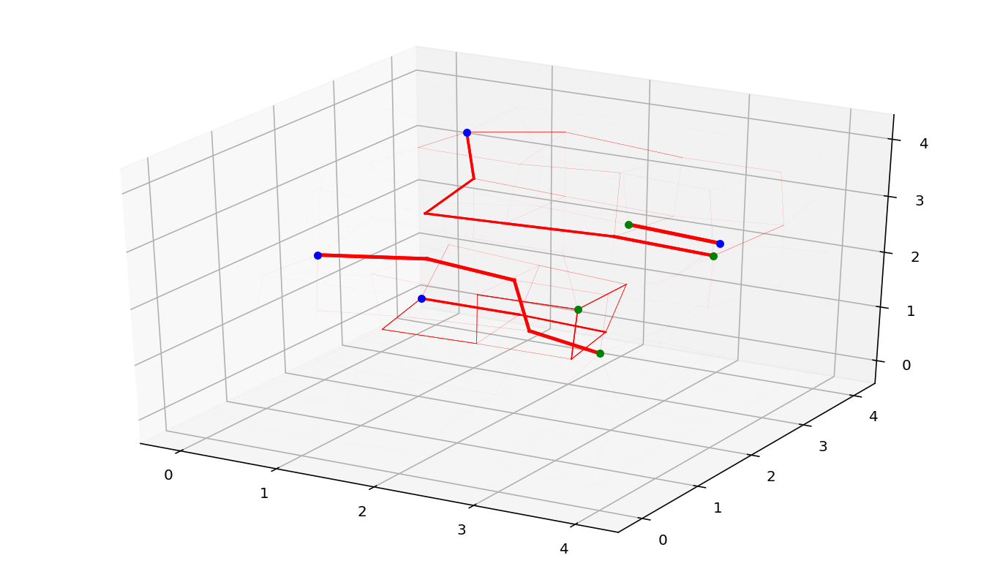

Le temps de la figure ci-dessous est t = 900


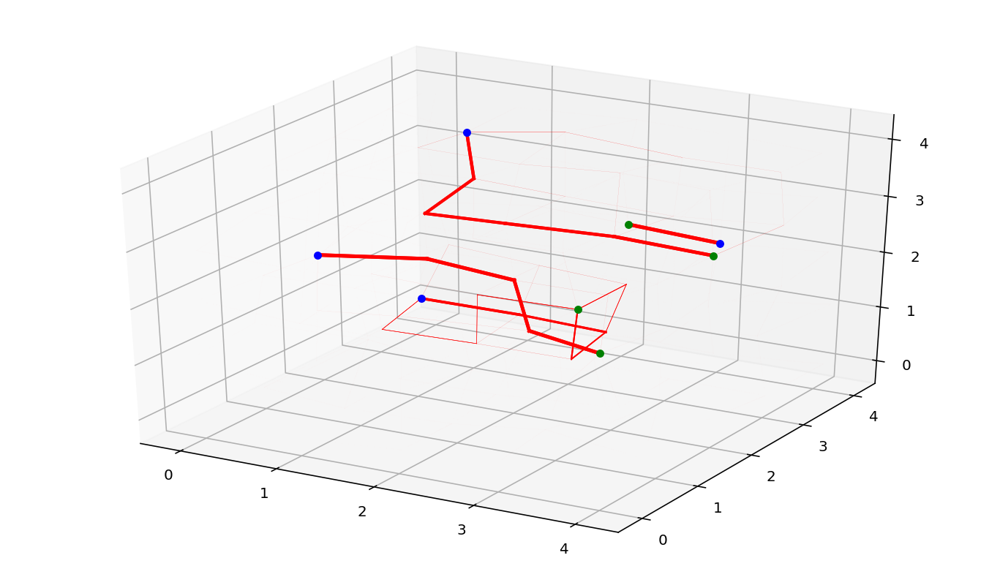

Le temps de la figure ci-dessous est t = 1000


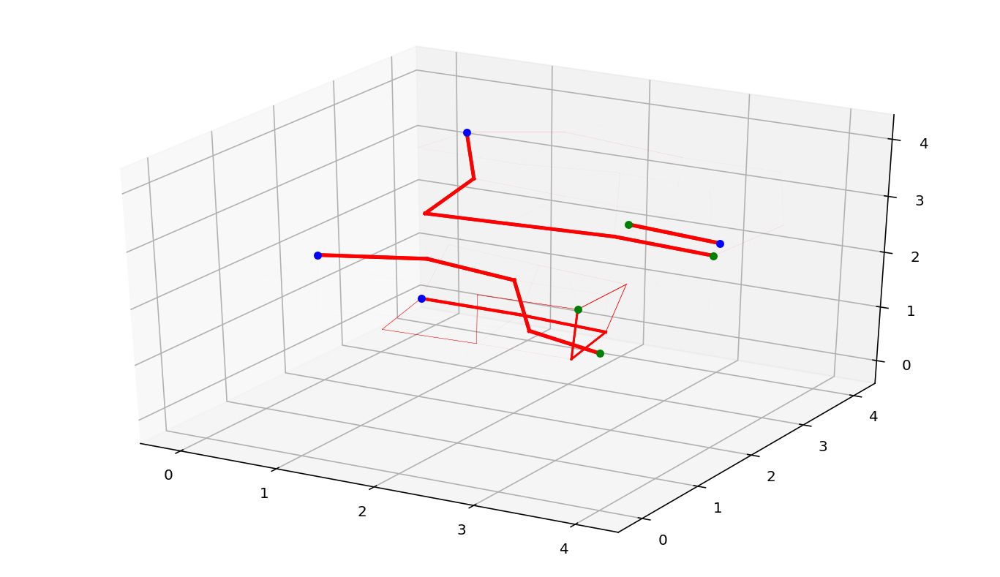

Le temps de la figure ci-dessous est t = 1100


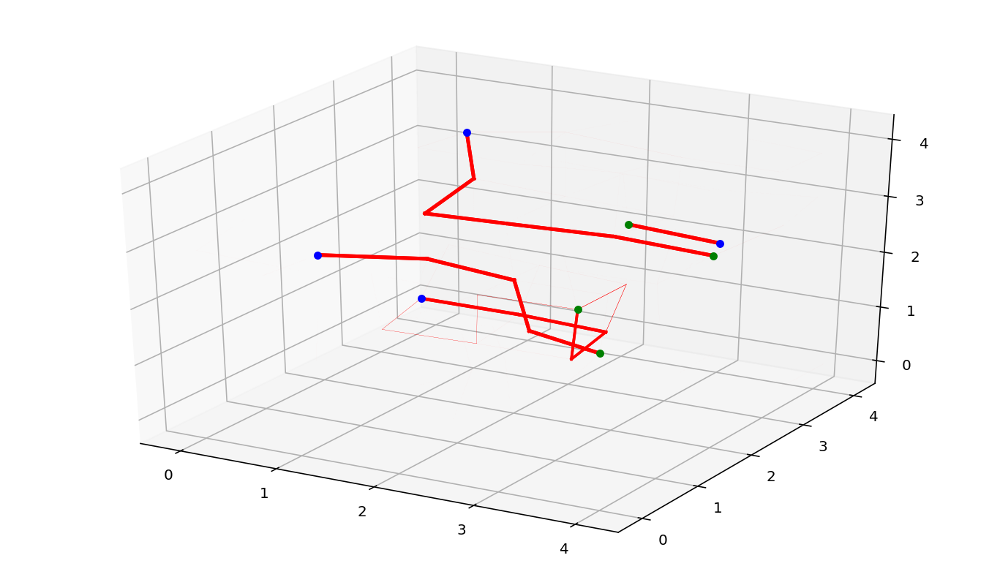

Le temps de la figure ci-dessous est t = 1200


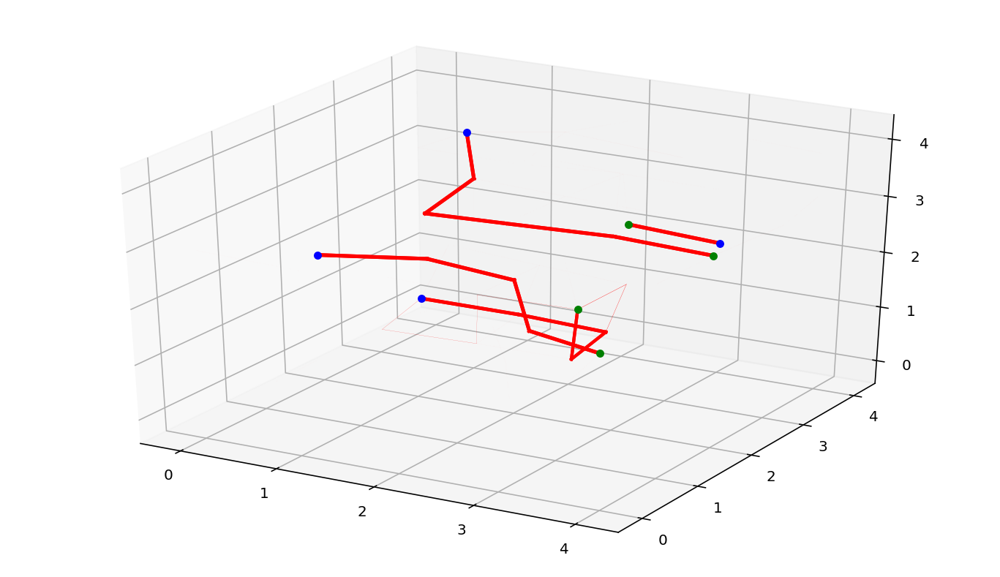

Le temps de la figure ci-dessous est t = 1300


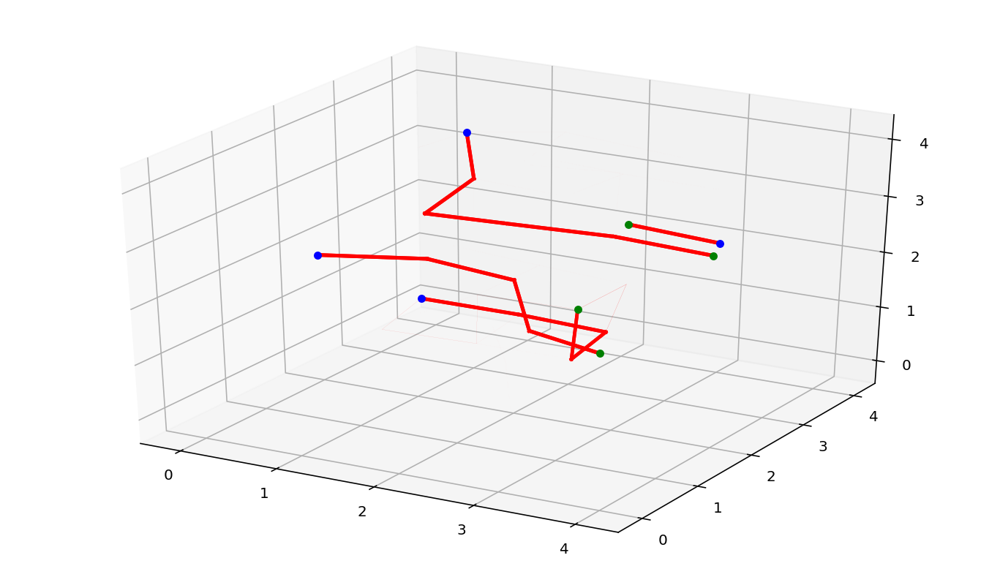

Le temps de la figure ci-dessous est t = 1400


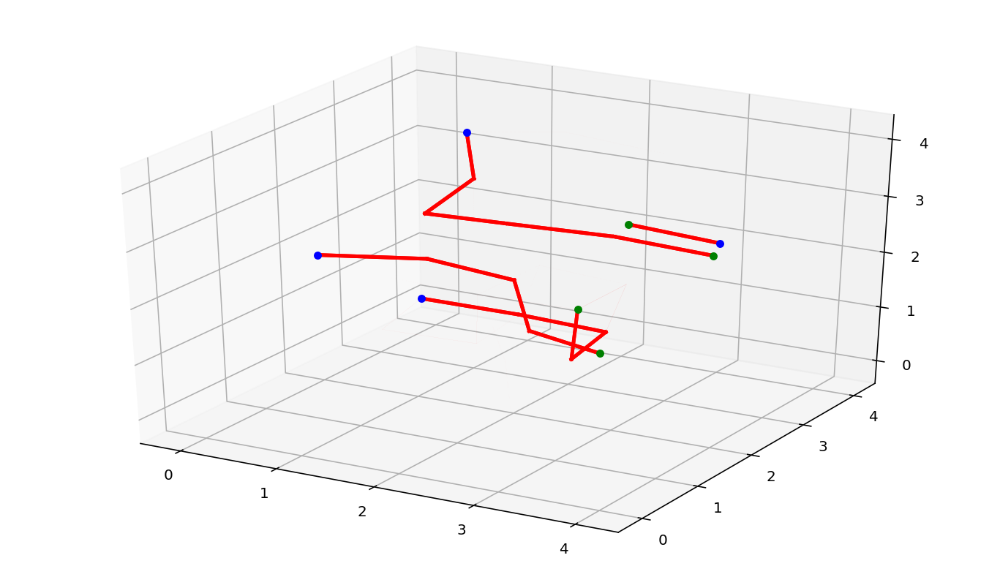

Le temps de la figure ci-dessous est t = 1500


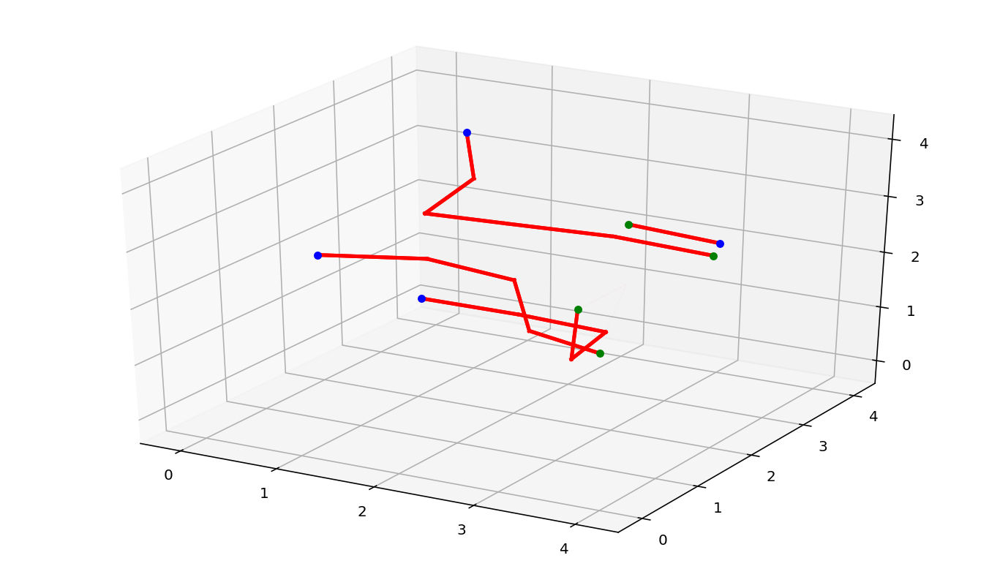

Le temps de la figure ci-dessous est t = 1600


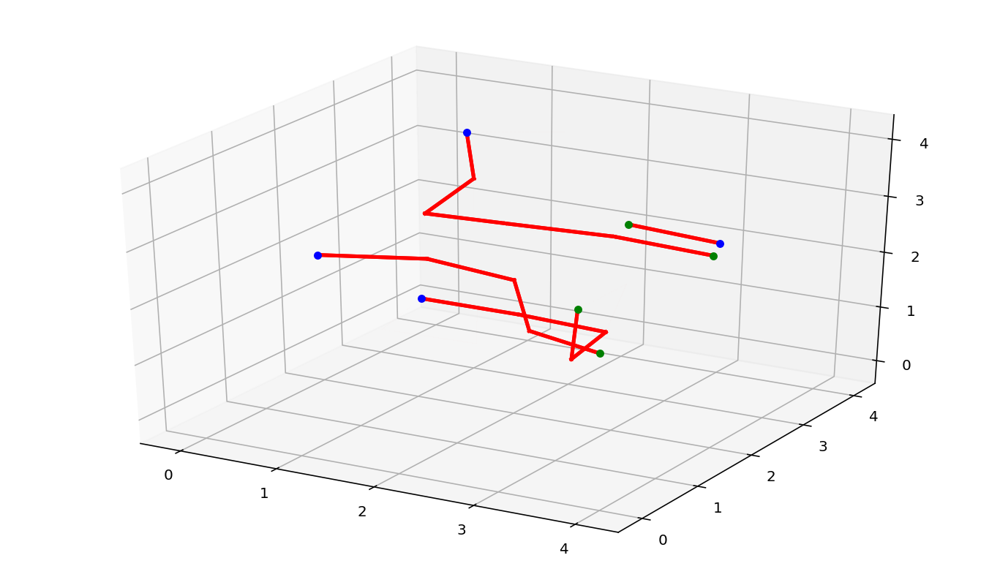

Le temps de la figure ci-dessous est t = 1700


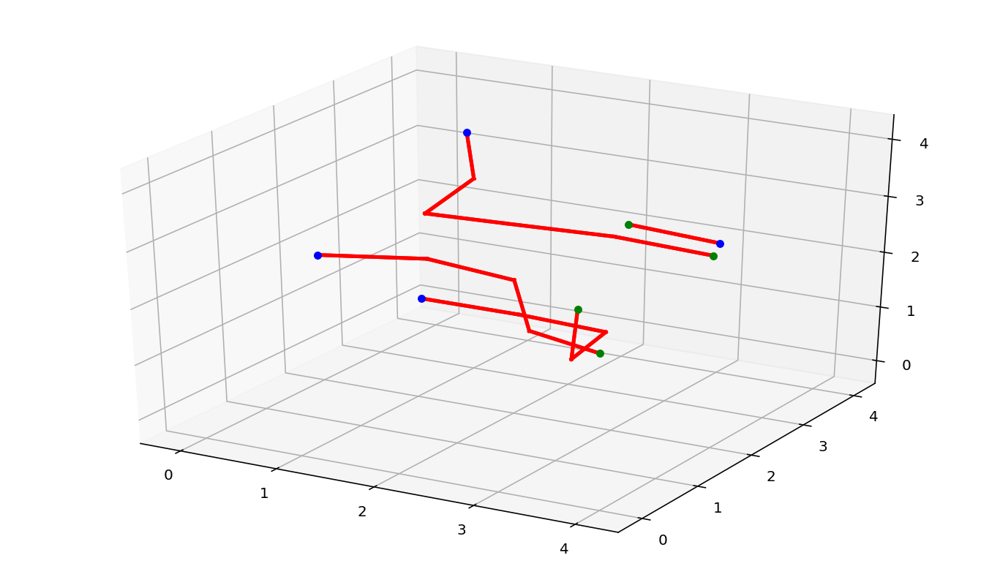

Le temps de la figure ci-dessous est t = 1800


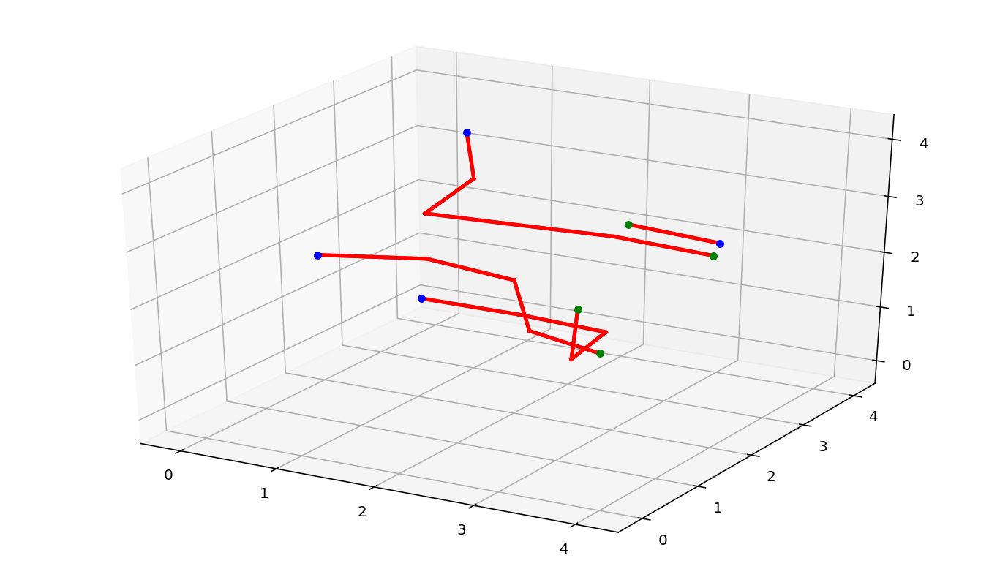

Le temps de la figure ci-dessous est t = 1900


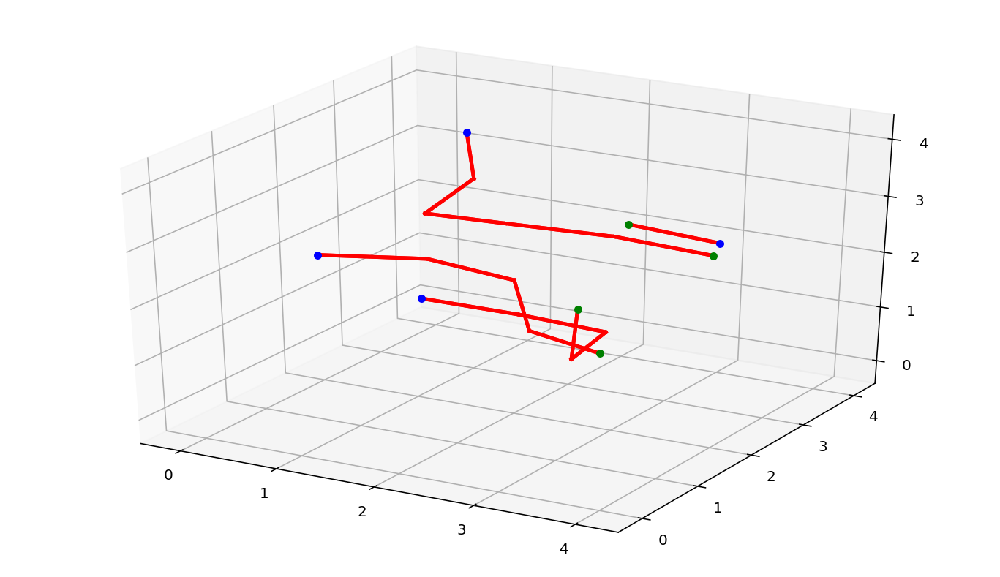

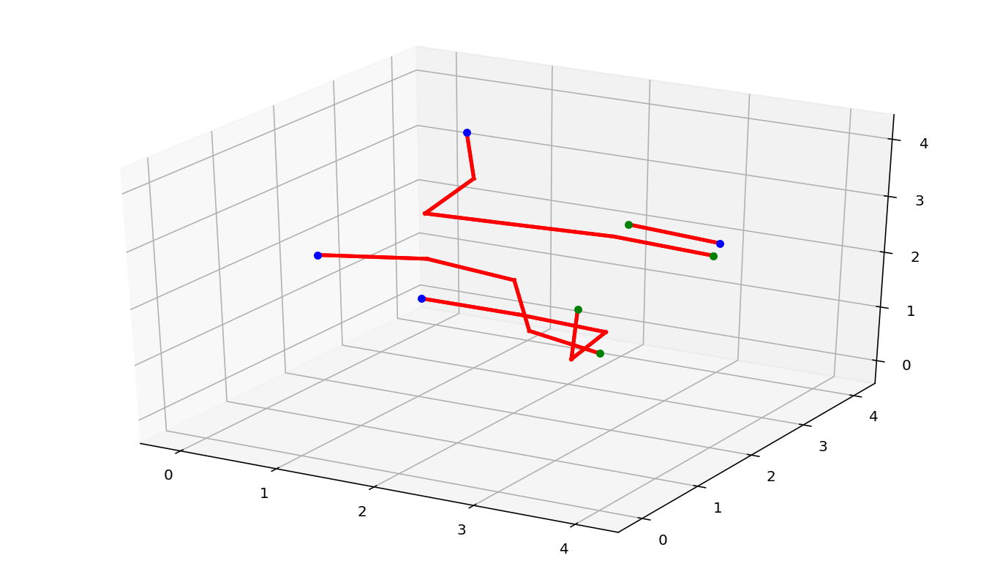

In [12]:
test_blob = blob(125,4,4,maille="3D")
for t in range(2000):
    test_blob.calcule_D(0.01,TAU=1)
    if t%100 == 0:
        print("Le temps de la figure ci-dessous est t =", t)
        test_blob.plot3D()
test_blob.plot3D()

In [0]:
#Interface graphique : Ne fonctionne pas si le notebook est executé sur un serveur, ce dernier n'ayant pas d'écran pour afficher ladite interface.

def update_nbs():
    if maille.get() == 0 or maille.get() == 1 :
        bouton4.config(value = [x**2 for x in range(2,1000)] )
    elif maille.get() == 3 :
        bouton4.config(value=[x ** 3 for x in range(2, 1000)])
    else:
        bouton4.config(value =[x for x in range(4,10000)])

def update_sources(once = True):
    global choice
    bouton5.config(to=min(Nb.get()-1,max(Nb.get()-Npuit.get(),1.1)))
    bouton5.config(to=Nb.get()-1)
    if choice :
        unchooseI()
        chooseI()
    if once :
        update_puits(False)

def update_puits(once=True):
    print(NSource.get())
    bouton6.config(to=min(Nb.get()-1,Nb.get()-NSource.get()))
    bouton6.config(to=Nb.get() - 1)
    if once :
        update_sources(False)

def last_puit():
    i = 0
    for j in Isources:
        print()
        i += j.get()
    for j in Ipuits:
        i -= j.get()
    dpuit.set(i)
    lpuit.config(textvariable=dpuit)


def etapes():
    global etape
    if inter.get():
        etape = tk.PanedWindow(mesfenetres,orient=tk.VERTICAL)
        etape.pack(side=tk.RIGHT, expand=tk.Y, fill=tk.BOTH, pady=2, padx=2)
        global toutles
        toutles = tk.IntVar()
        toutles.set(100)
        etape.add(tk.Label(etape,text="Rendu toutes les "),sticky="nw")
        etape.add(tk.Entry(etape,textvariable=toutles))
        etape.add(tk.Label(etape, text="iterations"),sticky="nw")
        etape.pack()
        mesfenetres.add(etape)
    else:
        etape.destroy()
        mesfenetres.pack(expand=1)

choice =False
def chooseI():
    global choice
    if choice :
        unchooseI()
    choice = True
    global choix
    choix = tk.PanedWindow(mesfenetres,orient=tk.VERTICAL)
    choix.pack(side=tk.RIGHT, expand=tk.Y, fill=tk.BOTH, pady=2, padx=2)
    global Isources
    global Ipuits
    Isources = [tk.IntVar() for i in range(NSource.get())]
    Ipuits = [tk.IntVar() for i in range(Npuit.get()-1)]
    for i in range(NSource.get()):
        choix.add(tk.Label(choix, text="Source "+str(i+1),) )
        choix.add(tk.Spinbox(choix,textvariable = Isources[i],from_=0, to=1000,command = last_puit))
    for i in range(Npuit.get()-1):
        choix.add(tk.Label(choix, text="Puit " + str(i + 1), ))
        choix.add(tk.Spinbox(choix, textvariable=Ipuits[i], from_=0, to=1000, command = last_puit))
    choix.add(tk.Label(choix, text="Puit " + str(Npuit.get()), ))
    global lpuit
    global dpuit
    dpuit = tk.DoubleVar()
    lpuit = tk.Spinbox(choix, textvariable=dpuit, from_=0, to=1000, increment=0.5,state='disabled')
    choix.add(lpuit)
    choix.pack()
    mesfenetres.add(choix,after=f3)

def unchooseI():
    global choice
    global choix
    if choice:
        choix.destroy()
        mesfenetres.pack(expand=1)
        choice = False

def lancer():
    global simulation
    simulation = True
    fenetre.destroy()

simulation = True

while simulation :

    simulation = False
    fenetre = tk.Tk()
    fenetre.title("Simulation : Le Blob")
    mesfenetres = tk.PanedWindow(fenetre, orient=tk.HORIZONTAL)
    f1 = tk.PanedWindow(mesfenetres, orient=tk.VERTICAL)
    value = tk.StringVar()
    f1.add(tk.Label(f1, text="Type de maillage :"), sticky="nw")
    maille = tk.IntVar()
    bouton1 = tk.Radiobutton(f1, text="Maille rectangulaire", variable=maille, value=0, command=update_nbs)
    bouton1.pack(side=tk.LEFT)
    f1.add(bouton1, sticky="nw")
    bouton2 = tk.Radiobutton(f1, text="Maille triangulaire", variable=maille, value=1, command=update_nbs,justify=tk.LEFT)
    f1.add(bouton2, sticky="nw")
    bouton3 = tk.Radiobutton(f1, text="Triangulation Delaunay", variable=maille, value=2, command=update_nbs,justify=tk.LEFT)
    f1.add(bouton3, sticky="nw")
    bouton10 = tk.Radiobutton(f1, text="Blob 3D", variable=maille, value=3, command=update_nbs, justify=tk.LEFT)
    f1.add(bouton10, sticky="nw")

    f1.pack()
    mesfenetres.add(f1)

    f2 = tk.PanedWindow(mesfenetres, orient=tk.VERTICAL)
    label2 = tk.Label(f2, text="Nombre de points :")
    f2.add(label2)
    Nb = tk.IntVar()
    bouton4 = tk.Spinbox(f2, textvariable=Nb, values=[x ** 2 for x in range(2, 1000)], command=update_sources)
    f2.add(bouton4)

    label3 = tk.Label(f2, text="Nombre de sources :")
    f2.add(label3)
    NSource = tk.IntVar()
    bouton5 = tk.Spinbox(f2, textvariable=NSource, from_=1, to=2, state='readonly', command=update_puits)
    f2.add(bouton5)

    label4 = tk.Label(f2, text="Nombre de puits :")
    Npuit = tk.IntVar()
    bouton6 = tk.Spinbox(f2, textvariable=Npuit, from_=1, to=2, state='readonly', command=update_sources)
    f2.add(label4)
    f2.add(bouton6, sticky="n")
    f2.pack()
    mesfenetres.add(f2)

    f3 = tk.PanedWindow(mesfenetres, orient=tk.VERTICAL)
    label5 = tk.Label(fenetre, text="Configuration des sources:")
    f3.add(label5)
    sourcemod = tk.IntVar()
    bouton7 = tk.Radiobutton(fenetre, text="Chaque source à -1", variable=sourcemod, value=0, command=unchooseI)
    f3.add(bouton7, sticky="nw")
    bouton8 = tk.Radiobutton(fenetre, text="Distribution aléatoire", variable=sourcemod, value=1, command=unchooseI)
    f3.add(bouton8, sticky="nw")
    bouton9 = tk.Radiobutton(fenetre, text="Au choix", variable=sourcemod, value=2, command=chooseI)
    f3.add(bouton9, sticky="nw")
    f3.pack()
    mesfenetres.add(f3)

    f4 = tk.PanedWindow(mesfenetres, orient=tk.VERTICAL)
    label6 = tk.Label(fenetre, text="Temps caractéristique : Tau ")
    f4.add(label6)
    TAU = tk.DoubleVar()
    TAU.set(1.0)
    entre1 = tk.Entry(fenetre, textvariable=TAU)
    f4.add(entre1, sticky="n")
    label7 = tk.Label(fenetre, text="Constante d'évolution : Gamma ")
    f4.add(label7)
    GAMMA = tk.DoubleVar()
    GAMMA.set(1.8)
    entre2 = tk.Entry(fenetre, textvariable=GAMMA)
    f4.add(entre2, sticky="n")

    label8 = tk.Label(fenetre, text="Pas de temps : dt ")
    f4.add(label8)
    dt = tk.DoubleVar()
    dt.set(0.03)
    entre3 = tk.Entry(fenetre, textvariable=dt)
    f4.add(entre3, sticky="n")
    f4.pack()
    mesfenetres.add(f4)

    f5 = tk.PanedWindow(mesfenetres, orient=tk.VERTICAL)
    label9 = tk.Label(fenetre, text="Nombre d'itérations ")
    f5.add(label9)
    n = tk.IntVar()
    n.set(500)
    entre4 = tk.Entry(fenetre, textvariable=n)
    f5.add(entre4)

    inter = tk.BooleanVar()
    CButton1 = tk.Checkbutton(fenetre, text="Figures intermediaires", variable=inter, command=etapes)
    f5.add(CButton1, sticky="nw")
    aleapuit = tk.BooleanVar()
    CButton2 = tk.Checkbutton(fenetre, text="Puits aleatoires", variable=aleapuit)
    f5.add(CButton2, sticky="nw")
    aleasource = tk.BooleanVar()
    CButton3 = tk.Checkbutton(fenetre, text="Sources aleatoires", variable=aleasource)
    f5.add(CButton3, sticky="nw")
    f5.pack()
    mesfenetres.add(f5)

    bouton = tk.Button(fenetre, text="Lancer la simulation", command=lancer)
    bouton.pack(side=tk.BOTTOM, padx=5, pady=5)
    mesfenetres.pack(expand=1, fill=tk.NONE)

    fenetre.mainloop()

    if simulation:
        tau = TAU.get()
        gamma = GAMMA.get()
        state3D = False
        if maille.get() == 0:
            MAILLE = "square"
        if maille.get() == 1:
            MAILLE = "hex"
        if maille.get() == 2:
            MAILLE = "Delaunay"
        if maille.get() == 3:
            MAILLE = "3D"
            state3D = True

        if sourcemod.get() == 0:
            SOURCEMOD = "1"
        if sourcemod.get() == 1:
            SOURCEMOD = "random"
        if sourcemod.get() == 2:
            SOURCEMOD = "choiceGraphique"

        mon_blob = blob(Nb.get(), Npuit.get(), NSource.get(), sourcemod=SOURCEMOD, maille=MAILLE)

        k = n.get() - 1
        if inter.get() == 1:
            k = toutles.get()
        N = n.get()
        PUITS = False

        for t in range(N):
            mon_blob.calcule_D(dt.get(), tau, gamma, puits=aleapuit.get(), sources=aleasource.get())
            if t % (k) == 0:
                if state3D:
                    mon_blob.plot3D()
                else:
                    mon_blob.plot()
        if state3D:
            mon_blob.plot3D()
        else:
            mon_blob.plot()
        plt.show(block=True)